In [1]:
import os
import cv2
import json
import pandas as pd
import numpy as np

import torch
import torchvision
import torch.nn as nn
import torch.nn.functional as F
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms, utils
from torchvision import models
import torch.optim as optim

from skimage import io, transform
from pose_dataset import PoseDataset, print_sample

from tqdm.notebook import tqdm

In [2]:
source_path = './data'
RAW = '/MPII_sample1'
PARSING = '/MPII_sample1_parsing'
POSE = '/MPII_sample1_pose'

In [3]:
with open(source_path+'/image2annotation.json', 'r') as f:
    image2annotation = json.load(f)

In [12]:
img2path = {'raw':[], 'parsing':[], 'pose':[], 'annotate':[]}
for f in os.listdir(source_path + RAW):
    img_id = f.split('.')[0]
    raw_path = './data'+RAW+'/'+f
    parsing_path = './data'+PARSING+'/'+img_id+'_vis.png'
    pose_path = './data'+POSE+'/'+img_id+'_rendered.png'

    img2path['raw'].append(raw_path)
    img2path['parsing'].append(parsing_path)
    img2path['pose'].append(pose_path)
    img2path['annotate'].append(image2annotation[f])

path_list = pd.DataFrame.from_dict(img2path)
path_list.to_csv(source_path+'/original_data_list.csv', index = False)

In [13]:
csv_file = './data/original_data_list.csv'
pose_dataset = PoseDataset(csv_file, './data')

0
tensor([  1,   2,   3,   4,   5,   6, 740,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


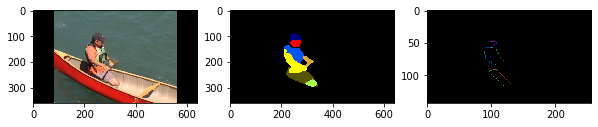

valid or not (y/n)y
1
tensor([8, 9, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0])


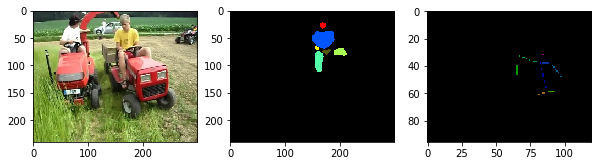

valid or not (y/n)n
2
tensor([10,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0])


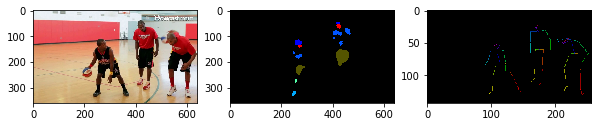

valid or not (y/n)n
3
tensor([11, 12,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0])


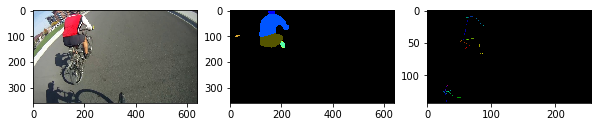

valid or not (y/n)y
4
tensor([10,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0])


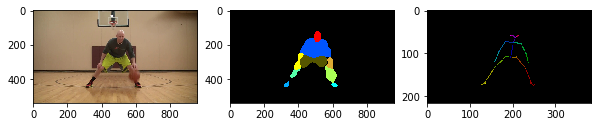

valid or not (y/n)y
5
tensor([ 13,  14, 740,  15,  16,  17,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


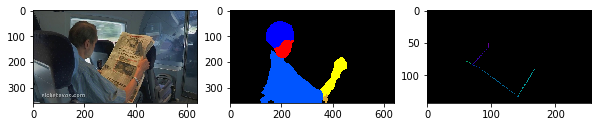

valid or not (y/n)y
6
tensor([18, 19, 16, 20,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0])


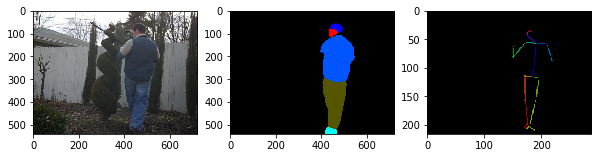

valid or not (y/n)y
7
tensor([ 21,  22,  21,  14, 740,  23,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


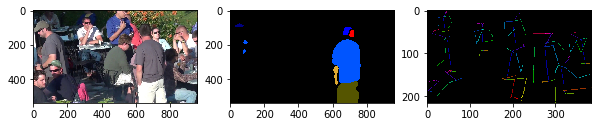

valid or not (y/n)n
8
tensor([ 24,  25,  26, 740,  27,  12,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


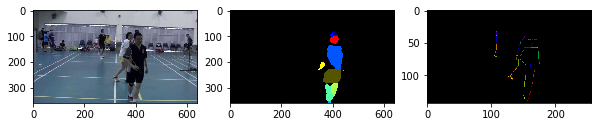

valid or not (y/n)n
9
tensor([28,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0])


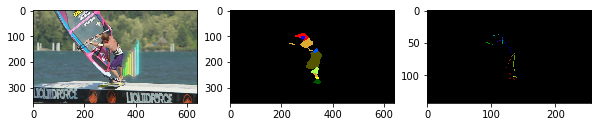

valid or not (y/n)y
10
tensor([ 29,  30,  31,  32,  31, 740,  33,  34,  12,   0,   0,   0,   0,   0,
          0,   0,   0])


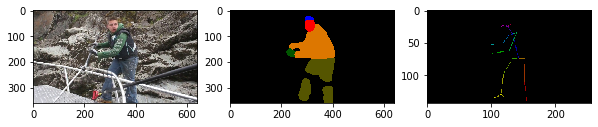

valid or not (y/n)y
11
tensor([ 13,  14, 740,  15,  16,  17,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


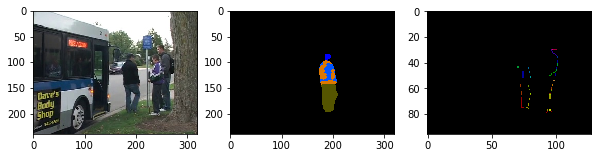

valid or not (y/n)n
12
tensor([35, 16, 36, 37,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0])


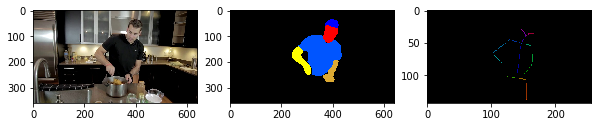

valid or not (y/n)y
13
tensor([38, 12, 39, 40,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0])


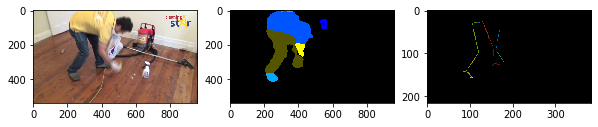

valid or not (y/n)y
14
tensor([41, 42,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0])


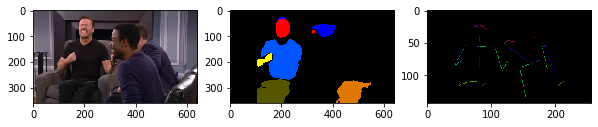

valid or not (y/n)n
15
tensor([740,  43,  13,  14, 740,  44,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


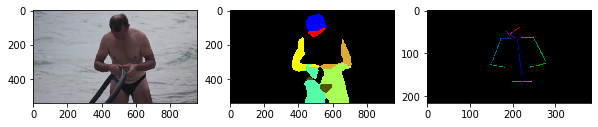

valid or not (y/n)y
16
tensor([45, 42,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0])


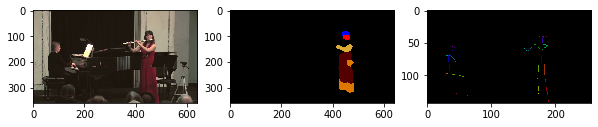

valid or not (y/n)y
17
tensor([45, 42,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0])


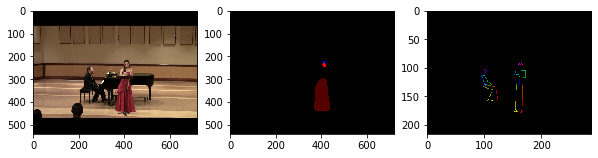

valid or not (y/n)n
18
tensor([46, 47,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0])


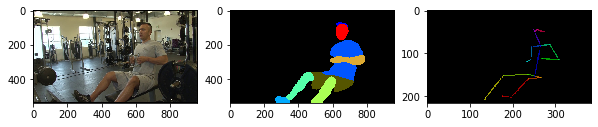

valid or not (y/n)y
19
tensor([48,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0])


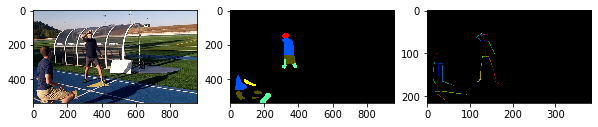

valid or not (y/n)n
20
tensor([ 24,  49,   5,   6, 740,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


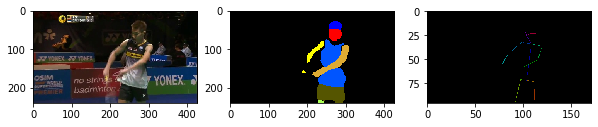

valid or not (y/n)y
21
tensor([ 11,  50, 740,  51,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


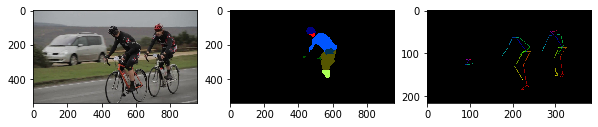

valid or not (y/n)y
22
tensor([52, 53,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0])


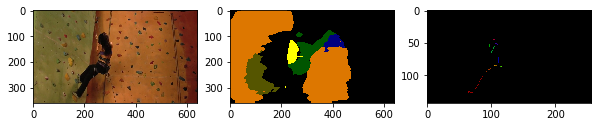

valid or not (y/n)n
23
tensor([740,  54,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


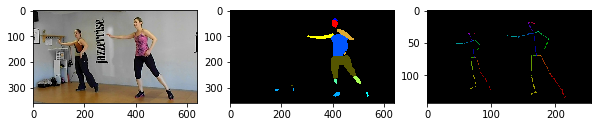

valid or not (y/n)y
24
tensor([55, 12,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0])


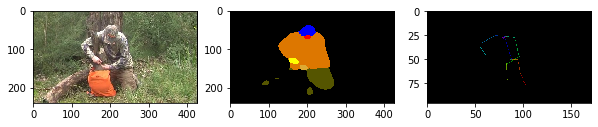

valid or not (y/n)y
25
tensor([21, 56, 14, 57,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0])


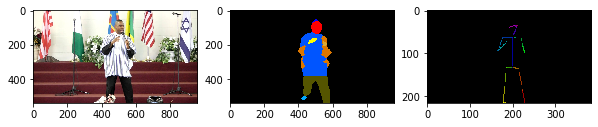

valid or not (y/n)y
26
tensor([58, 59, 60, 61, 62, 63,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0])


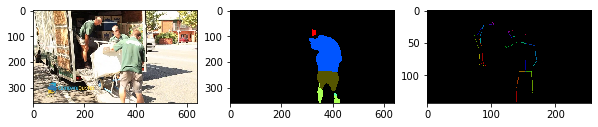

valid or not (y/n)n
27
tensor([64, 65,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0])


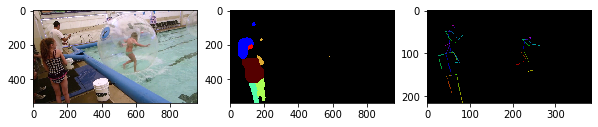

valid or not (y/n)n
28
tensor([66, 67, 21, 65, 68, 69, 70, 66, 71,  0,  0,  0,  0,  0,  0,  0,  0])


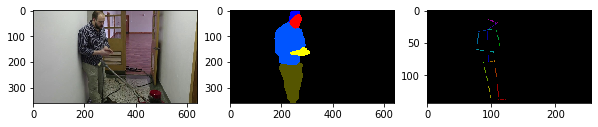

valid or not (y/n)y
29
tensor([72,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0])


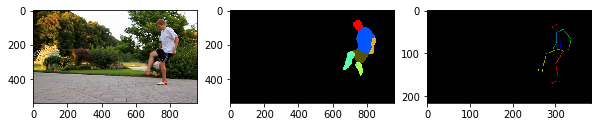

valid or not (y/n)y
30
tensor([73, 74, 12,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0])


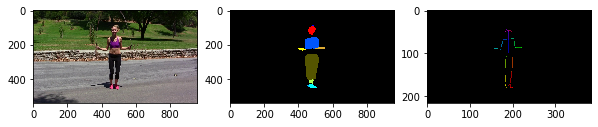

valid or not (y/n)y
31
tensor([ 75, 740,  76,  77,  78, 740,  79,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


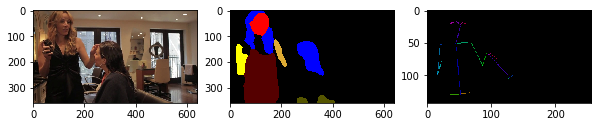

valid or not (y/n)n
32
tensor([ 80,  81,  82,  83,  84, 740,  85,  86, 740,  87,  39,   0,   0,   0,
          0,   0,   0])


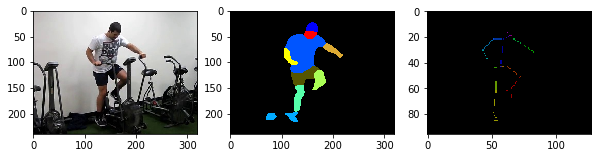

valid or not (y/n)y
33
tensor([88, 89, 90, 91, 12,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0])


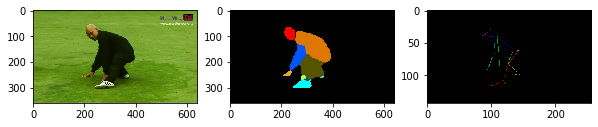

valid or not (y/n)y
34
tensor([92, 93, 94,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0])


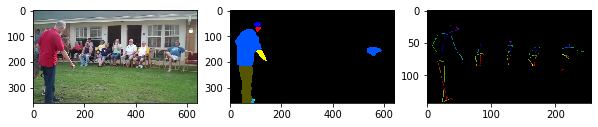

valid or not (y/n)n
35
tensor([95, 47,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0])


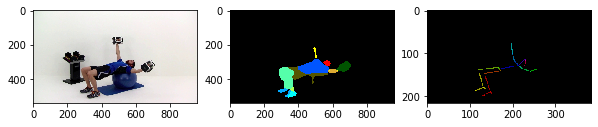

valid or not (y/n)y
36
tensor([96, 42,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0])


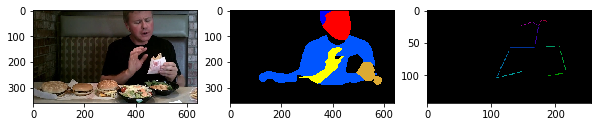

valid or not (y/n)y
37
tensor([97, 98, 42,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0])


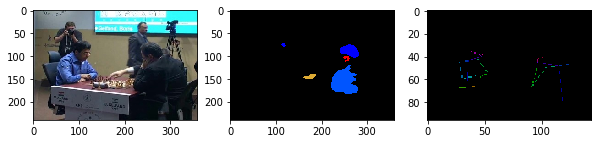

valid or not (y/n)n
38
tensor([99,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0])


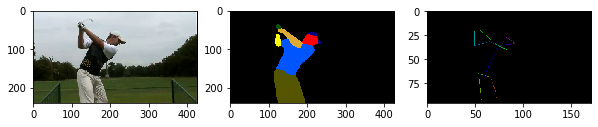

valid or not (y/n)y
39
tensor([100, 740, 101, 102,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


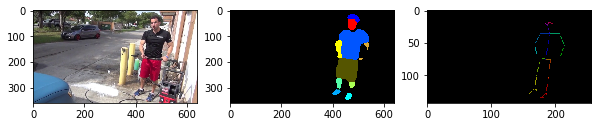

valid or not (y/n)y
40
tensor([103,  12, 104,   5,   6, 740,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


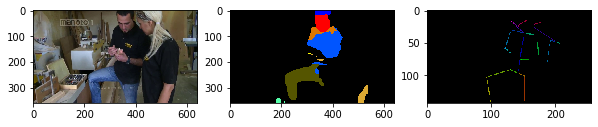

valid or not (y/n)n
41
tensor([105,  50,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


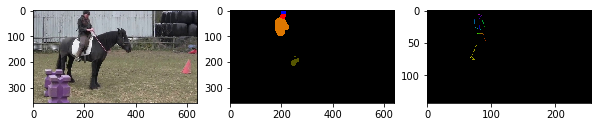

valid or not (y/n)y
42
tensor([ 11, 106,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


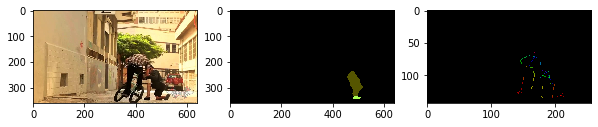

valid or not (y/n)n
43
tensor([107, 108,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


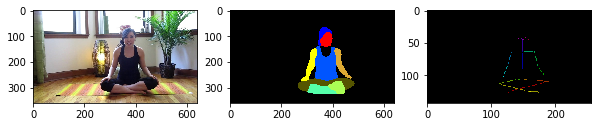

valid or not (y/n)y
44
tensor([109,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


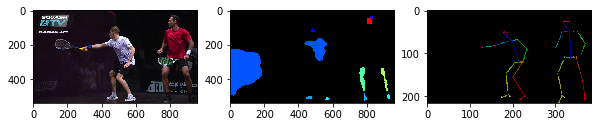

valid or not (y/n)n
45
tensor([110,  12,  39,  40,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


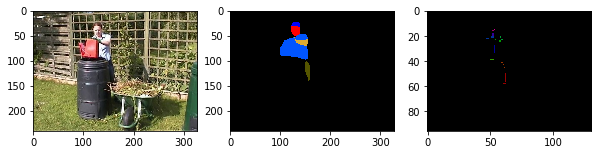

valid or not (y/n)n
46
tensor([103,  12,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


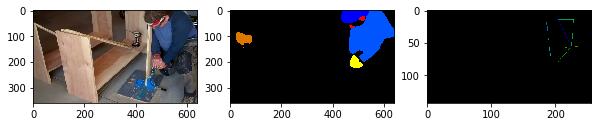

valid or not (y/n)n
47
tensor([ 11,  50, 740,  51,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


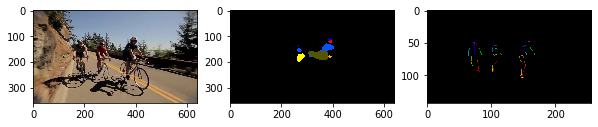

valid or not (y/n)n
48
tensor([111,  53,  69,  16,  53, 112, 113,   5,   6, 740,   0,   0,   0,   0,
          0,   0,   0])


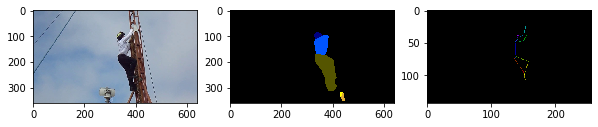

valid or not (y/n)y
49
tensor([114,  16, 115, 116, 740, 117, 118, 119, 120, 121, 122, 740, 123, 124,
        125,   0,   0])


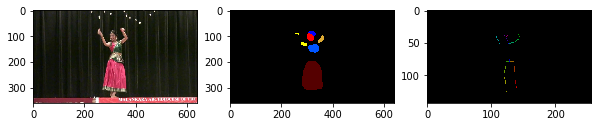

valid or not (y/n)y
50
tensor([ 10,  98,   5,   6, 740,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


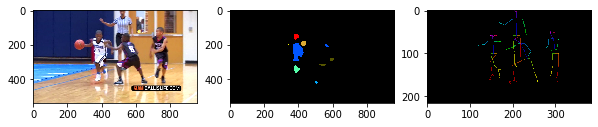

valid or not (y/n)n
51
tensor([126,  13,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


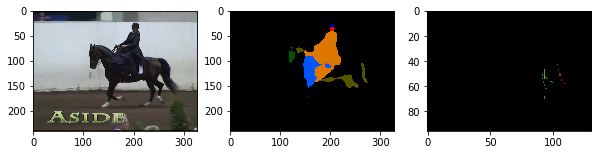

valid or not (y/n)n
52
tensor([  1, 127, 128,  49,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


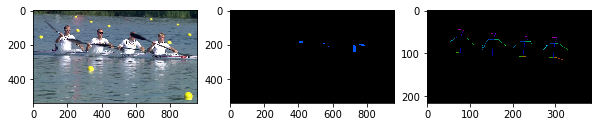

valid or not (y/n)n
53
tensor([129, 130, 131,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


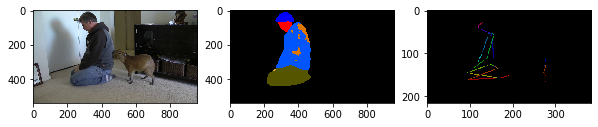

valid or not (y/n)y
54
tensor([126,  13,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


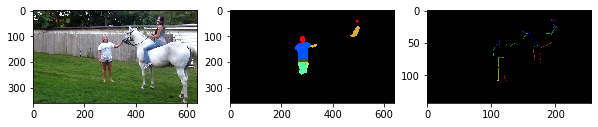

valid or not (y/n)n
55
tensor([  1,   2,   3,   4,   5,   6, 740,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


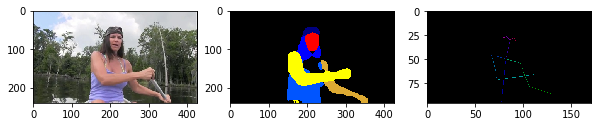

valid or not (y/n)y
56
tensor([ 21,  22,  21,  14, 740,  23,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


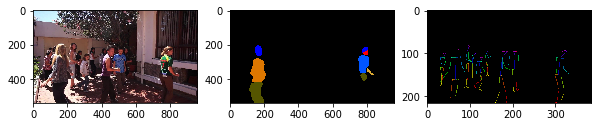

valid or not (y/n)n
57
tensor([132,  12,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


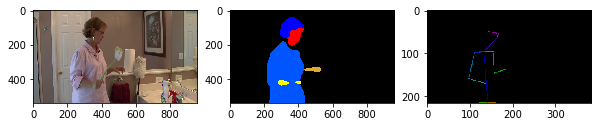

valid or not (y/n)y
58
tensor([133,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


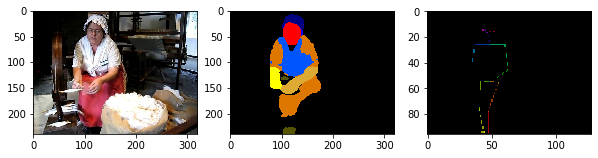

valid or not (y/n)y
59
tensor([134, 135,  12,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


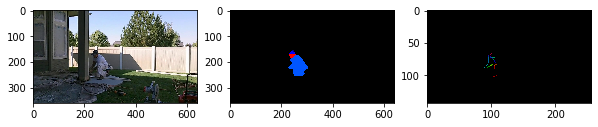

valid or not (y/n)y
60
tensor([136,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


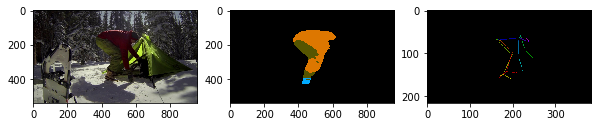

valid or not (y/n)y
61
tensor([137,  42,  16, 138,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


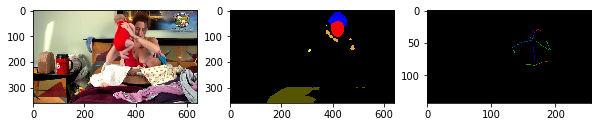

valid or not (y/n)n
62
tensor([97, 98, 42,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0])


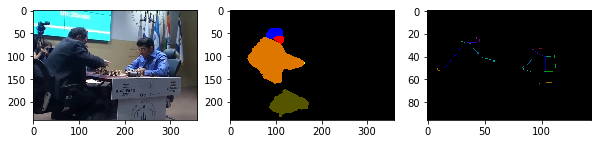

valid or not (y/n)n
63
tensor([139, 140,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


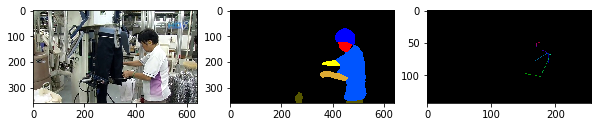

valid or not (y/n)n
64
tensor([ 29,  14, 141,  14, 142,   5,   6, 740,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


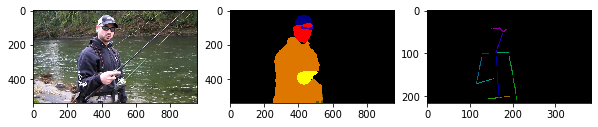

valid or not (y/n)y
65
tensor([64, 65,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0])


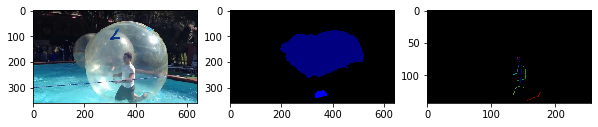

valid or not (y/n)n
66
tensor([95, 47,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0])


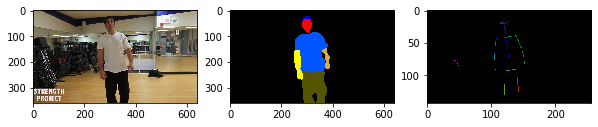

valid or not (y/n)y
67
tensor([66, 67, 21, 65, 68, 69, 70, 66, 71,  0,  0,  0,  0,  0,  0,  0,  0])


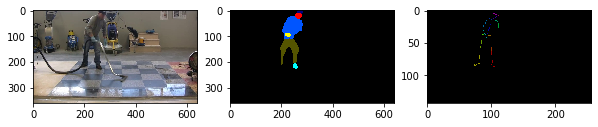

valid or not (y/n)y
68
tensor([143, 144,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


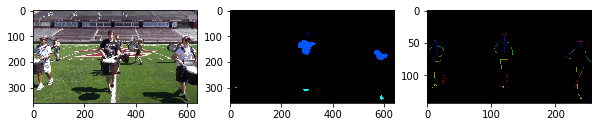

valid or not (y/n)n
69
tensor([ 11,  50, 740,  51,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


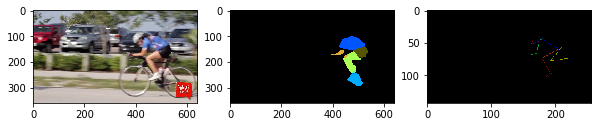

valid or not (y/n)y
70
tensor([145, 146,  21,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


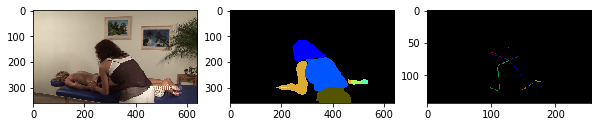

valid or not (y/n)y
71
tensor([128,  83,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


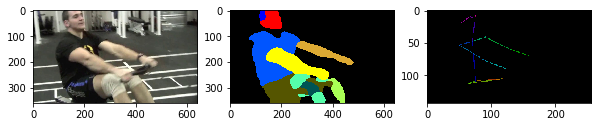

valid or not (y/n)y
72
tensor([147, 148, 149, 150, 151, 132, 152, 153, 154,   0,   0,   0,   0,   0,
          0,   0,   0])


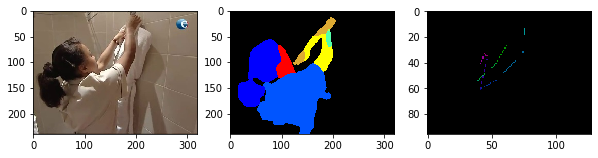

valid or not (y/n)y
73
tensor([ 29, 155, 156, 157,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


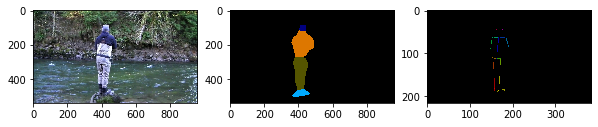

valid or not (y/n)y
74
tensor([158,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


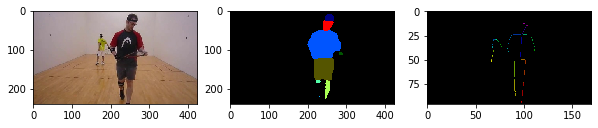

valid or not (y/n)y
75
tensor([95, 47,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0])


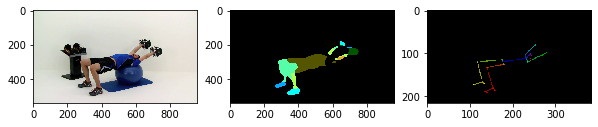

valid or not (y/n)y
76
tensor([136,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


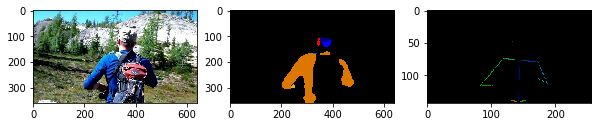

valid or not (y/n)
77
tensor([10,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0])


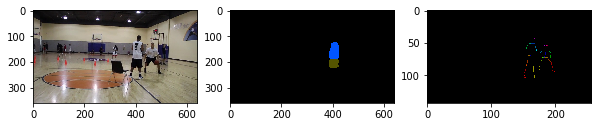

valid or not (y/n)n
78
tensor([159, 160, 161,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


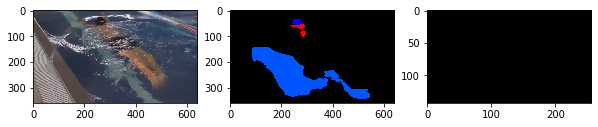

valid or not (y/n)n
79
tensor([132, 162,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


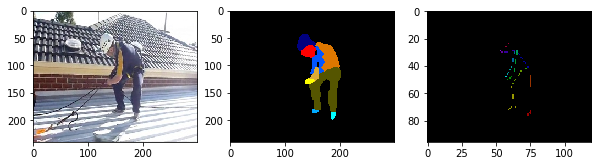

valid or not (y/n)y
80
tensor([110,  69, 163, 164, 165, 740, 166,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


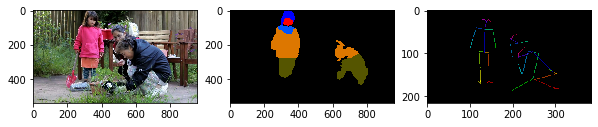

valid or not (y/n)
81
tensor([167, 168, 169, 170, 171,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


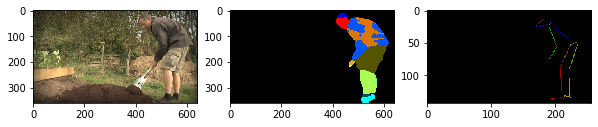

valid or not (y/n)y
82
tensor([172, 740,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


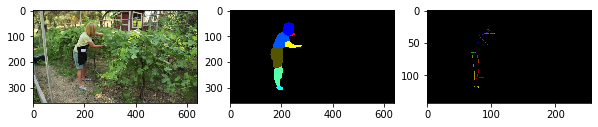

valid or not (y/n)y
83
tensor([173, 135,  12,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


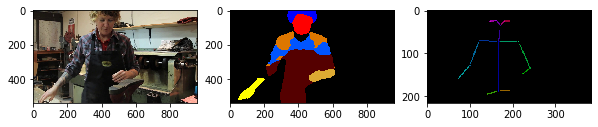

valid or not (y/n)y
84
tensor([143, 144,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


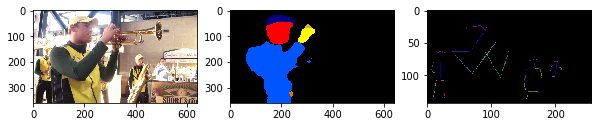

valid or not (y/n)n
85
tensor([136,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


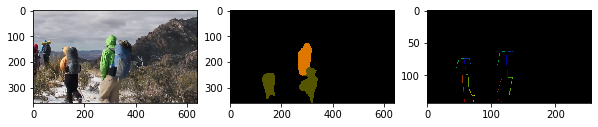

valid or not (y/n)n
86
tensor([55, 12,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0])


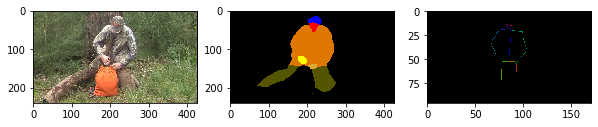

valid or not (y/n)y
87
tensor([ 65, 174, 740, 130, 175, 176,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


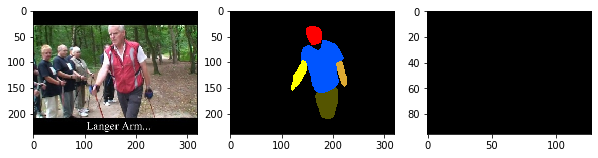

valid or not (y/n)n
88
tensor([ 29, 155, 156, 157,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


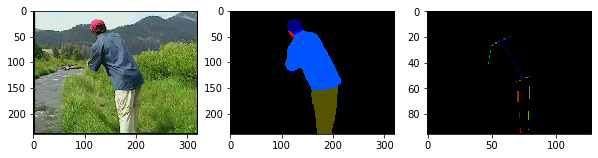

valid or not (y/n)y
89
tensor([177,  70, 178,  16, 179,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


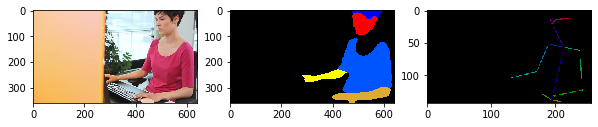

valid or not (y/n)y
90
tensor([158,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


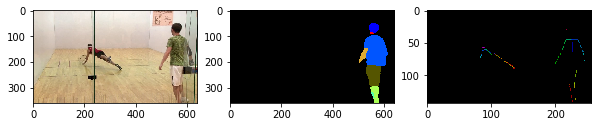

valid or not (y/n)n
91
tensor([127,  39,  40,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


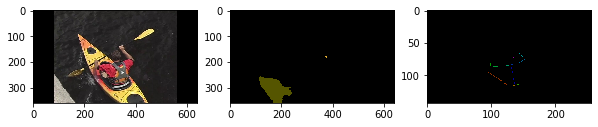

valid or not (y/n)n
92
tensor([173, 135,  12,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


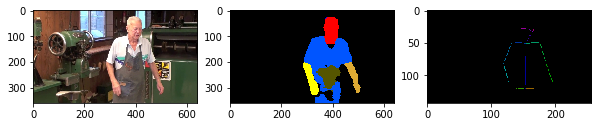

valid or not (y/n)y
93
tensor([145, 146,  21,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


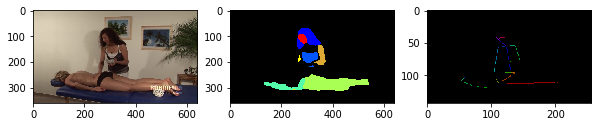

valid or not (y/n)n
94
tensor([180,  21,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


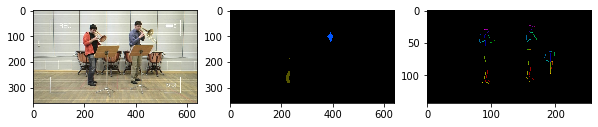

valid or not (y/n)n
95
tensor([ 42, 181, 740, 182, 183, 184, 185, 186, 187,   0,   0,   0,   0,   0,
          0,   0,   0])


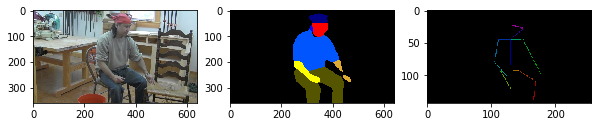

valid or not (y/n)y
96
tensor([188, 181, 189, 190,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


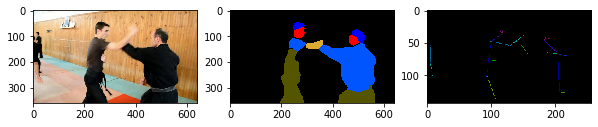

valid or not (y/n)n
97
tensor([191, 153, 170, 154,  16, 191,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


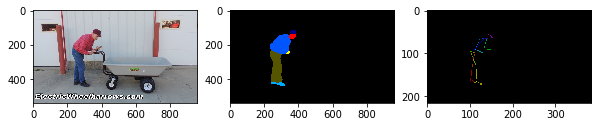

valid or not (y/n)y
98
tensor([99,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0])


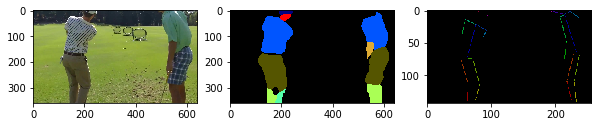

valid or not (y/n)n
99
tensor([29, 12,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0])


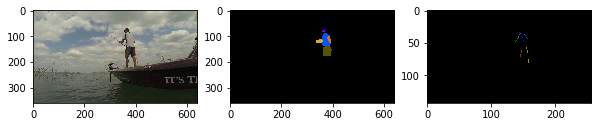

valid or not (y/n)y
100
tensor([192, 193,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


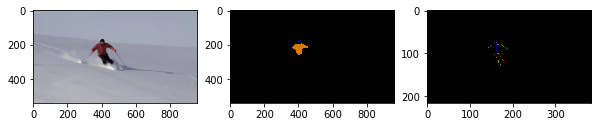

valid or not (y/n)y
101
tensor([194, 195,  16, 196,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


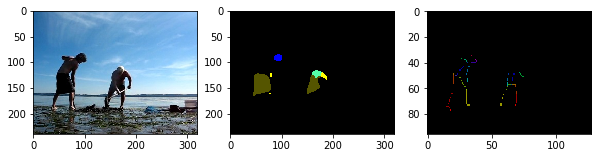

valid or not (y/n)n
102
tensor([35, 16, 36, 37,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0])


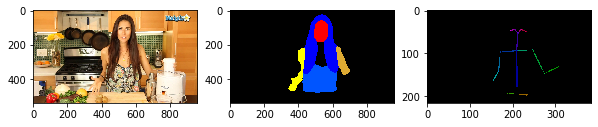

valid or not (y/n)y
103
tensor([197,  27,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


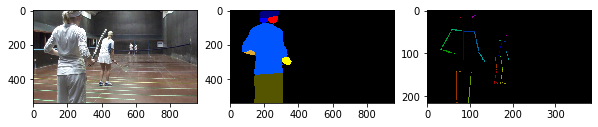

valid or not (y/n)n
104
tensor([198, 199,  65, 200, 201, 202, 203,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


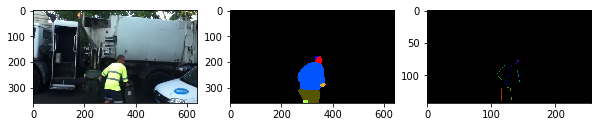

valid or not (y/n)y
105
tensor([204, 205,  16, 206,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


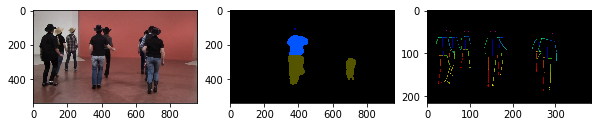

valid or not (y/n)n
106
tensor([128,  83,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


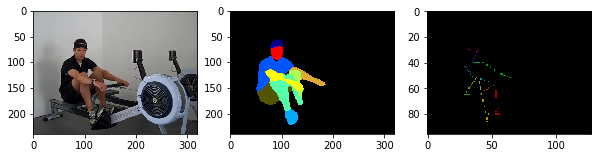

valid or not (y/n)y
107
tensor([207, 208, 740, 102, 209,  65,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


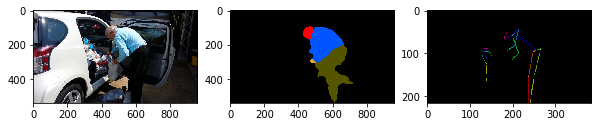

valid or not (y/n)n
108
tensor([107, 108,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


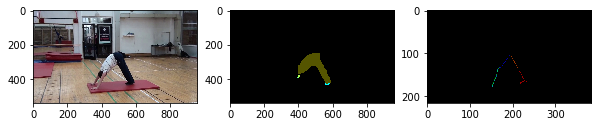

valid or not (y/n)y
109
tensor([210,  98,  12,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


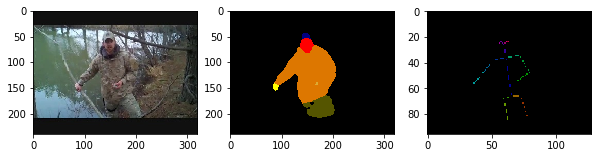

valid or not (y/n)y
110
tensor([211, 212,  21,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


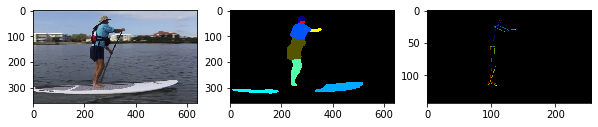

valid or not (y/n)y
111
tensor([126,  13,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


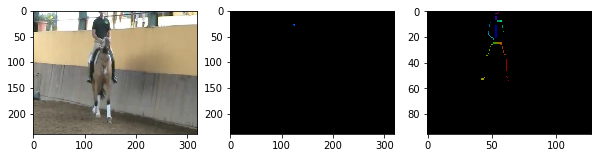

valid or not (y/n)n
112
tensor([107, 108,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


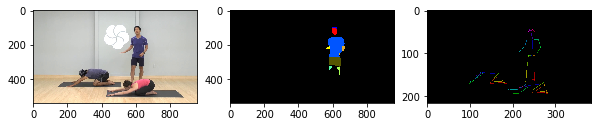

valid or not (y/n)n
113
tensor([204, 205,  16, 206,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


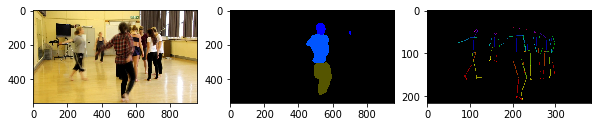

valid or not (y/n)n
114
tensor([ 21, 181, 740, 182, 213, 214, 183, 185,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


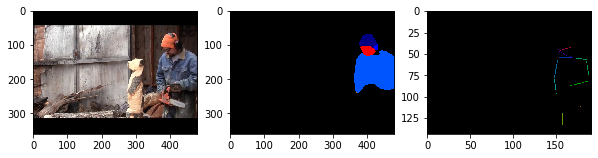

valid or not (y/n)n
115
tensor([29, 12,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0])


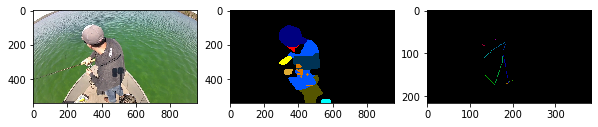

valid or not (y/n)y
116
tensor([188, 181, 189, 190,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


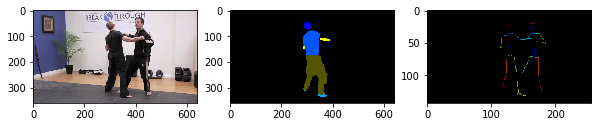

valid or not (y/n)n
117
tensor([ 29, 155, 156, 157,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


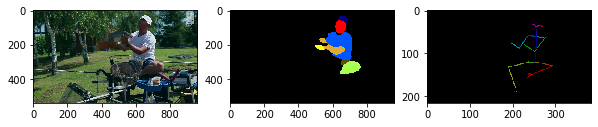

valid or not (y/n)y
118
tensor([215, 216,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


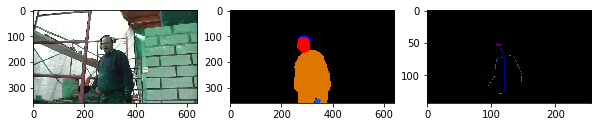

valid or not (y/n)y
119
tensor([35, 16, 36, 37,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0])


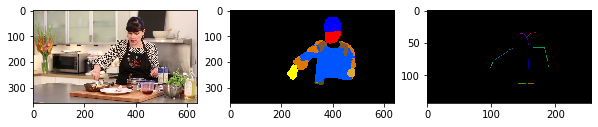

valid or not (y/n)y
120
tensor([46, 47,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0])


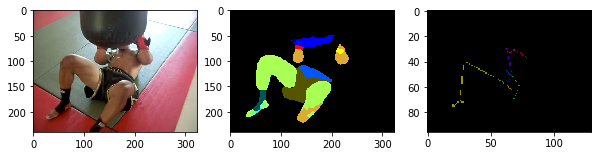

valid or not (y/n)y
121
tensor([110,  12,  39,  40,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


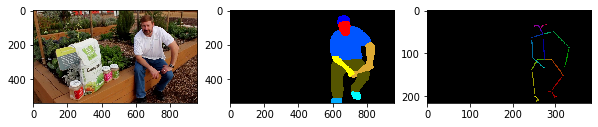

valid or not (y/n)y
122
tensor([128,  83,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


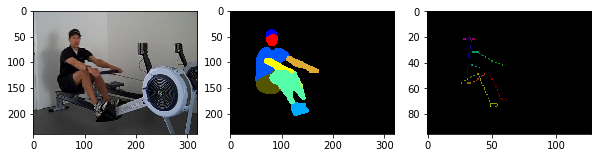

valid or not (y/n)y
123
tensor([217,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


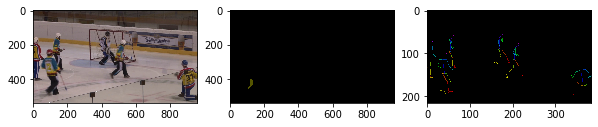

valid or not (y/n)n
124
tensor([ 28,  16, 218, 219,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


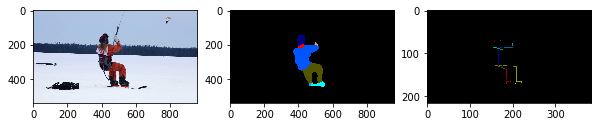

valid or not (y/n)y
125
tensor([ 65, 220, 221,  16, 222, 740, 223, 224, 225,   0,   0,   0,   0,   0,
          0,   0,   0])


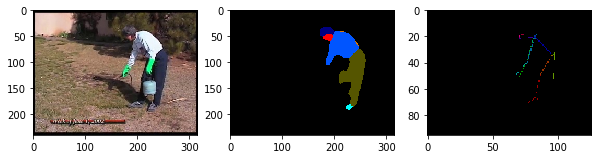

valid or not (y/n)y
126
tensor([ 21, 226,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


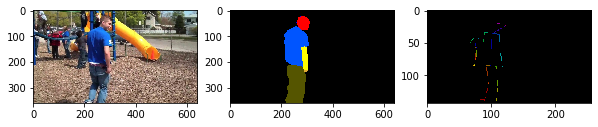

valid or not (y/n)n
127
tensor([103,  12, 104,   5,   6, 740,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


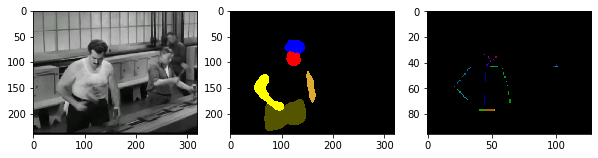

valid or not (y/n)y
128
tensor([227,  12,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


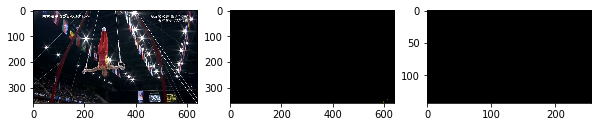

valid or not (y/n)n
129
tensor([740, 228, 165, 129, 740, 229, 740, 230, 231, 232, 740,   0,   0,   0,
          0,   0,   0])


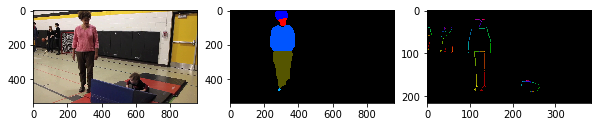

valid or not (y/n)n
130
tensor([233, 234, 740,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


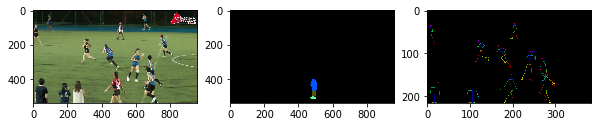

valid or not (y/n)n
131
tensor([138,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


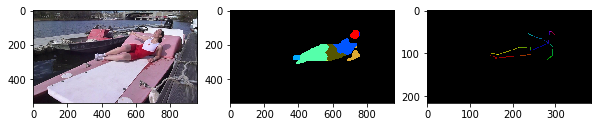

valid or not (y/n)y
132
tensor([ 29, 235,  34, 130, 236,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


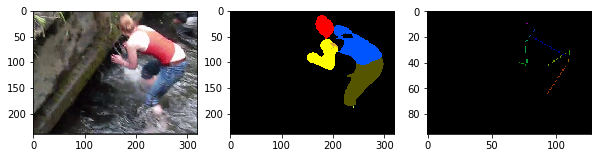

valid or not (y/n)y
133
tensor([48,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0])


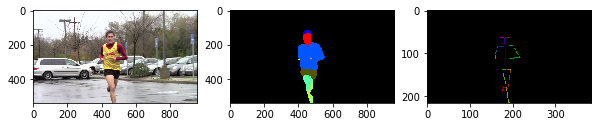

valid or not (y/n)y
134
tensor([192, 740, 237, 238, 239,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


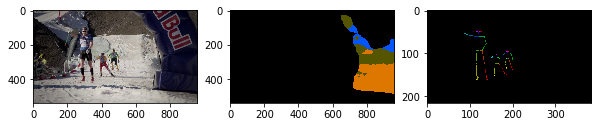

valid or not (y/n)n
135
tensor([240,  20,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


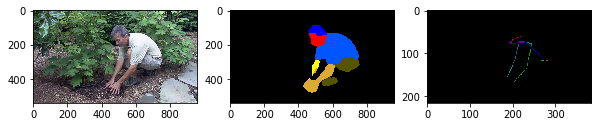

valid or not (y/n)y
136
tensor([ 21, 181, 740, 182, 213, 214, 183, 185,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


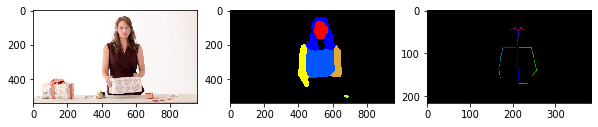

valid or not (y/n)y
137
tensor([241,  42,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


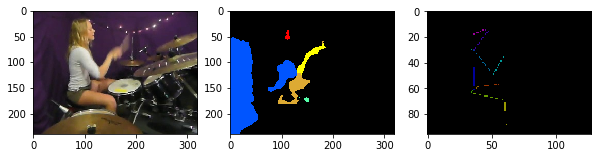

valid or not (y/n)n
138
tensor([173, 135,  12,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


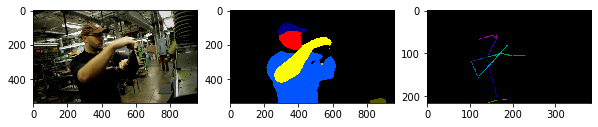

valid or not (y/n)y
139
tensor([242, 243,  52, 244, 245,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


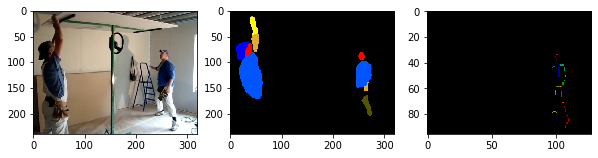

valid or not (y/n)n
140
tensor([133,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


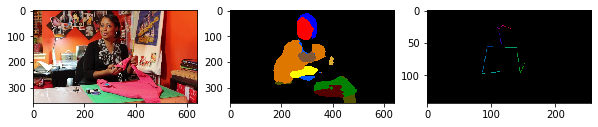

valid or not (y/n)n
141
tensor([194, 246, 247, 248,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


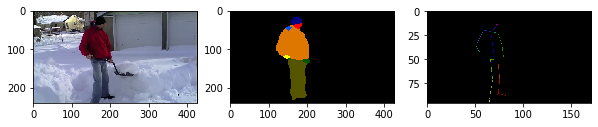

valid or not (y/n)y
142
tensor([249,  82, 250, 251, 252, 253,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


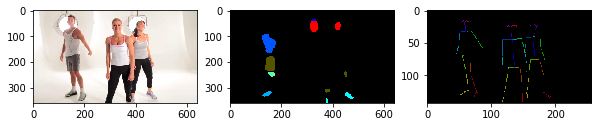

valid or not (y/n)n
143
tensor([139, 140,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


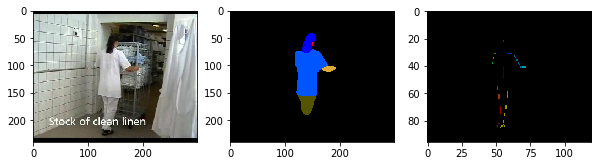

valid or not (y/n)y
144
tensor([254, 255,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


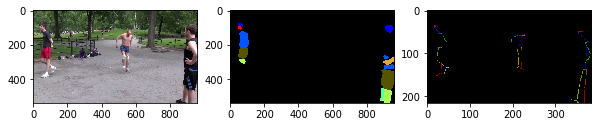

valid or not (y/n)n
145
tensor([ 42, 181, 740, 182, 183, 184, 185, 186, 187,   0,   0,   0,   0,   0,
          0,   0,   0])


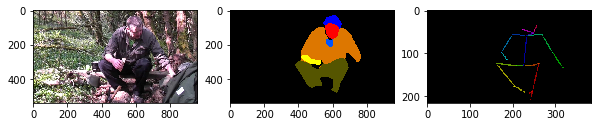

valid or not (y/n)y
146
tensor([35, 16, 36, 37,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0])


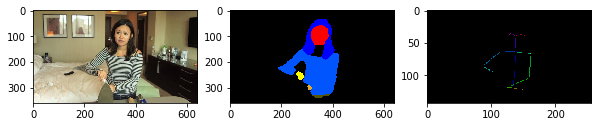

valid or not (y/n)y
147
tensor([256,  12,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


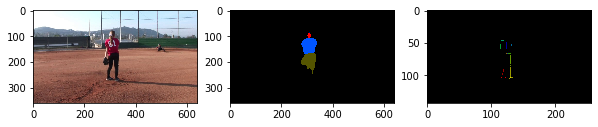

valid or not (y/n)n
148
tensor([159, 257,  12,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


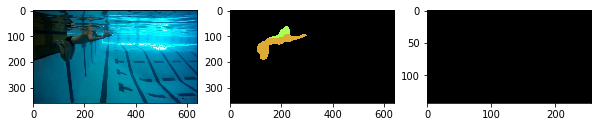

valid or not (y/n)n
149
tensor([ 62, 207,  16, 258, 184,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


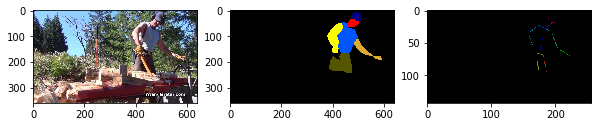

valid or not (y/n)y
150
tensor([ 62, 259, 260,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


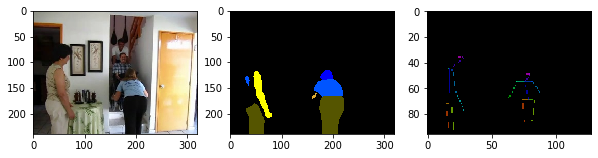

valid or not (y/n)n
151
tensor([ 65, 261, 262,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


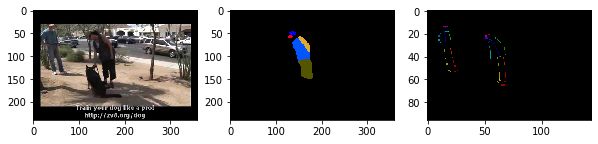

valid or not (y/n)n
152
tensor([194, 195,  16, 196,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


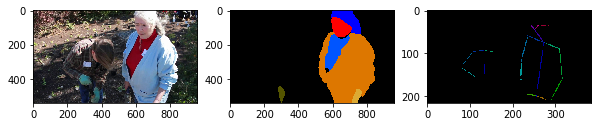

valid or not (y/n)n
153
tensor([263, 264,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


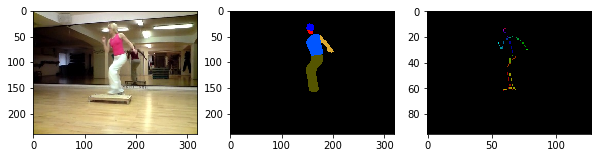

valid or not (y/n)y
154
tensor([265,   2, 740, 740,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


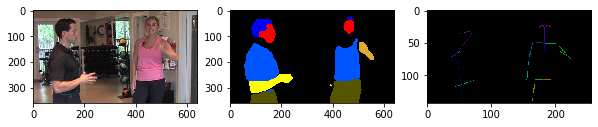

valid or not (y/n)n
155
tensor([105, 266, 267, 132, 268, 740, 740,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


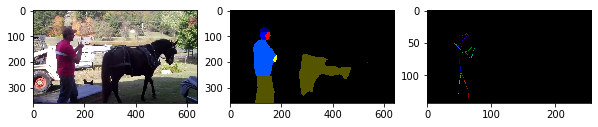

valid or not (y/n)n
156
tensor([269,  12,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


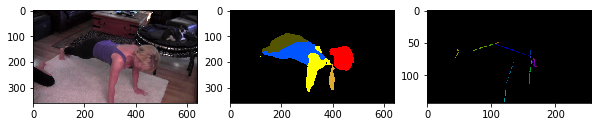

valid or not (y/n)y
157
tensor([197,  27,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


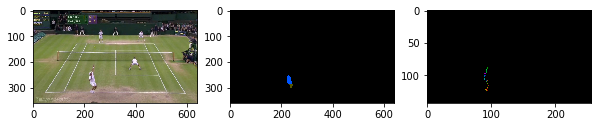

valid or not (y/n)n
158
tensor([198, 199,  65, 200, 201, 202, 203,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


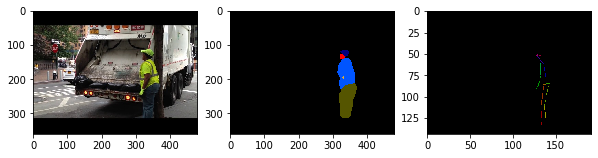

valid or not (y/n)y
159
tensor([270,  65,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


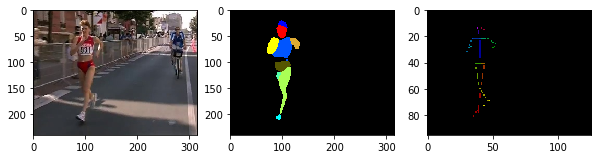

valid or not (y/n)y
160
tensor([ 29, 235,  34, 130, 236,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


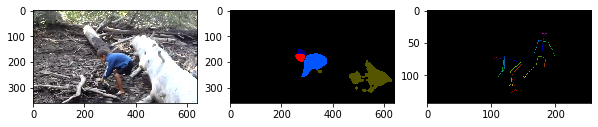

valid or not (y/n)n
161
tensor([72,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0])


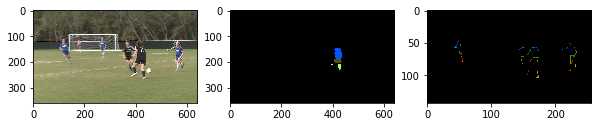

valid or not (y/n)n
162
tensor([178,  16, 271, 272,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


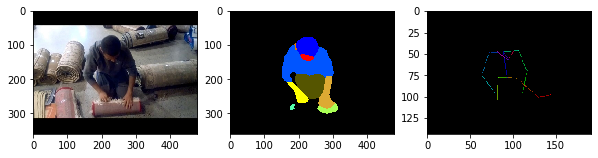

valid or not (y/n)n
163
tensor([105, 266, 267, 132, 268, 740, 740,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


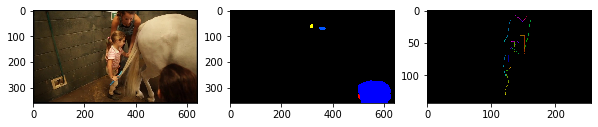

valid or not (y/n)n
164
tensor([740,  54,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


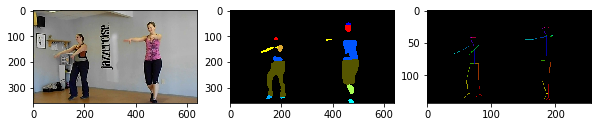

valid or not (y/n)n
165
tensor([126,  13,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


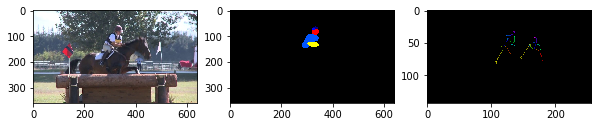

valid or not (y/n)n
166
tensor([256,  12,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


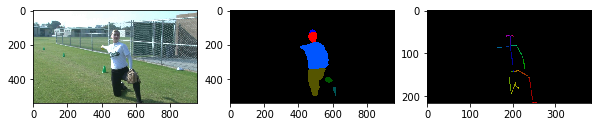

valid or not (y/n)y
167
tensor([ 29, 155, 156, 157,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


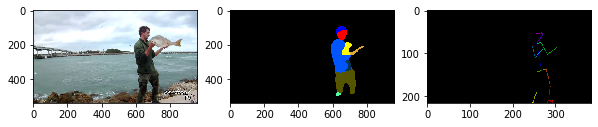

valid or not (y/n)y
168
tensor([273,  12,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


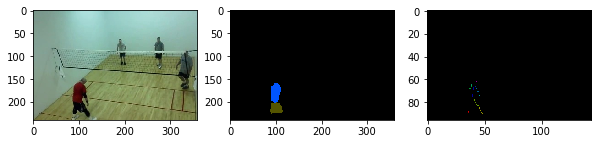

valid or not (y/n)n
169
tensor([ 42,  14, 274,  12, 275, 740,  16, 274, 276,   0,   0,   0,   0,   0,
          0,   0,   0])


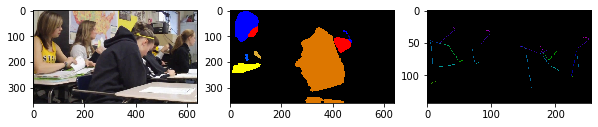

valid or not (y/n)n
170
tensor([277,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


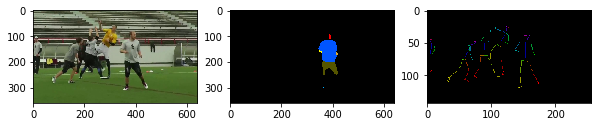

valid or not (y/n)n
171
tensor([ 42, 181, 740, 182, 183, 184, 185, 186, 187,   0,   0,   0,   0,   0,
          0,   0,   0])


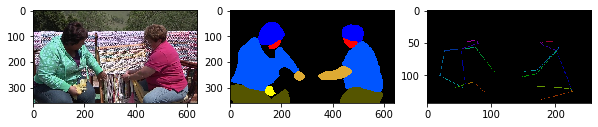

valid or not (y/n)n
172
tensor([ 64, 278,  64, 279,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


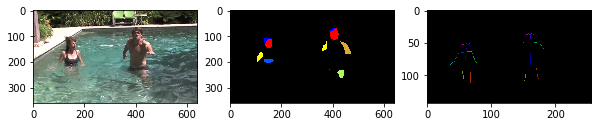

valid or not (y/n)n
173
tensor([280, 281, 282, 283,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


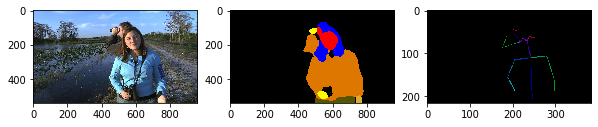

valid or not (y/n)n
174
tensor([73, 74, 12,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0])


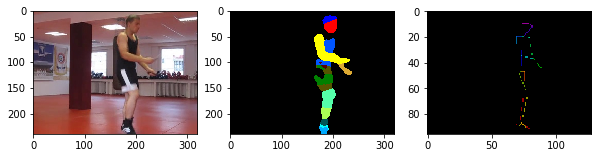

valid or not (y/n)y
175
tensor([246, 284,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


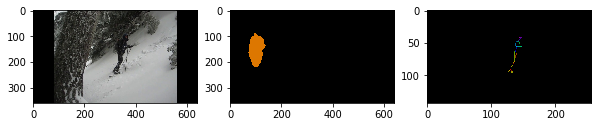

valid or not (y/n)n
176
tensor([238, 285, 116,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


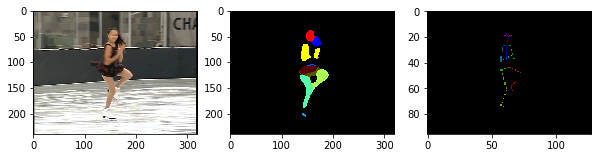

valid or not (y/n)y
177
tensor([  1, 127, 128,  49,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


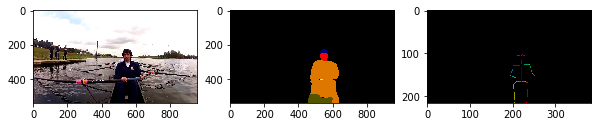

valid or not (y/n)y
178
tensor([128,  83,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


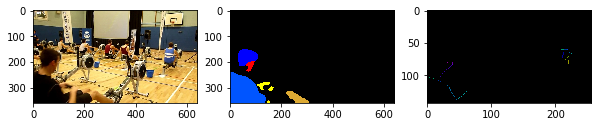

valid or not (y/n)n
179
tensor([173, 135,  12,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


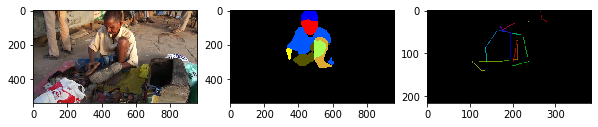

valid or not (y/n)y
180
tensor([240, 286, 287, 288,  16, 289, 290,  40,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


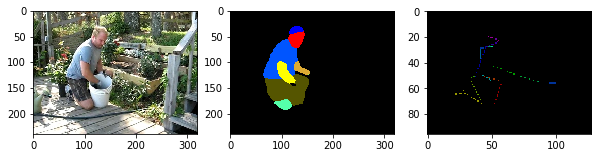

valid or not (y/n)y
181
tensor([192, 193,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


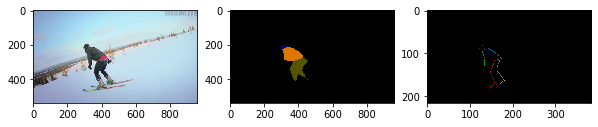

valid or not (y/n)y
182
tensor([204, 205,  16, 206,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


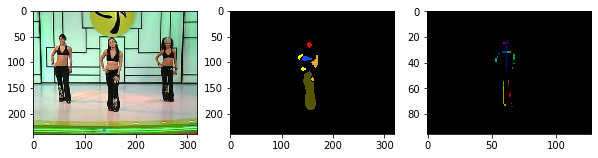

valid or not (y/n)y
183
tensor([128,  83,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


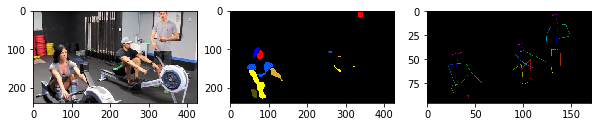

valid or not (y/n)n
184
tensor([ 11, 291,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


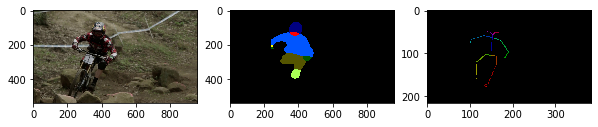

valid or not (y/n)y
185
tensor([292, 293, 247,  71, 290,  40,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


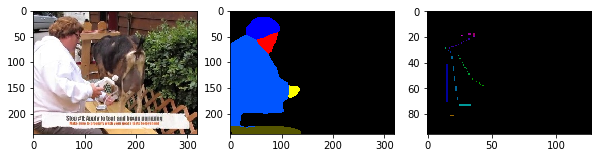

valid or not (y/n)y
186
tensor([ 69, 294, 295,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


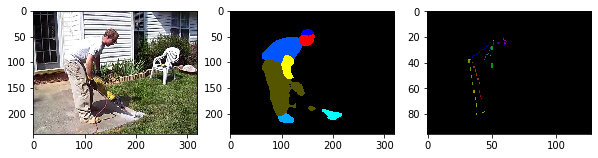

valid or not (y/n)y
187
tensor([280, 281, 282, 283,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


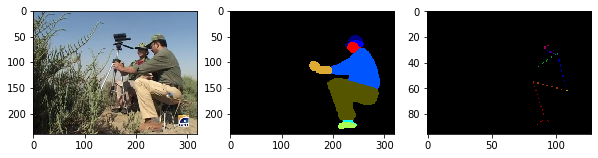

valid or not (y/n)y
188
tensor([296,  12,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


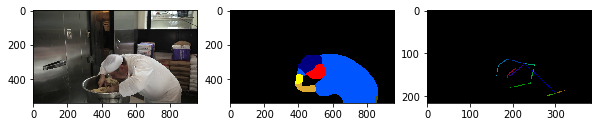

valid or not (y/n)y
189
tensor([740, 297, 298, 299,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


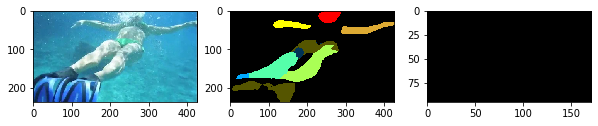

valid or not (y/n)n
190
tensor([300, 295,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


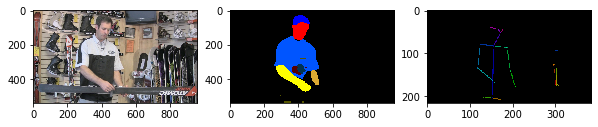

valid or not (y/n)y
191
tensor([301, 302, 303, 140,  21,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


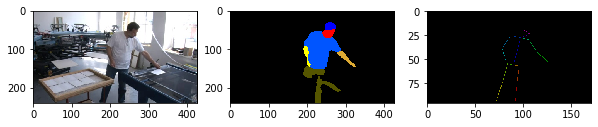

valid or not (y/n)y
192
tensor([304, 223, 283, 248, 305,   5,   6, 740,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


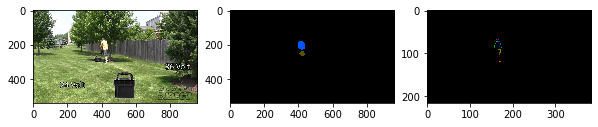

valid or not (y/n)n
193
tensor([100, 306, 214, 306,  39,  40,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


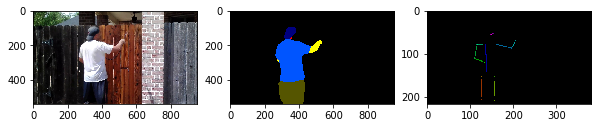

valid or not (y/n)y
194
tensor([307, 308, 309, 310,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


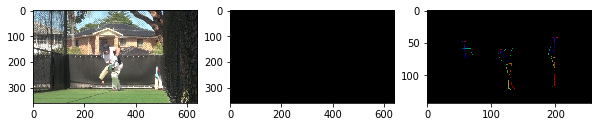

valid or not (y/n)n
195
tensor([103,  12,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


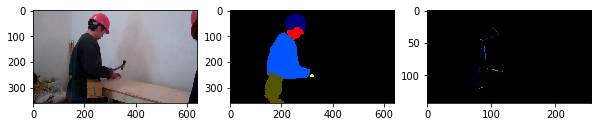

valid or not (y/n)y
196
tensor([ 29, 155, 156, 157,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


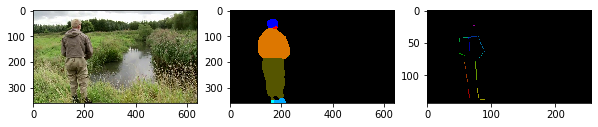

valid or not (y/n)y
197
tensor([311,  21,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


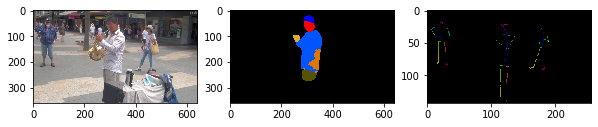

valid or not (y/n)n
198
tensor([312,  42,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


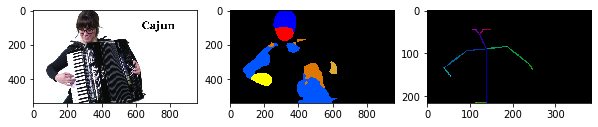

valid or not (y/n)n
199
tensor([313,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


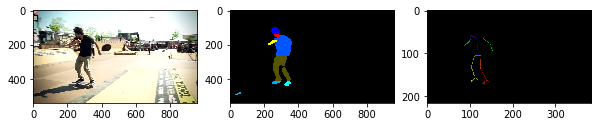

valid or not (y/n)y
200
tensor([ 29, 314,  31,  32,  31, 740,  33,  34,  12,   0,   0,   0,   0,   0,
          0,   0,   0])


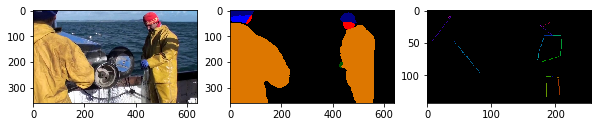

valid or not (y/n)n
201
tensor([72,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0])


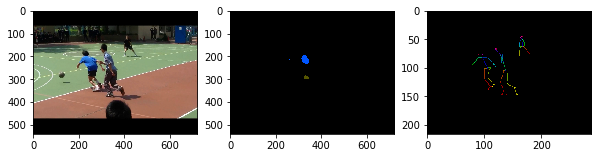

valid or not (y/n)n
202
tensor([740, 228, 165, 129, 740, 229, 740, 230, 231, 232, 740,   0,   0,   0,
          0,   0,   0])


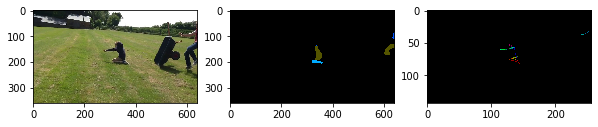

valid or not (y/n)n
203
tensor([114,  16, 115, 116, 740, 117, 118, 119, 120, 121, 122, 740, 123, 124,
        125,   0,   0])


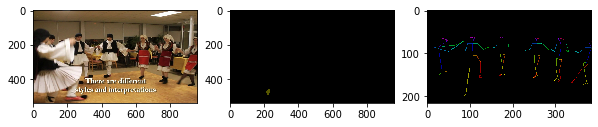

valid or not (y/n)n
204
tensor([ 21, 181, 740, 182, 213, 214, 183, 185,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


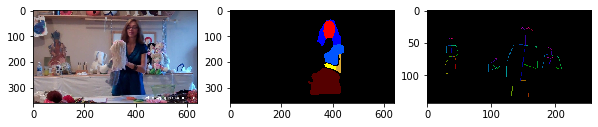

valid or not (y/n)n
205
tensor([103, 315,  16, 316, 317,  16,  59,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


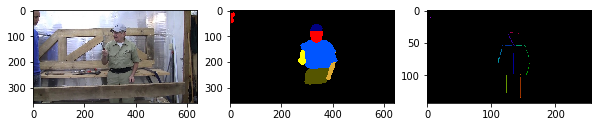

valid or not (y/n)y
206
tensor([318, 135,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


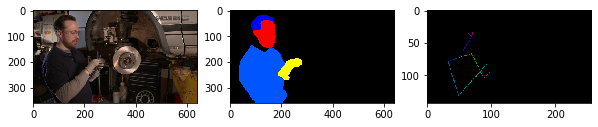

valid or not (y/n)y
207
tensor([238, 285, 116,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


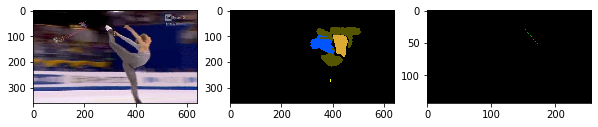

valid or not (y/n)n
208
tensor([35, 16, 36, 37,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0])


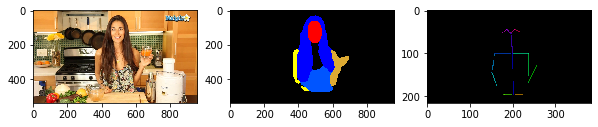

valid or not (y/n)y
209
tensor([ 11, 291,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


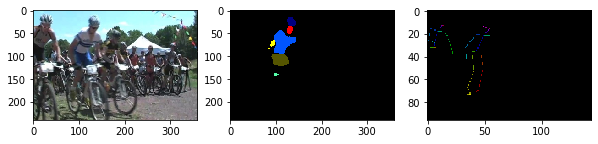

valid or not (y/n)n
210
tensor([192,  12,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


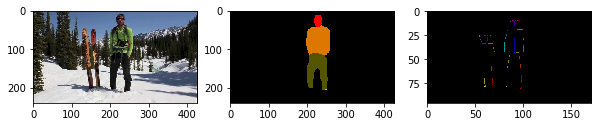

valid or not (y/n)n
211
tensor([ 21, 226,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


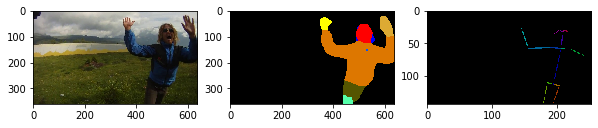

valid or not (y/n)y
212
tensor([319, 320, 170,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


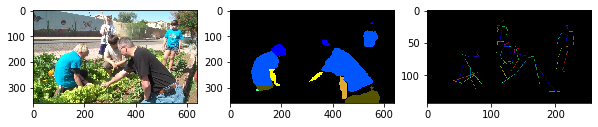

valid or not (y/n)n
213
tensor([11, 83,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0])


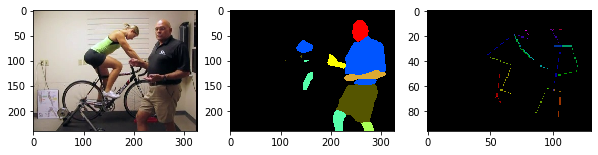

valid or not (y/n)n
214
tensor([103,  12,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


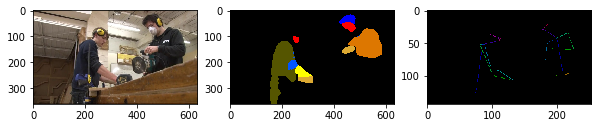

valid or not (y/n)n
215
tensor([88, 89, 90, 91, 12,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0])


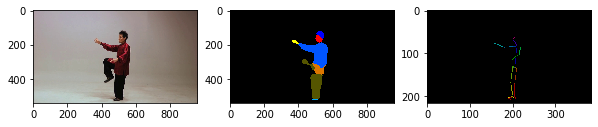

valid or not (y/n)y
216
tensor([167, 168, 169, 170, 171,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


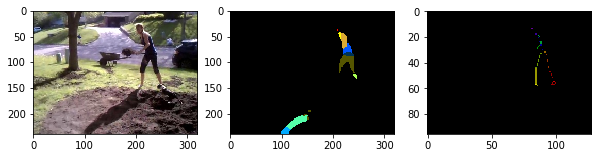

valid or not (y/n)y
217
tensor([194, 246, 247, 248,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


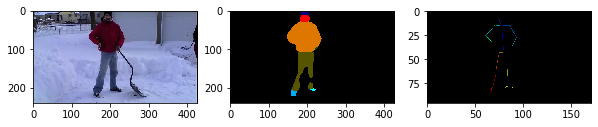

valid or not (y/n)y
218
tensor([238, 285, 116,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


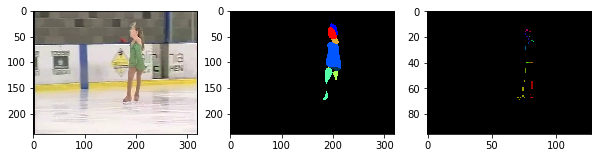

valid or not (y/n)y
219
tensor([ 11,  50, 740,  51,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


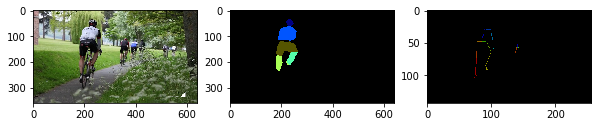

valid or not (y/n)y
220
tensor([109,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


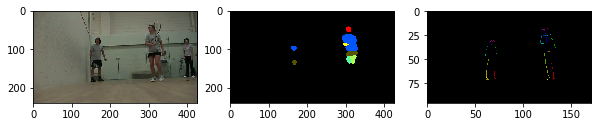

valid or not (y/n)n
221
tensor([740,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


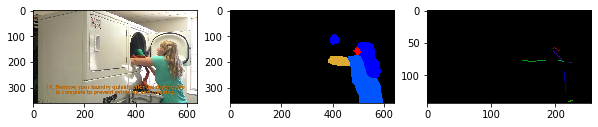

valid or not (y/n)n
222
tensor([270,  65,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


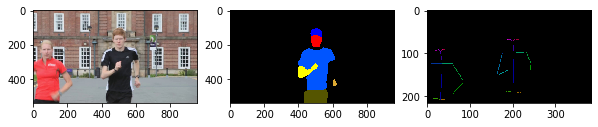

valid or not (y/n)n
223
tensor([ 21, 321, 322,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


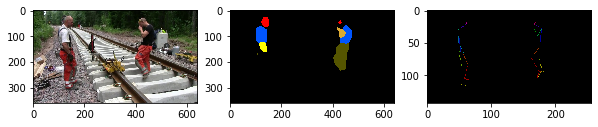

valid or not (y/n)n
224
tensor([35, 16, 36, 37,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0])


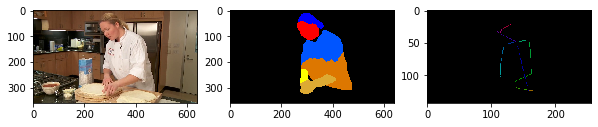

valid or not (y/n)y
225
tensor([207, 208, 740, 102, 209,  65,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


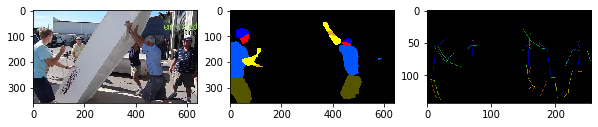

valid or not (y/n)n
226
tensor([ 21, 226,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


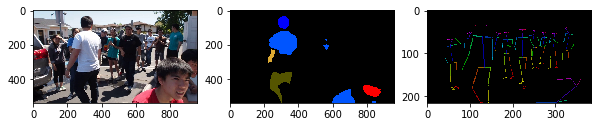

valid or not (y/n)n
227
tensor([ 24,  25,  26, 740,  27,  12,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


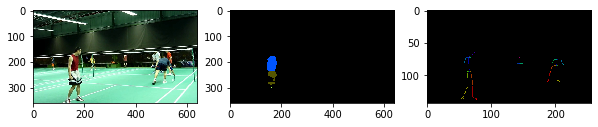

valid or not (y/n)n
228
tensor([323, 324,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


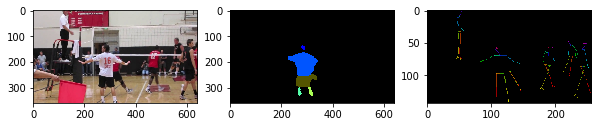

valid or not (y/n)n
229
tensor([240, 288, 325, 326,  39,  40,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


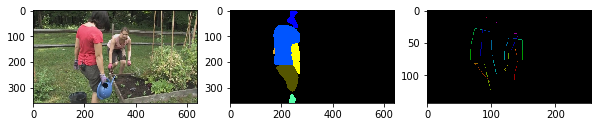

valid or not (y/n)n
230
tensor([327,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


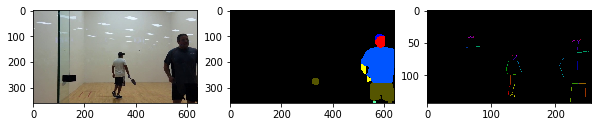

valid or not (y/n)n
231
tensor([ 11, 106,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


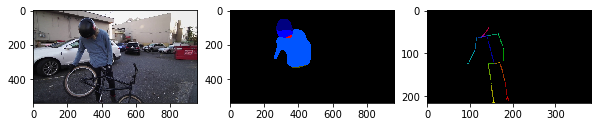

valid or not (y/n)y
232
tensor([107, 108,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


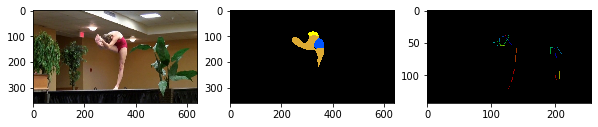

valid or not (y/n)n
233
tensor([ 29, 155, 328,  16, 329,  42,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


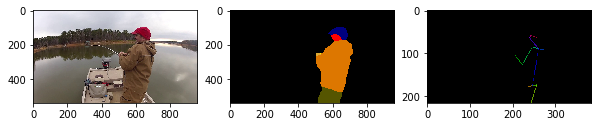

valid or not (y/n)y
234
tensor([197,  27,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


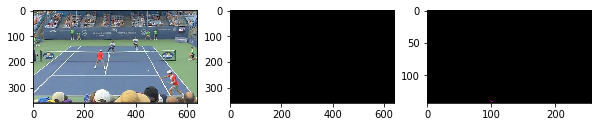

valid or not (y/n)n
235
tensor([296,  12,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


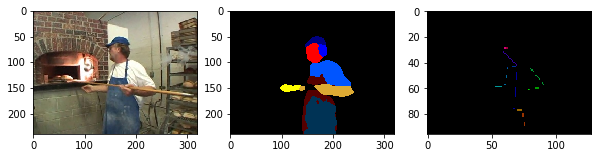

valid or not (y/n)y
236
tensor([330,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


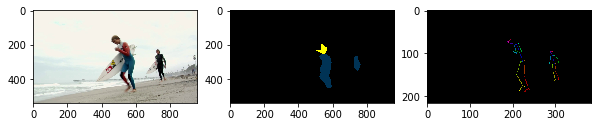

valid or not (y/n)n
237
tensor([95, 47,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0])


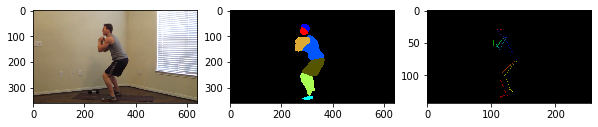

valid or not (y/n)y
238
tensor([11, 83,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0])


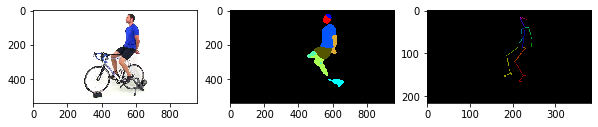

valid or not (y/n)y
239
tensor([331, 332, 333, 334, 333,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


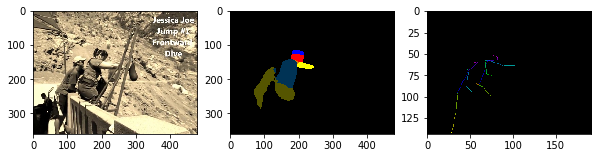

valid or not (y/n)n
240
tensor([158,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


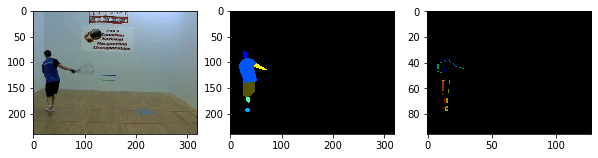

valid or not (y/n)y
241
tensor([109,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


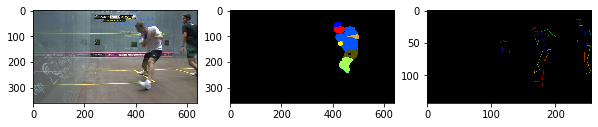

valid or not (y/n)n
242
tensor([  1,   2,   3,   4,   5,   6, 740,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


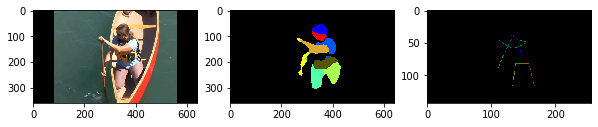

valid or not (y/n)y
243
tensor([740, 335, 130,  16, 336, 740, 154,  21,  16,  65,   0,   0,   0,   0,
          0,   0,   0])


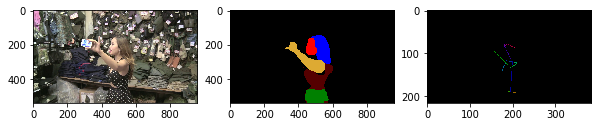

valid or not (y/n)y
244
tensor([337, 338,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


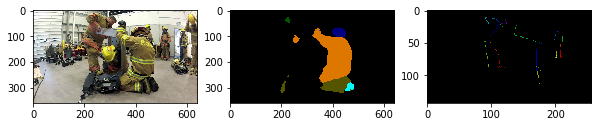

valid or not (y/n)n
245
tensor([73, 74, 12,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0])


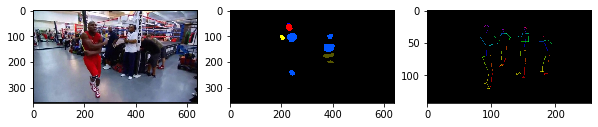

valid or not (y/n)n
246
tensor([339,  42,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


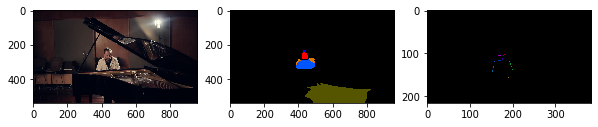

valid or not (y/n)n
247
tensor([100, 740, 101, 102,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


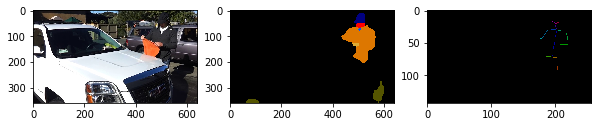

valid or not (y/n)n
248
tensor([ 48, 340, 341,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


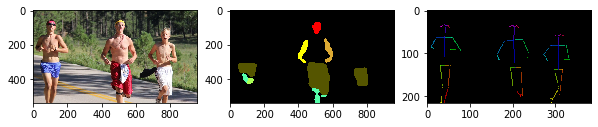

valid or not (y/n)n
249
tensor([133,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


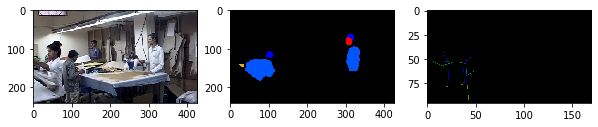

valid or not (y/n)n
250
tensor([145, 146,  21,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


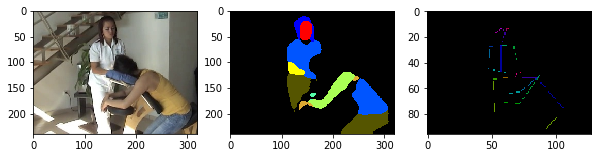

valid or not (y/n)n
251
tensor([129, 130, 131,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


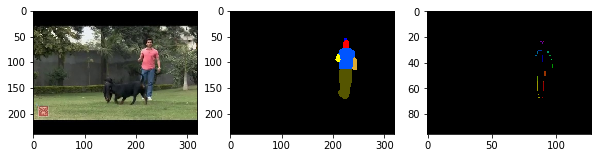

valid or not (y/n)y
252
tensor([ 21,  56,  14, 342,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


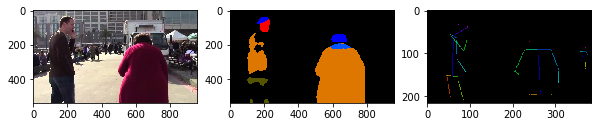

valid or not (y/n)n
253
tensor([8, 9, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0])


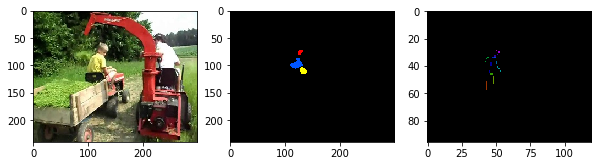

valid or not (y/n)n
254
tensor([343, 344,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


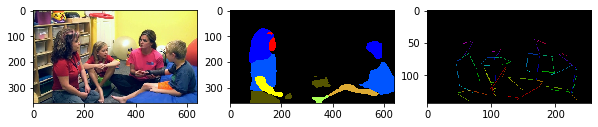

valid or not (y/n)n
255
tensor([345,  36,  14,  57,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


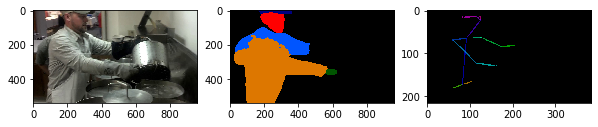

valid or not (y/n)y
256
tensor([192, 193,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


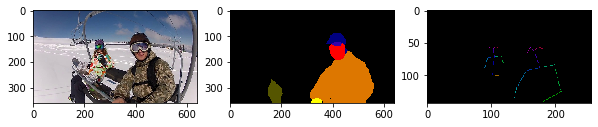

valid or not (y/n)n
257
tensor([346,  16, 347, 348,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


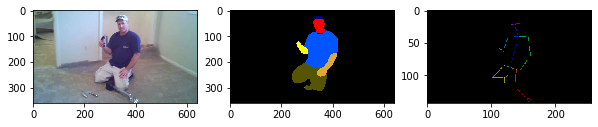

valid or not (y/n)y
258
tensor([ 42, 129, 349, 350, 351,  57,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


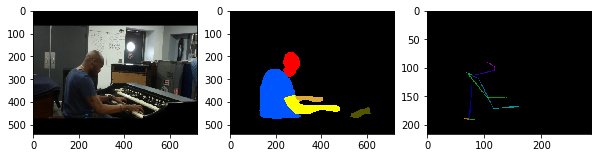

valid or not (y/n)y
259
tensor([ 21, 226,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


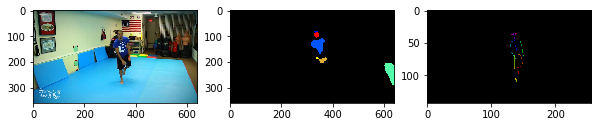

valid or not (y/n)n
260
tensor([352,  16,  66,  59,  12,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


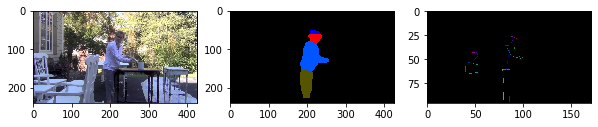

valid or not (y/n)n
261
tensor([18, 19, 16, 20,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0])


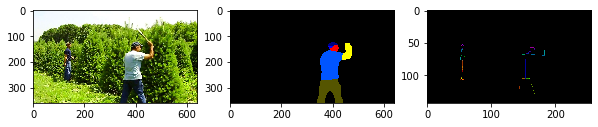

valid or not (y/n)n
262
tensor([35, 16, 36, 37,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0])


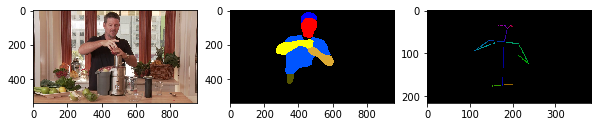

valid or not (y/n)y
263
tensor([ 69, 353,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


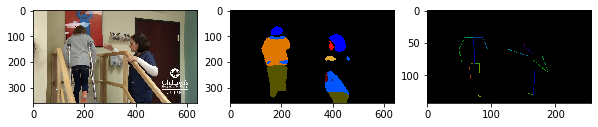

valid or not (y/n)n
264
tensor([354, 355, 214,  21,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


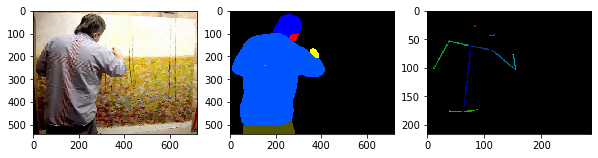

valid or not (y/n)y
265
tensor([46, 47,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0])


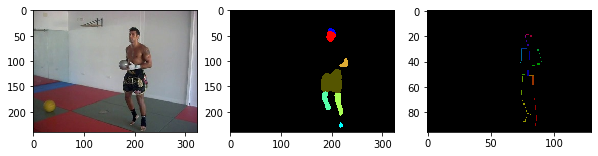

valid or not (y/n)y
266
tensor([356, 357,  12, 740,  35, 100, 358, 132, 112,  39,  40,   0,   0,   0,
          0,   0,   0])


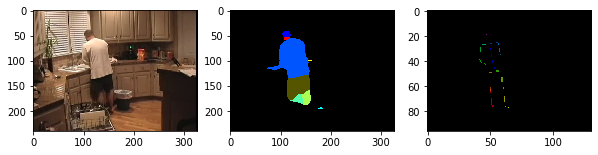

valid or not (y/n)y
267
tensor([107, 108,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


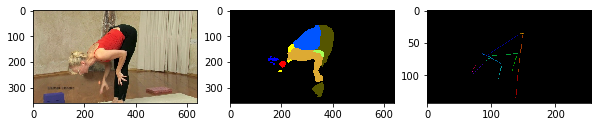

valid or not (y/n)y
268
tensor([111,  53, 359, 360,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


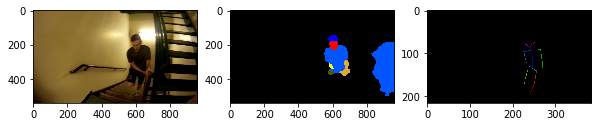

valid or not (y/n)n
269
tensor([ 29, 155, 156, 157,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


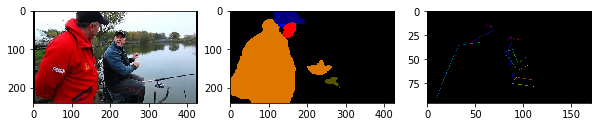

valid or not (y/n)n
270
tensor([361,  14, 362,  12,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


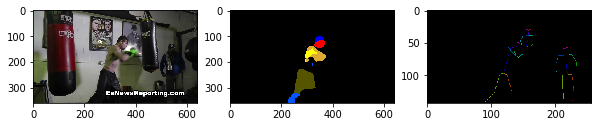

valid or not (y/n)n
271
tensor([ 29,  14, 141,  14, 142,   5,   6, 740,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


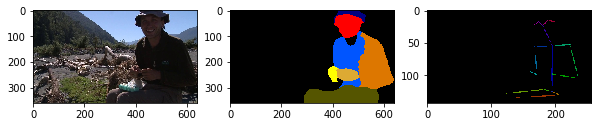

valid or not (y/n)y
272
tensor([363, 364, 365, 366,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


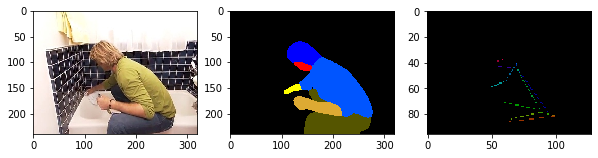

valid or not (y/n)y
273
tensor([367, 368, 369, 740, 370, 371,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


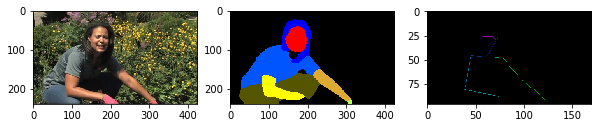

valid or not (y/n)y
274
tensor([372,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


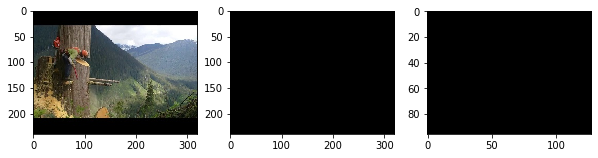

valid or not (y/n)n
275
tensor([107, 108,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


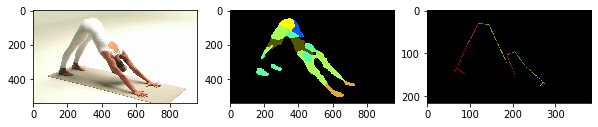

valid or not (y/n)y
276
tensor([292, 267, 373, 131,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


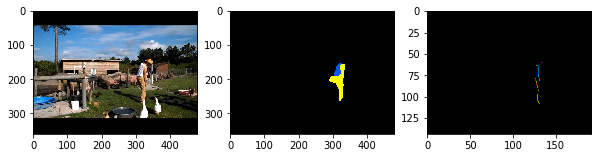

valid or not (y/n)n
277
tensor([204, 205,  16, 206,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


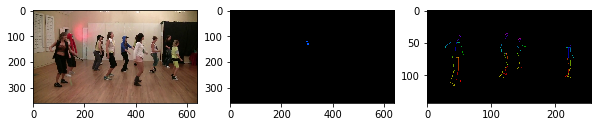

valid or not (y/n)n
278
tensor([740, 740, 374, 375, 740,  44,  12,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


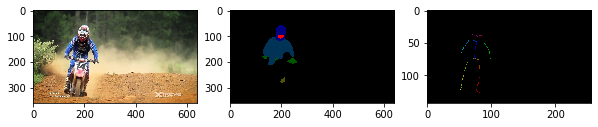

valid or not (y/n)y
279
tensor([307, 308, 309, 310,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


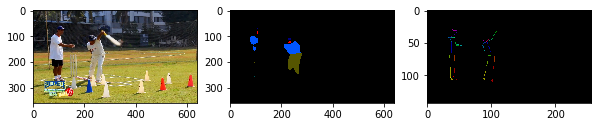

valid or not (y/n)n
280
tensor([178,  16, 271, 272,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


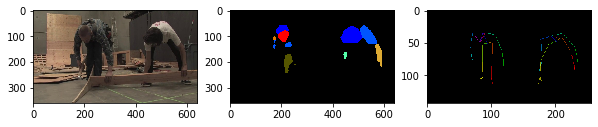

valid or not (y/n)n
281
tensor([41, 42,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0])


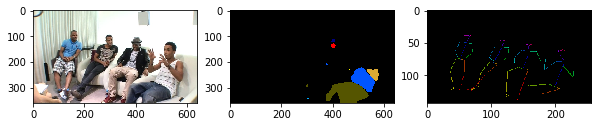

valid or not (y/n)n
282
tensor([277,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


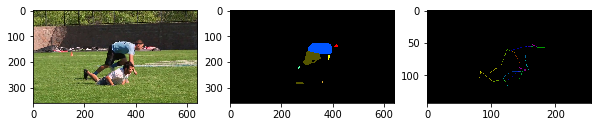

valid or not (y/n)n
283
tensor([ 42, 181, 740, 182, 183, 184, 185, 186, 187,   0,   0,   0,   0,   0,
          0,   0,   0])


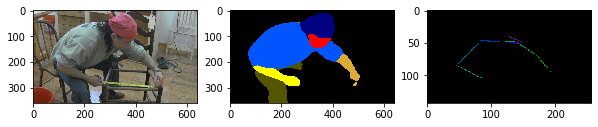

valid or not (y/n)y
284
tensor([128,  83,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


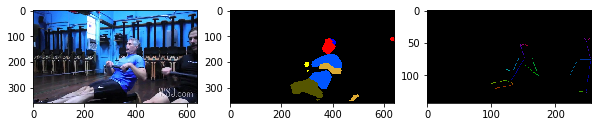

valid or not (y/n)n
285
tensor([376,  82, 377, 378,  82,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


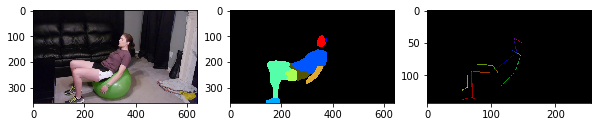

valid or not (y/n)y
286
tensor([ 24,  25,  26, 740,  27,  12,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


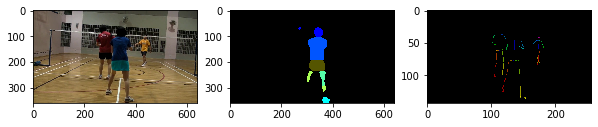

valid or not (y/n)n
287
tensor([379, 380,  39,  40,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


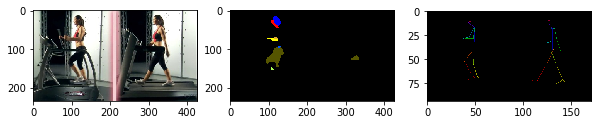

valid or not (y/n)n
288
tensor([269,  12,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


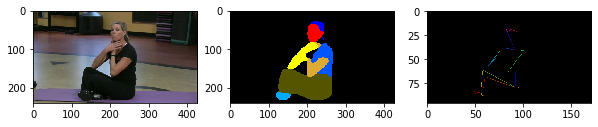

valid or not (y/n)y
289
tensor([159,  12,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


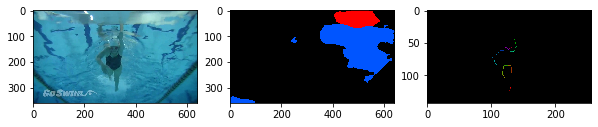

valid or not (y/n)n
290
tensor([277,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


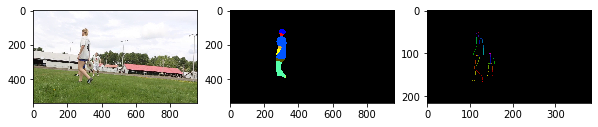

valid or not (y/n)n
291
tensor([132, 381, 100, 381,  12,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


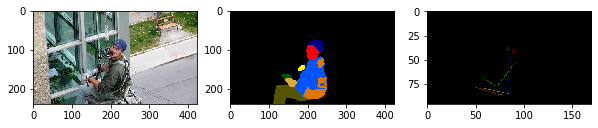

valid or not (y/n)y
292
tensor([740, 740, 374, 375, 740,  44,  12,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


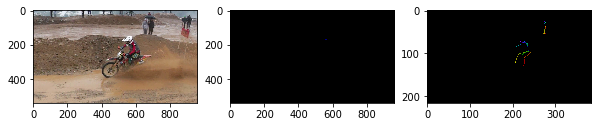

valid or not (y/n)n
293
tensor([382,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


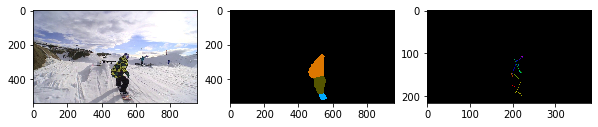

valid or not (y/n)y
294
tensor([204, 205,  16, 206,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


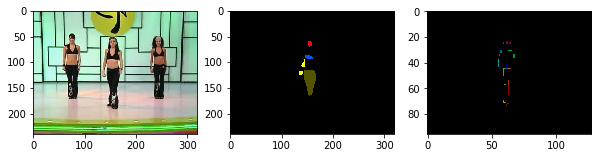

valid or not (y/n)n
295
tensor([376,  82, 377, 378,  82,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


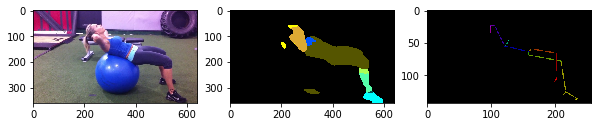

valid or not (y/n)y
296
tensor([217,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


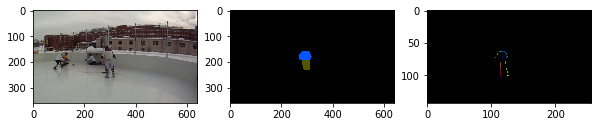

valid or not (y/n)n
297
tensor([263, 264,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


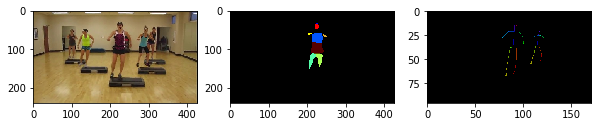

valid or not (y/n)n
298
tensor([383, 322,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


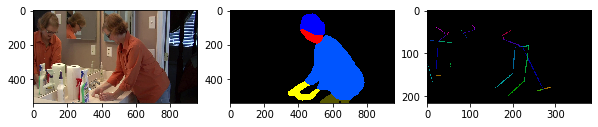

valid or not (y/n)n
299
tensor([73, 74, 12,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0])


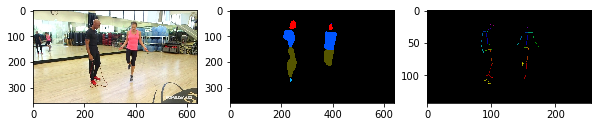

valid or not (y/n)n
300
tensor([95, 47,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0])


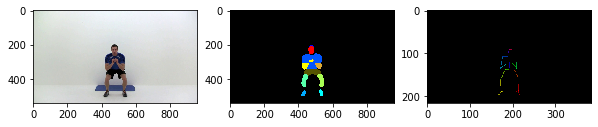

valid or not (y/n)y
301
tensor([740,  54,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


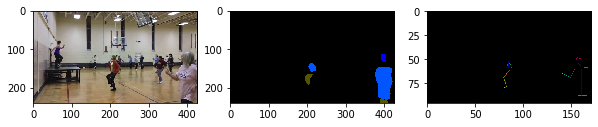

valid or not (y/n)n
302
tensor([72,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0])


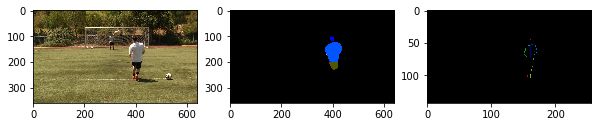

valid or not (y/n)y
303
tensor([107, 108,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


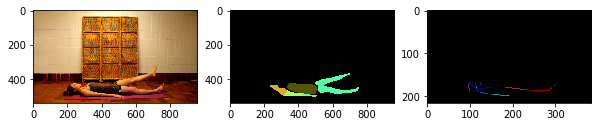

valid or not (y/n)y
304
tensor([136,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


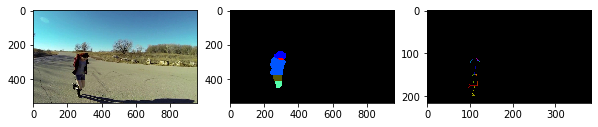

valid or not (y/n)y
305
tensor([740, 740, 374, 375, 740,  44,  12,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


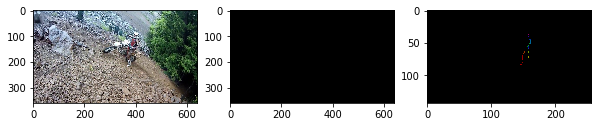

valid or not (y/n)n
306
tensor([132, 384, 385,  16, 348,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


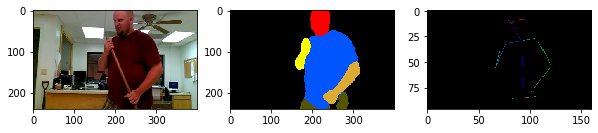

valid or not (y/n)y
307
tensor([262, 386,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


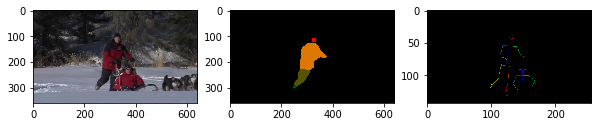

valid or not (y/n)n
308
tensor([299,   5,   6, 740,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


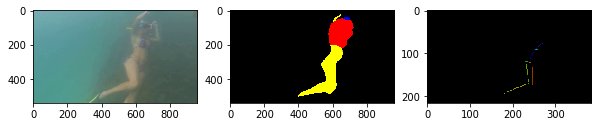

valid or not (y/n)n
309
tensor([387,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


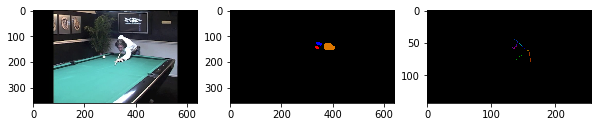

valid or not (y/n)n
310
tensor([  1, 127, 128,  49,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


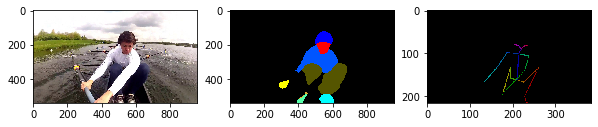

valid or not (y/n)y
311
tensor([28,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0])


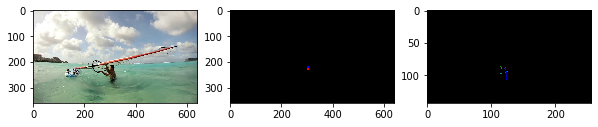

valid or not (y/n)n
312
tensor([388, 740, 389,  34, 390,  34,  16, 391,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


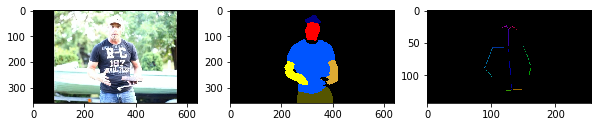

valid or not (y/n)y
313
tensor([  1, 127, 128,  49,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


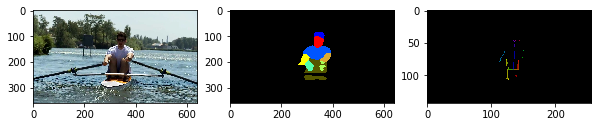

valid or not (y/n)y
314
tensor([392, 393,  16, 394, 393,  21,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


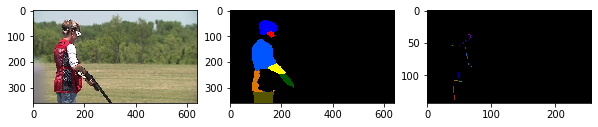

valid or not (y/n)y
315
tensor([192, 740, 237, 238, 239,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


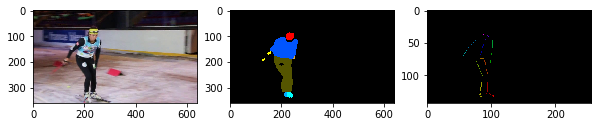

valid or not (y/n)y
316
tensor([ 11, 291,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


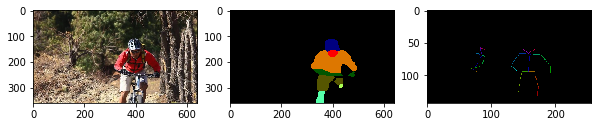

valid or not (y/n)n
317
tensor([73, 74, 12,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0])


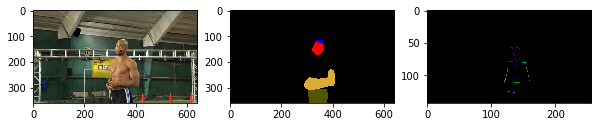

valid or not (y/n)n
318
tensor([192, 740, 237, 238, 239,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


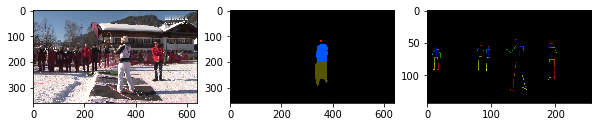

valid or not (y/n)n
319
tensor([327,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


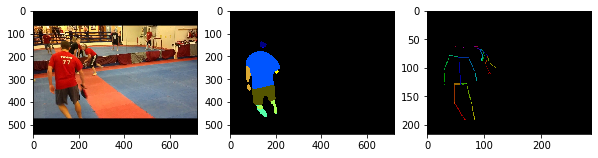

valid or not (y/n)n
320
tensor([204, 205,  16, 206,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


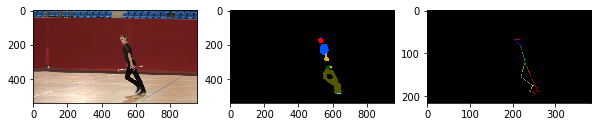

valid or not (y/n)y
321
tensor([ 48, 395,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


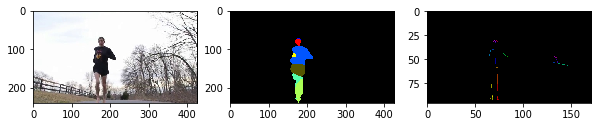

valid or not (y/n)n
322
tensor([159,  12,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


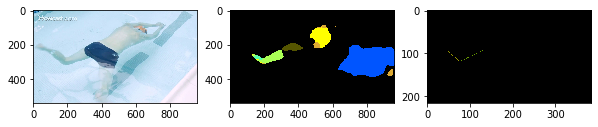

valid or not (y/n)n
323
tensor([103,  12,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


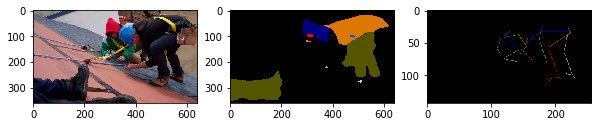

valid or not (y/n)n
324
tensor([48,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0])


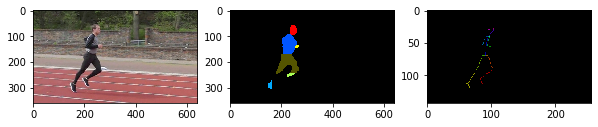

valid or not (y/n)y
325
tensor([343, 344,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


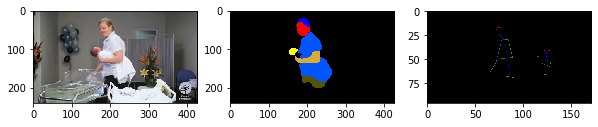

valid or not (y/n)n
326
tensor([100, 740, 101, 102,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


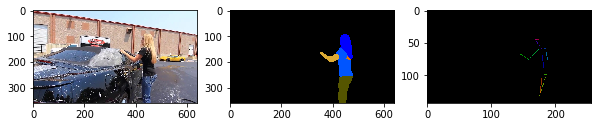

valid or not (y/n)y
327
tensor([396, 184,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


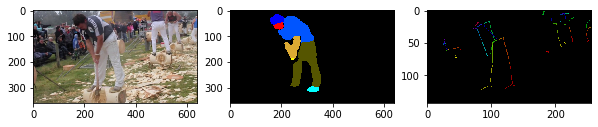

valid or not (y/n)n
328
tensor([246, 284,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


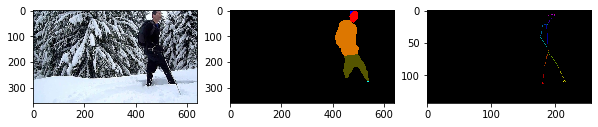

valid or not (y/n)y
329
tensor([105,  50,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


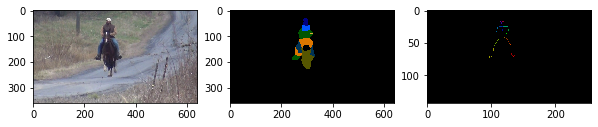

valid or not (y/n)n
330
tensor([397, 398,  21,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


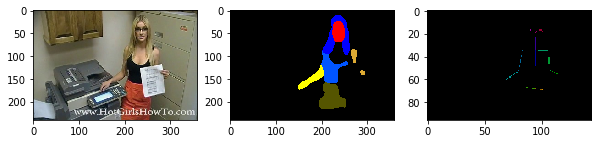

valid or not (y/n)y
331
tensor([ 62, 207,  16, 258, 184,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


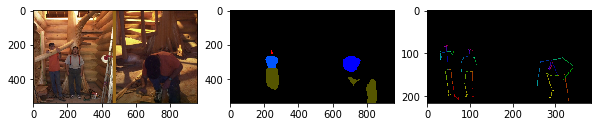

valid or not (y/n)n
332
tensor([399, 740,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


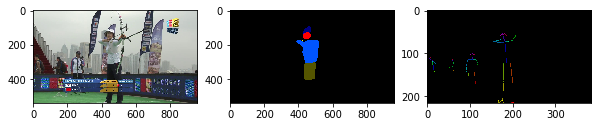

valid or not (y/n)n
333
tensor([129, 130, 400,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


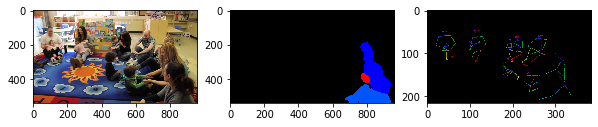

valid or not (y/n)n
334
tensor([263, 264,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


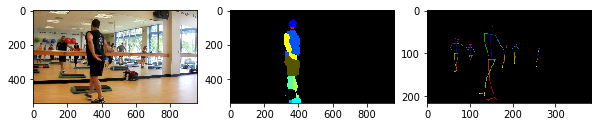

valid or not (y/n)n
335
tensor([132, 381, 100, 381,  12,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


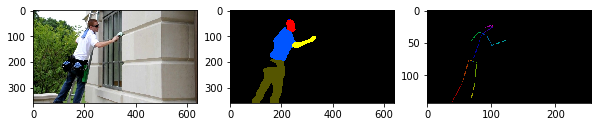

valid or not (y/n)y
336
tensor([401, 402, 403,  42,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


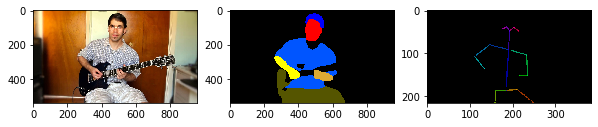

valid or not (y/n)y
337
tensor([107, 740,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


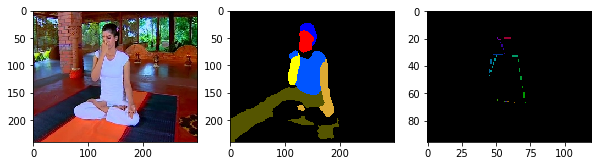

valid or not (y/n)n
338
tensor([296,  12,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


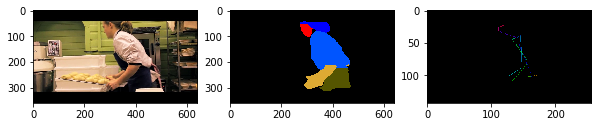

valid or not (y/n)y
339
tensor([72,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0])


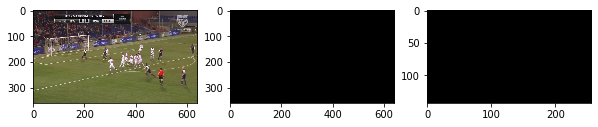

valid or not (y/n)n
340
tensor([262, 386,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


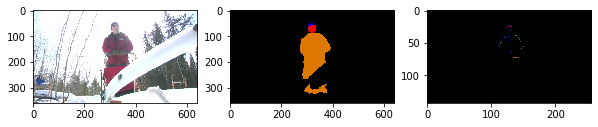

valid or not (y/n)n
341
tensor([ 11,  50, 740,  51,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


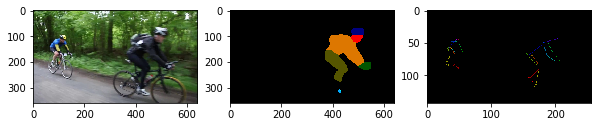

valid or not (y/n)n
342
tensor([197,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


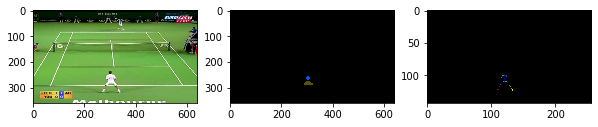

valid or not (y/n)n
343
tensor([72,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0])


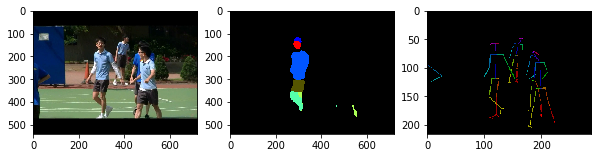

valid or not (y/n)n
344
tensor([404,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


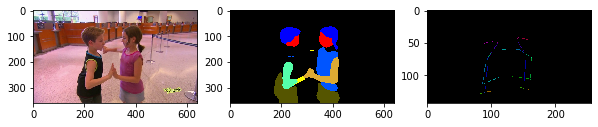

valid or not (y/n)n
345
tensor([73, 74, 12,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0])


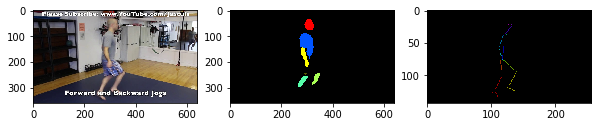

valid or not (y/n)y
346
tensor([203,   8, 207, 740, 208, 203, 405, 406, 259,  21,  65, 740,  62, 294,
        407,   0,   0])


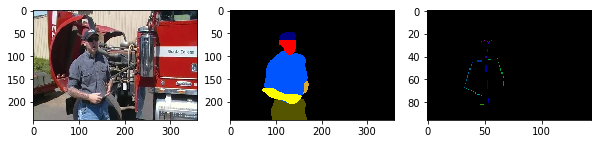

valid or not (y/n)y
347
tensor([204, 205,  16, 206,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


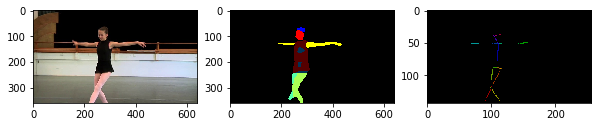

valid or not (y/n)y
348
tensor([172, 740,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


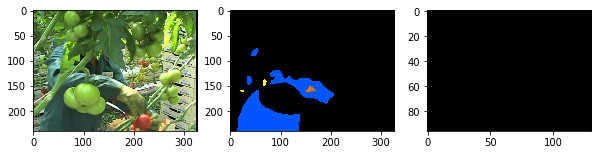

valid or not (y/n)n
349
tensor([143, 144,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


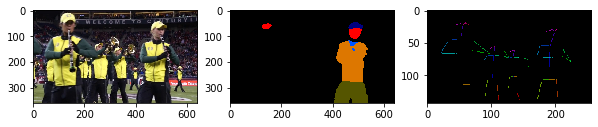

valid or not (y/n)n
350
tensor([48,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0])


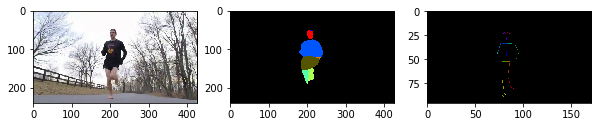

valid or not (y/n)y
351
tensor([ 69, 353,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


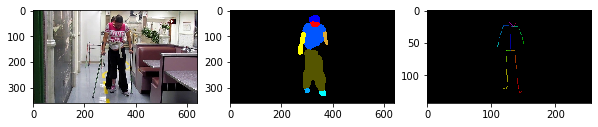

valid or not (y/n)y
352
tensor([129, 130, 400,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


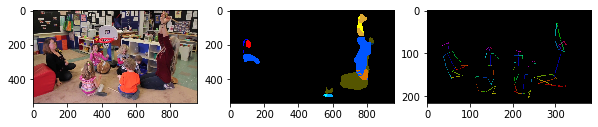

valid or not (y/n)n
353
tensor([ 29,  14, 141,  14, 142,   5,   6, 740,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


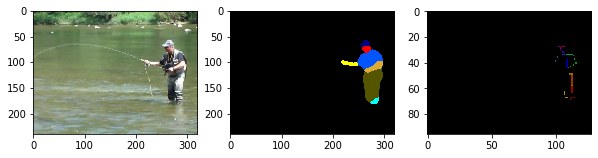

valid or not (y/n)y
354
tensor([129, 130, 131,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


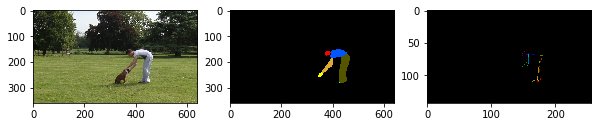

valid or not (y/n)y
355
tensor([408, 409, 228, 410, 411,  12,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


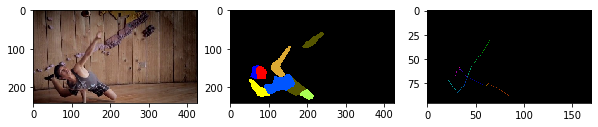

valid or not (y/n)y
356
tensor([132,  12,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


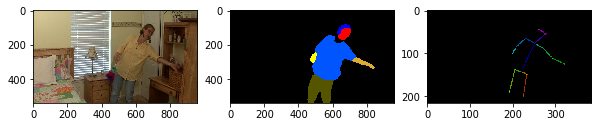

valid or not (y/n)y
357
tensor([383, 322,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


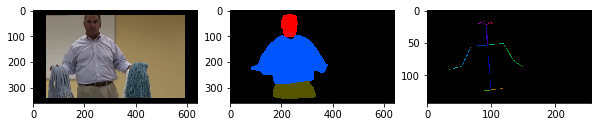

valid or not (y/n)y
358
tensor([740, 228, 165, 129, 740, 229, 740, 230, 231, 232, 740,   0,   0,   0,
          0,   0,   0])


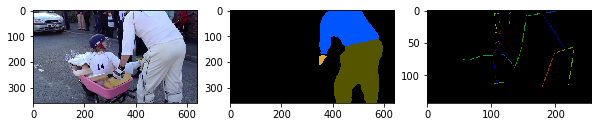

valid or not (y/n)n
359
tensor([52, 53,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0])


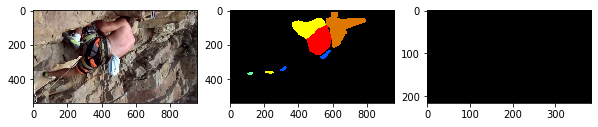

valid or not (y/n)n
360
tensor([345,  36, 740, 412,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


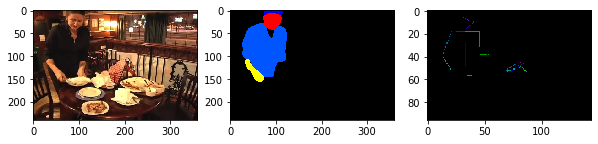

valid or not (y/n)n
361
tensor([ 42, 129, 349, 350, 351,  57,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


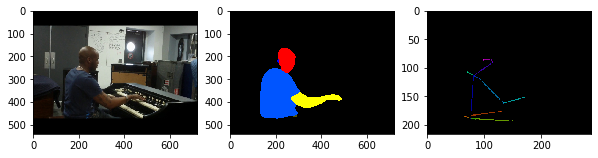

valid or not (y/n)y
362
tensor([740, 335, 130,  16, 336, 740, 154,  21,  16,  65,   0,   0,   0,   0,
          0,   0,   0])


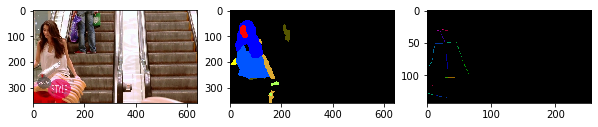

valid or not (y/n)y
363
tensor([ 21, 226,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


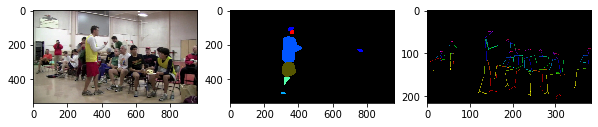

valid or not (y/n)n
364
tensor([ 53, 413,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


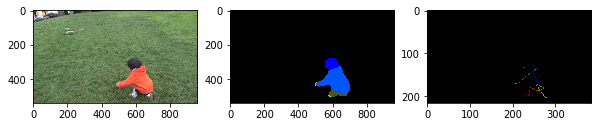

valid or not (y/n)y
365
tensor([ 24,  49,   5,   6, 740,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


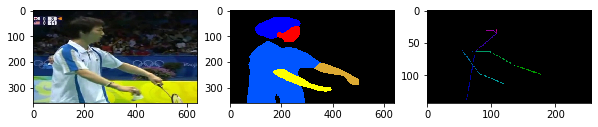

valid or not (y/n)y
366
tensor([72,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0])


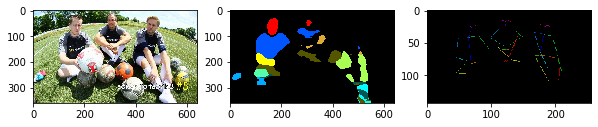

valid or not (y/n)n
367
tensor([323, 740,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


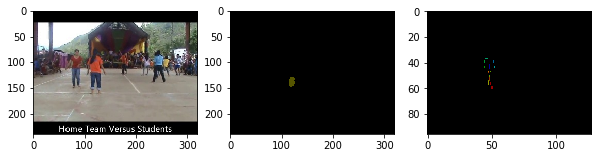

valid or not (y/n)n
368
tensor([159, 414,  12,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


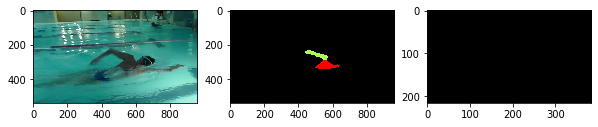

valid or not (y/n)n
369
tensor([95, 47,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0])


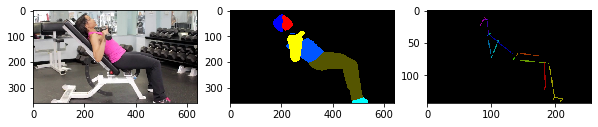

valid or not (y/n)y
370
tensor([178,  16, 271, 272,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


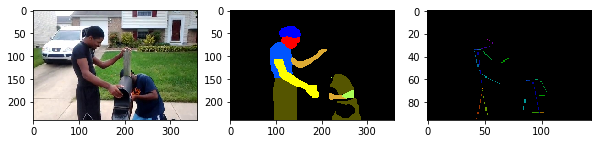

valid or not (y/n)n
371
tensor([214, 244, 245, 415, 416, 417,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


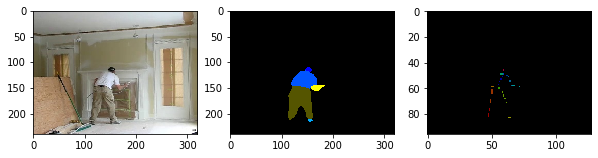

valid or not (y/n)y
372
tensor([372,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


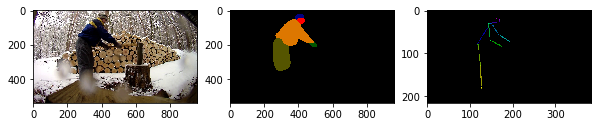

valid or not (y/n)y
373
tensor([418, 740, 419,  16, 420,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


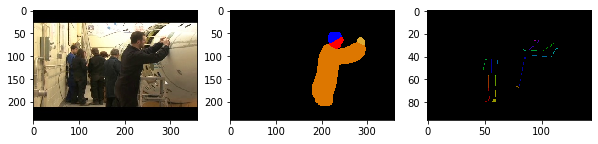

valid or not (y/n)n
374
tensor([269,  12,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


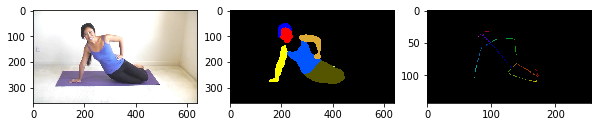

valid or not (y/n)y
375
tensor([35, 16, 36, 37,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0])


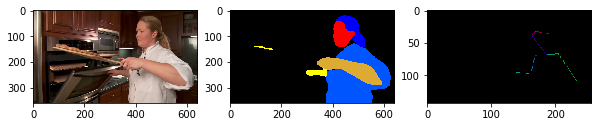

valid or not (y/n)n
376
tensor([ 29,  14, 141,  14, 142,   5,   6, 740,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


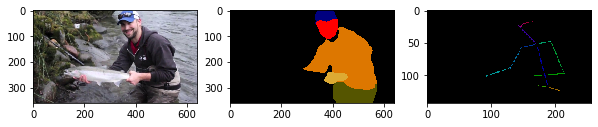

valid or not (y/n)y
377
tensor([256,  12,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


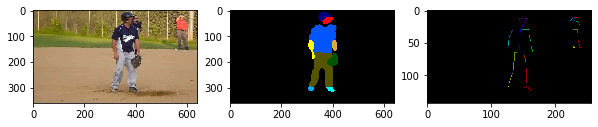

valid or not (y/n)n
378
tensor([740, 228, 165, 129, 740, 229, 740, 230, 231, 232, 740,   0,   0,   0,
          0,   0,   0])


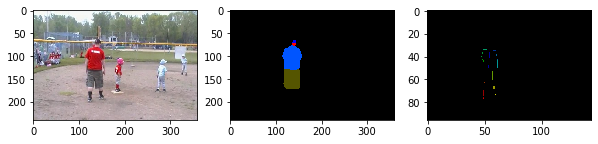

valid or not (y/n)y
379
tensor([197,  27,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


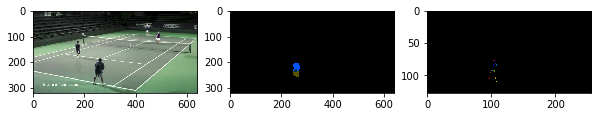

valid or not (y/n)n
380
tensor([105, 266, 267, 132, 268, 740, 740,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


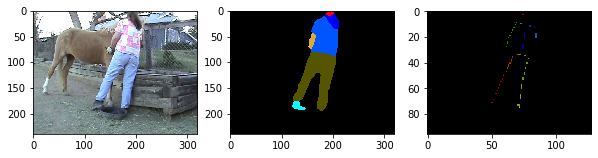

valid or not (y/n)y
381
tensor([ 48, 395,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


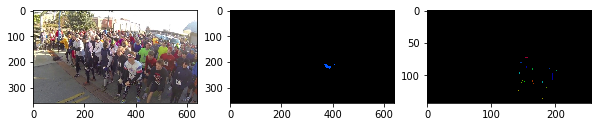

valid or not (y/n)n
382
tensor([107, 108,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


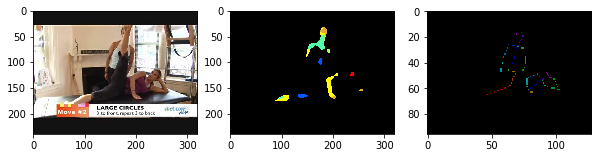

valid or not (y/n)n
383
tensor([233, 234, 740,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


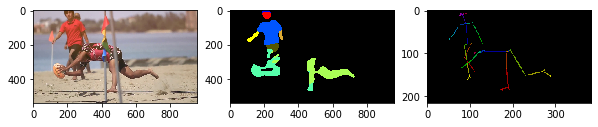

valid or not (y/n)n
384
tensor([95, 47,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0])


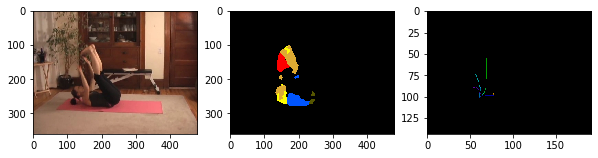

valid or not (y/n)n
385
tensor([99,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0])


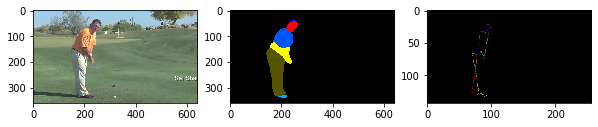

valid or not (y/n)y
386
tensor([10,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0])


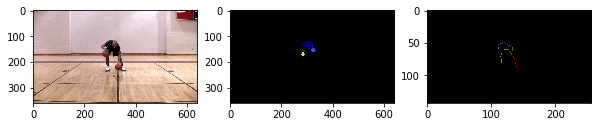

valid or not (y/n)y
387
tensor([64, 65,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0])


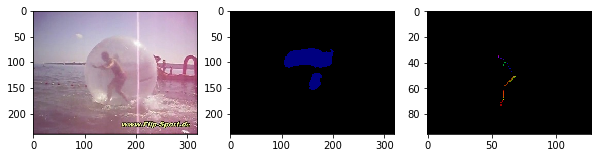

valid or not (y/n)n
388
tensor([421,  67, 130, 740, 108, 422,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


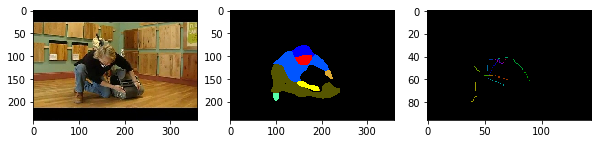

valid or not (y/n)y
389
tensor([ 11, 106,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


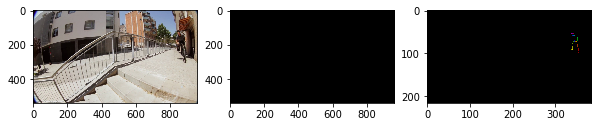

valid or not (y/n)n
390
tensor([198, 199,  65, 200, 201, 202, 203,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


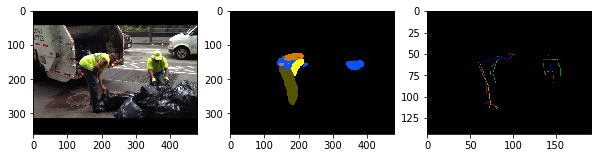

valid or not (y/n)n
391
tensor([107, 108,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


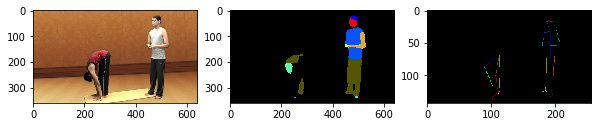

valid or not (y/n)n
392
tensor([372,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


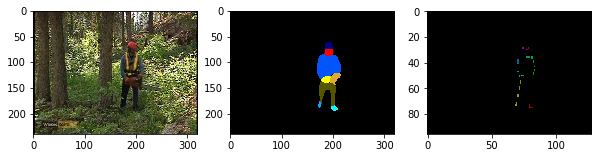

valid or not (y/n)y
393
tensor([52, 53,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0])


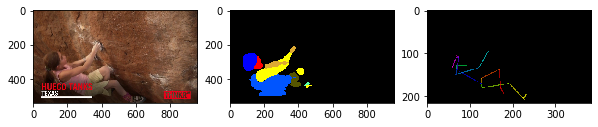

valid or not (y/n)y
394
tensor([150, 151, 423, 424,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


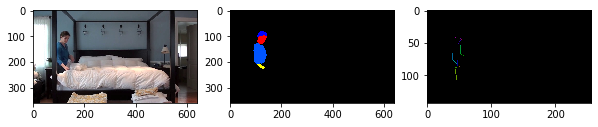

valid or not (y/n)n
395
tensor([313,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


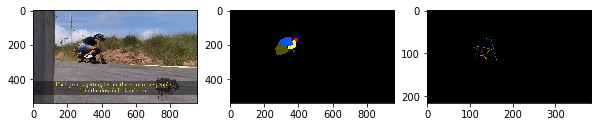

valid or not (y/n)y
396
tensor([214, 244, 245, 415, 416, 417,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


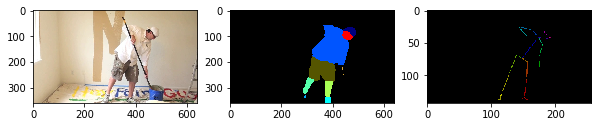

valid or not (y/n)y
397
tensor([ 65, 174, 740, 130, 175, 176,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


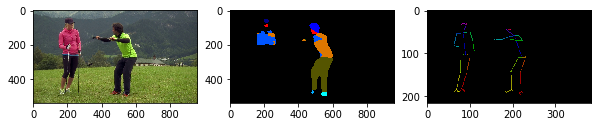

valid or not (y/n)n
398
tensor([425, 426,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


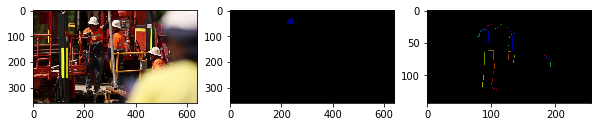

valid or not (y/n)n
399
tensor([ 75, 740,  76,  77,  78, 740,  79,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


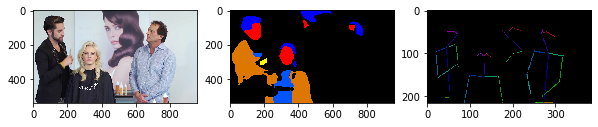

valid or not (y/n)n
400
tensor([129, 130, 400,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


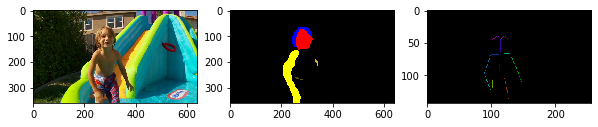

valid or not (y/n)y
401
tensor([249,  82, 250, 251, 252, 253,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


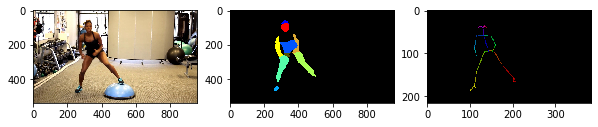

valid or not (y/n)y
402
tensor([427, 428,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


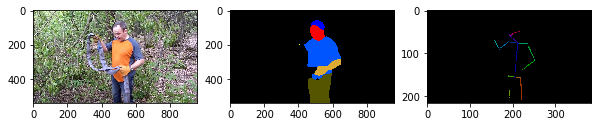

valid or not (y/n)y
403
tensor([58, 59, 60, 61, 62, 63,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0])


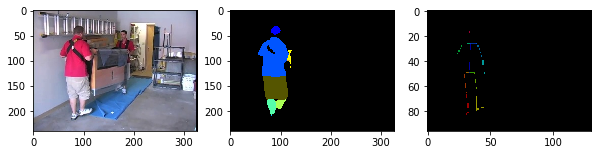

valid or not (y/n)y
404
tensor([429, 430, 130, 246, 431,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


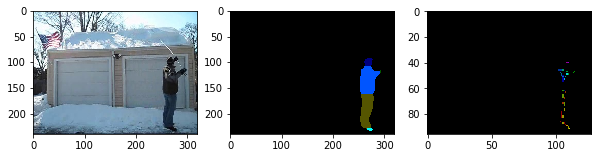

valid or not (y/n)n
405
tensor([301, 302, 303, 140,  21,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


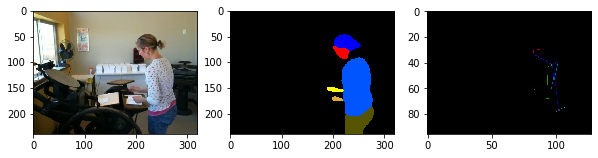

valid or not (y/n)y
406
tensor([304, 223, 283, 248, 305,   5,   6, 740,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


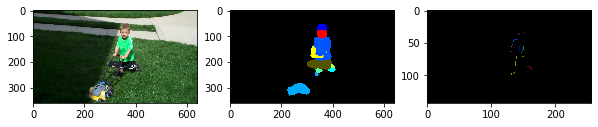

valid or not (y/n)y
407
tensor([292, 267, 373, 131,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


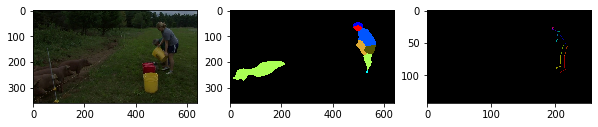

valid or not (y/n)n
408
tensor([ 42, 432, 433,  16, 107,  16, 290,  40,  82, 274,   0,   0,   0,   0,
          0,   0,   0])


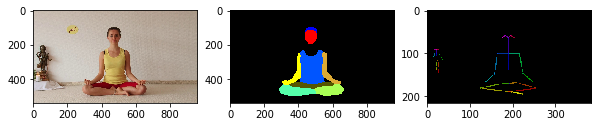

valid or not (y/n)y
409
tensor([434,   2, 126,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


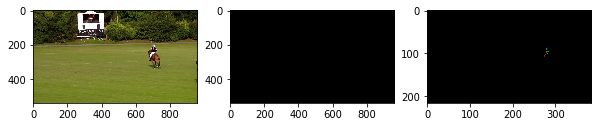

valid or not (y/n)n
410
tensor([132, 384, 385,  16, 348,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


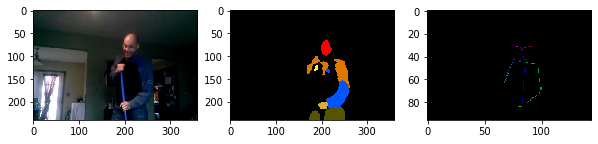

valid or not (y/n)n
411
tensor([109,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


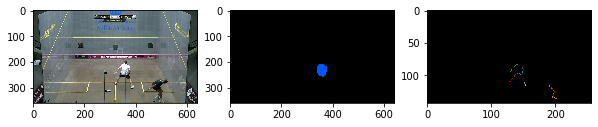

valid or not (y/n)n
412
tensor([99,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0])


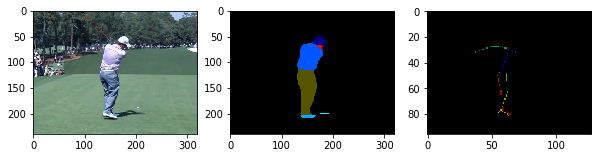

valid or not (y/n)y
413
tensor([198, 199,  65, 200, 201, 202, 203,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


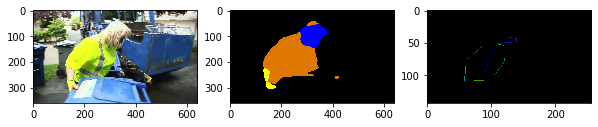

valid or not (y/n)y
414
tensor([159, 435,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


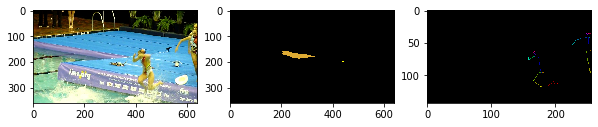

valid or not (y/n)n
415
tensor([214, 436, 134,   5,   6, 740,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


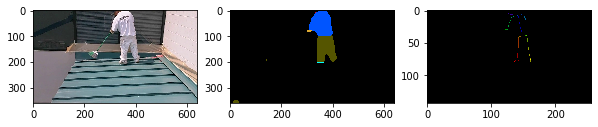

valid or not (y/n)y
416
tensor([269,  12,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


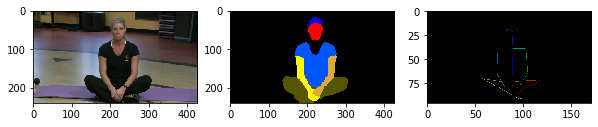

valid or not (y/n)y
417
tensor([277,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


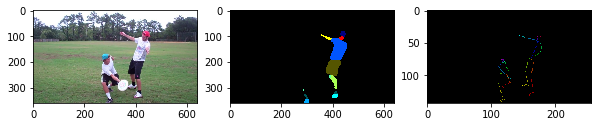

valid or not (y/n)n
418
tensor([277,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


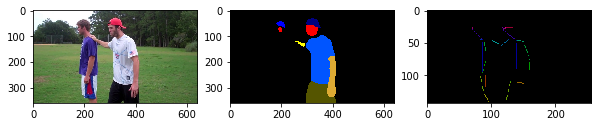

valid or not (y/n)n
419
tensor([233, 234, 740,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


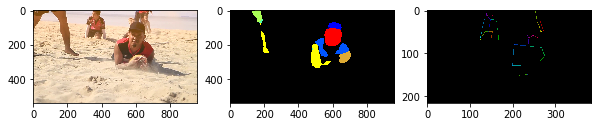

valid or not (y/n)n
420
tensor([114,  16, 115, 116, 740, 117, 118, 119, 120, 121, 122, 740, 123, 124,
        125,   0,   0])


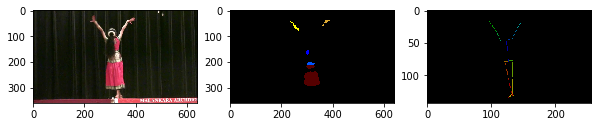

valid or not (y/n)y
421
tensor([ 29,  14, 141,  14, 142,   5,   6, 740,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


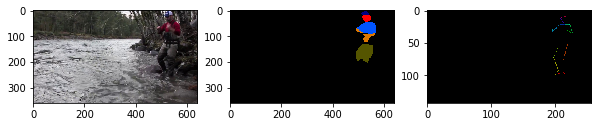

valid or not (y/n)y
422
tensor([299,   5,   6, 740,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


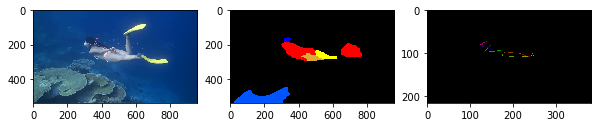

valid or not (y/n)n
423
tensor([41, 42,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0])


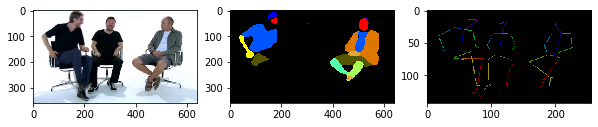

valid or not (y/n)y
424
tensor([10,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0])


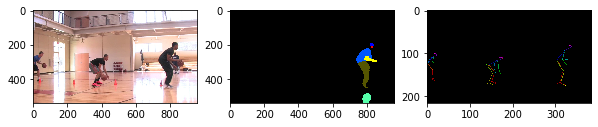

valid or not (y/n)n
425
tensor([133,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


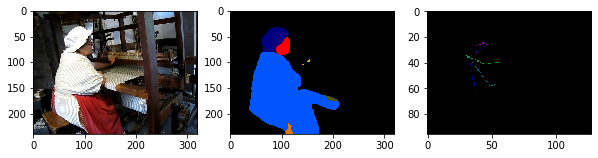

valid or not (y/n)n
426
tensor([227,  12,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


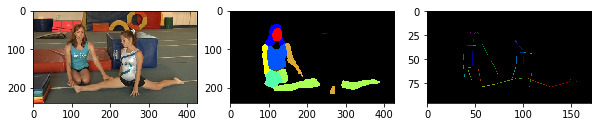

valid or not (y/n)n
427
tensor([103, 315,  16, 316, 317,  16,  59,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


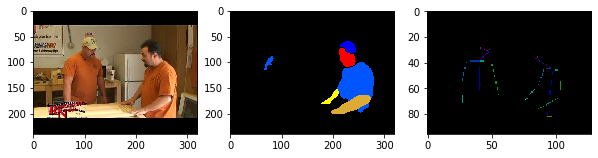

valid or not (y/n)n
428
tensor([437,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


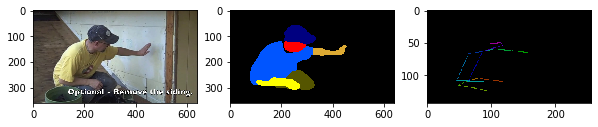

valid or not (y/n)y
429
tensor([438,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


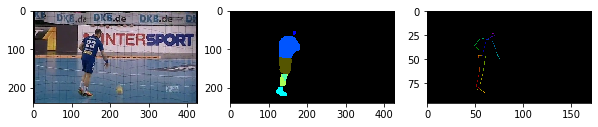

valid or not (y/n)y
430
tensor([114,  16, 115, 116, 740, 117, 118, 119, 120, 121, 122, 740, 123, 124,
        125,   0,   0])


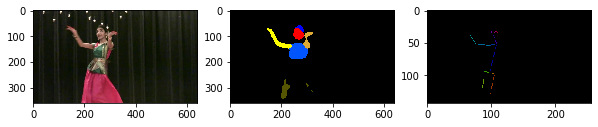

valid or not (y/n)y
431
tensor([263,  12,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


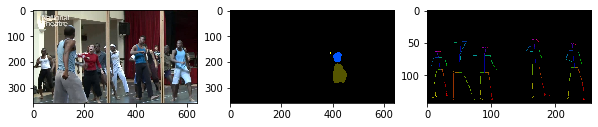

valid or not (y/n)n
432
tensor([439, 440,  82,  12,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


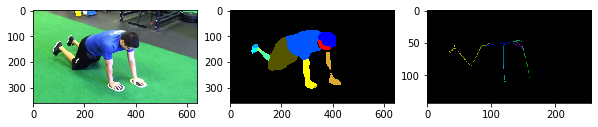

valid or not (y/n)y
433
tensor([384, 441, 442,  16, 436, 740, 245,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


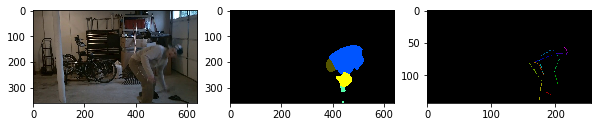

valid or not (y/n)y
434
tensor([143, 144,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


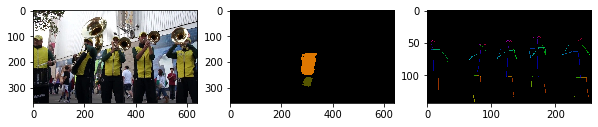

valid or not (y/n)n
435
tensor([443, 444,  21,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


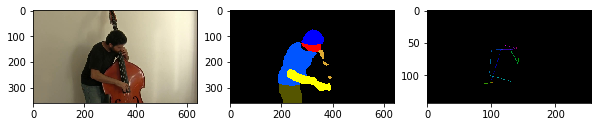

valid or not (y/n)y
436
tensor([445,  42,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


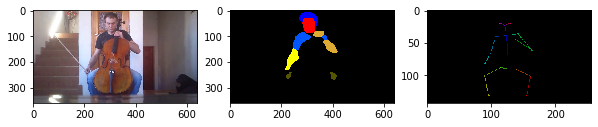

valid or not (y/n)y
437
tensor([ 65, 261, 262,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


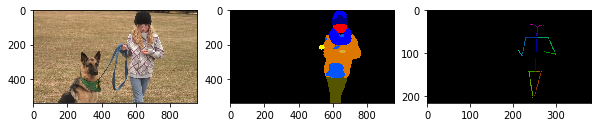

valid or not (y/n)y
438
tensor([ 62, 207,  16, 258, 184,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


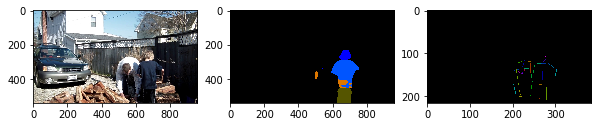

valid or not (y/n)n
439
tensor([327,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


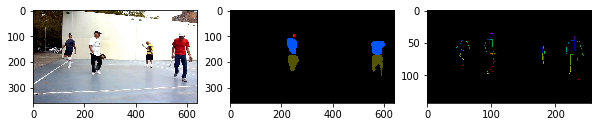

valid or not (y/n)n
440
tensor([35, 16, 36, 37,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0])


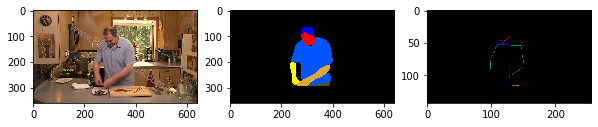

valid or not (y/n)y
441
tensor([72,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0])


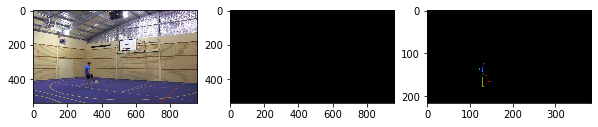

valid or not (y/n)n
442
tensor([446, 447, 448, 449, 450,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


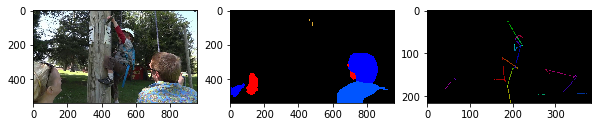

valid or not (y/n)n
443
tensor([361, 451,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


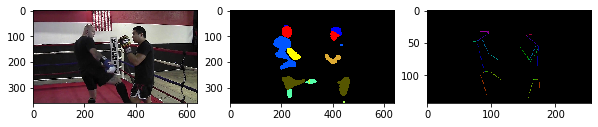

valid or not (y/n)n
444
tensor([345,  36, 740, 412,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


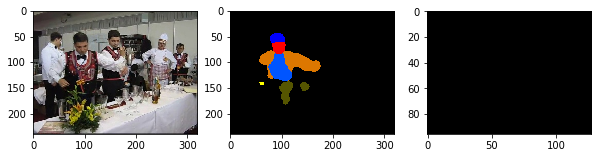

valid or not (y/n)n
445
tensor([273,  12,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


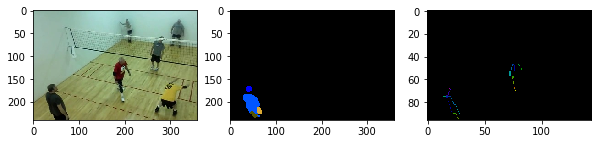

valid or not (y/n)n
446
tensor([204, 205,  16, 206,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


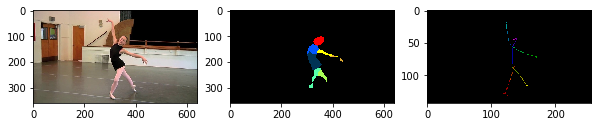

valid or not (y/n)y
447
tensor([192, 193,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


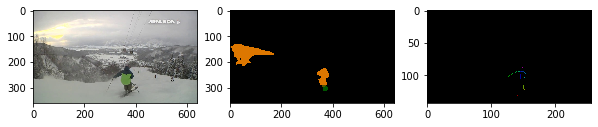

valid or not (y/n)n
448
tensor([337, 338, 452, 453,   2, 454, 740, 455, 456, 406, 457, 458, 459,   0,
          0,   0,   0])


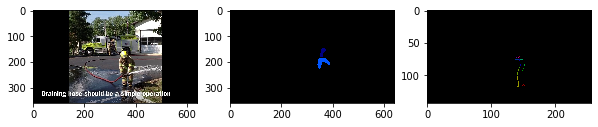

valid or not (y/n)n
449
tensor([354, 355, 214,  21,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


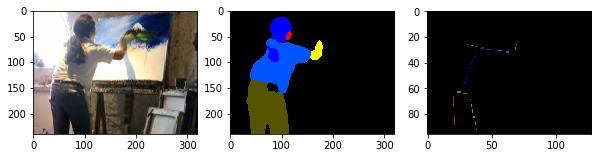

valid or not (y/n)y
450
tensor([10,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0])


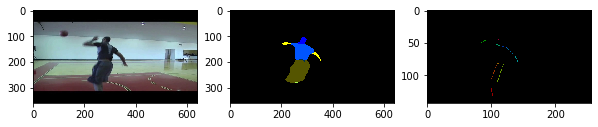

valid or not (y/n)y
451
tensor([740,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


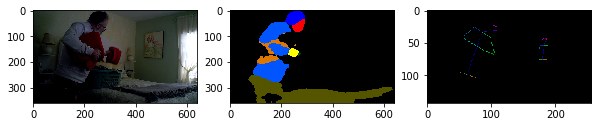

valid or not (y/n)n
452
tensor([327,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


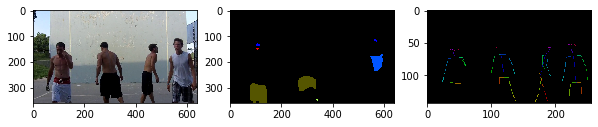

valid or not (y/n)n
453
tensor([55, 12,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0])


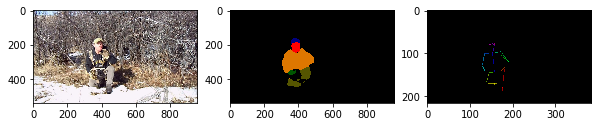

valid or not (y/n)y
454
tensor([740, 297, 298, 299,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


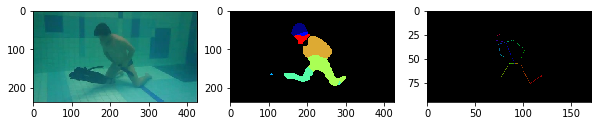

valid or not (y/n)y
455
tensor([460, 461,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


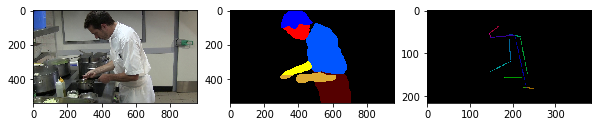

valid or not (y/n)y
456
tensor([ 75, 740,  76,  77,  78, 740,  79,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


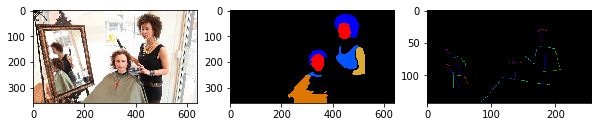

valid or not (y/n)n
457
tensor([740, 228, 165, 129, 740, 229, 740, 230, 231, 232, 740,   0,   0,   0,
          0,   0,   0])


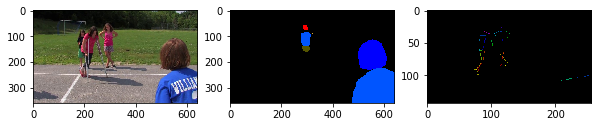

valid or not (y/n)n
458
tensor([462, 358,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


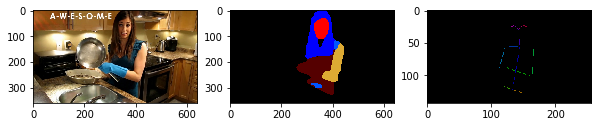

valid or not (y/n)y
459
tensor([279,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


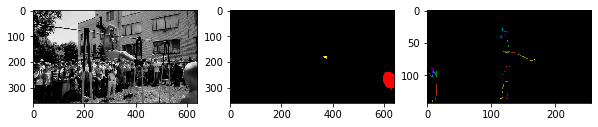

valid or not (y/n)n
460
tensor([215, 216,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


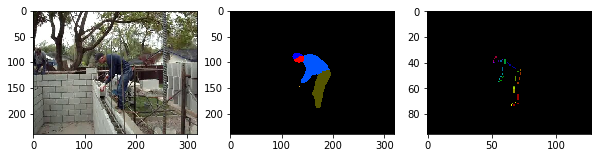

valid or not (y/n)y
461
tensor([463,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


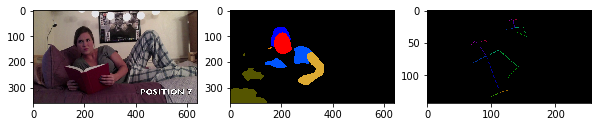

valid or not (y/n)n
462
tensor([150, 151, 423, 424,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


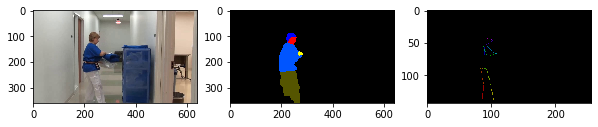

valid or not (y/n)y
463
tensor([462, 358,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


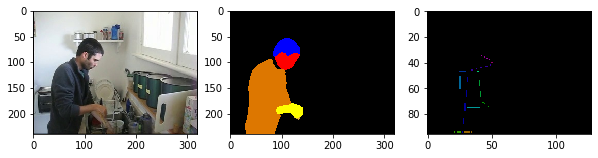

valid or not (y/n)y
464
tensor([267,  60, 131,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


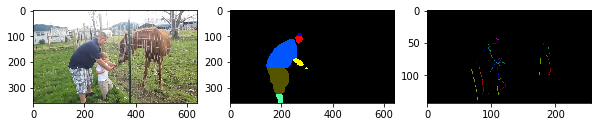

valid or not (y/n)n
465
tensor([345,  36, 740, 412,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


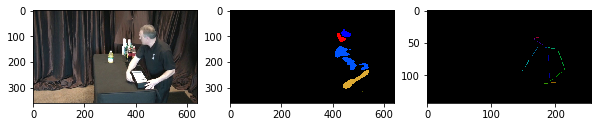

valid or not (y/n)n
466
tensor([356, 357,  12, 740,  35, 100, 358, 132, 112,  39,  40,   0,   0,   0,
          0,   0,   0])


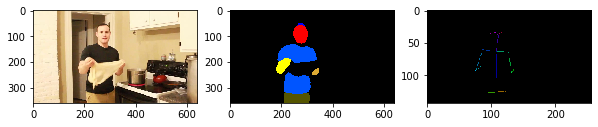

valid or not (y/n)y
467
tensor([46, 47,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0])


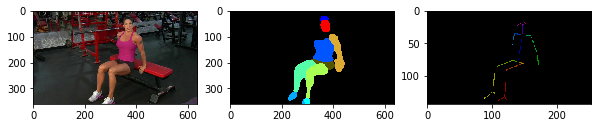

valid or not (y/n)y
468
tensor([ 21, 181, 740, 182, 213, 214, 183, 185,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


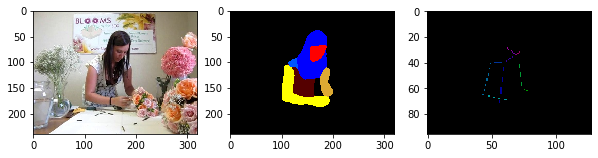

valid or not (y/n)y
469
tensor([323, 324,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


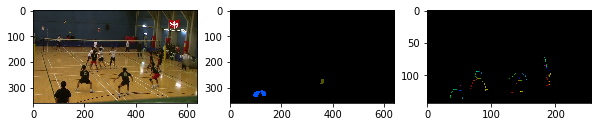

valid or not (y/n)n
470
tensor([192, 193,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


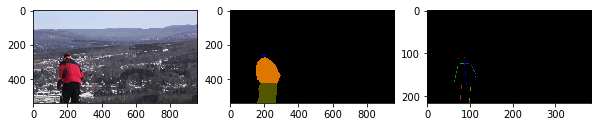

valid or not (y/n)y
471
tensor([238, 464,  49,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


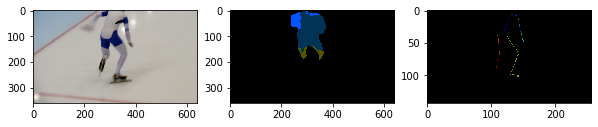

valid or not (y/n)y
472
tensor([73, 74, 12,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0])


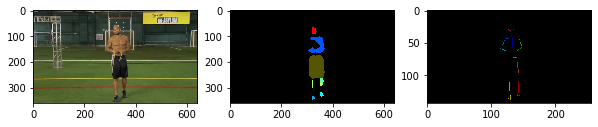

valid or not (y/n)y
473
tensor([103,  12,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


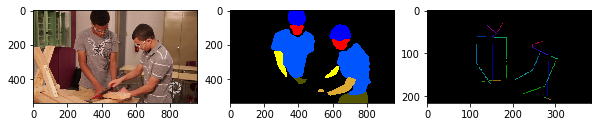

valid or not (y/n)n
474
tensor([103, 134, 465, 466,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


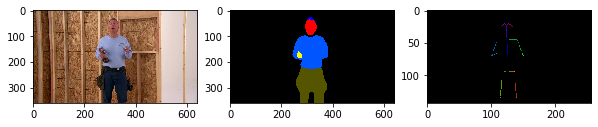

valid or not (y/n)y
475
tensor([296,  12,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


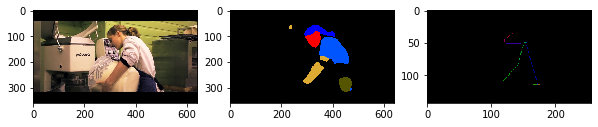

valid or not (y/n)y
476
tensor([740, 740, 374, 375, 740,  44,  12,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


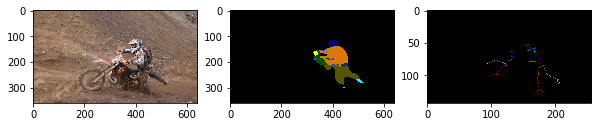

valid or not (y/n)n
477
tensor([467, 468,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


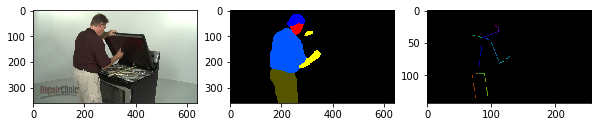

valid or not (y/n)y
478
tensor([100, 306, 214, 306,  39,  40,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


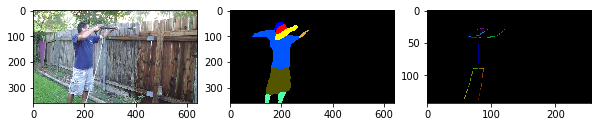

valid or not (y/n)y
479
tensor([103, 134, 465, 466,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


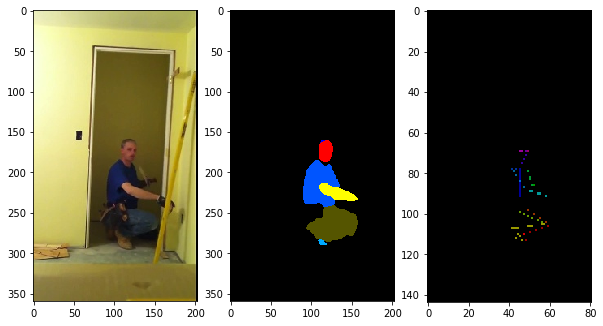

valid or not (y/n)y
480
tensor([469,  20,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


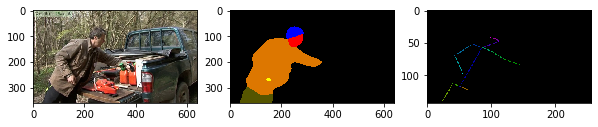

valid or not (y/n)y
481
tensor([256,  12,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


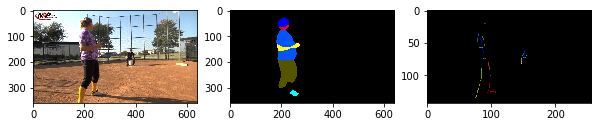

valid or not (y/n)n
482
tensor([249,  82, 250, 251, 252, 253,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


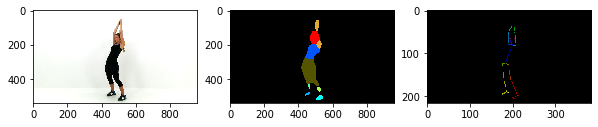

valid or not (y/n)y
483
tensor([421,  67, 130, 740, 108, 422,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


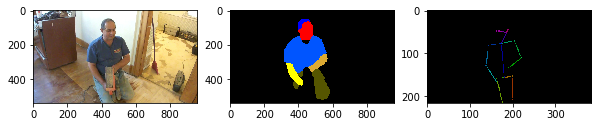

valid or not (y/n)y
484
tensor([269,  12,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


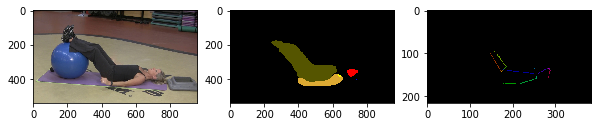

valid or not (y/n)y
485
tensor([470,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


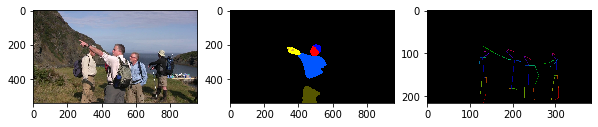

valid or not (y/n)n
486
tensor([ 42, 351, 740, 471, 472, 473,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


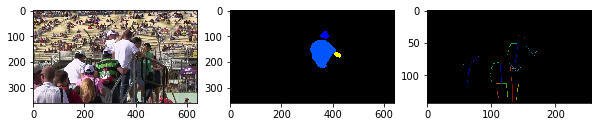

valid or not (y/n)n
487
tensor([470,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


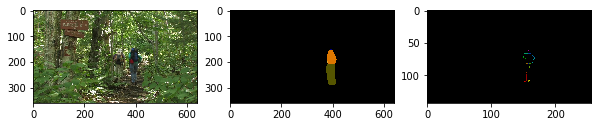

valid or not (y/n)n
488
tensor([29, 12,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0])


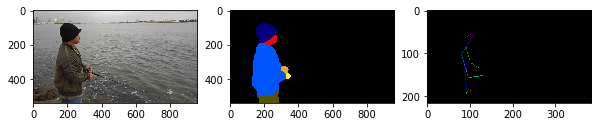

valid or not (y/n)y
489
tensor([ 24,  25,  26, 740,  27,  12,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


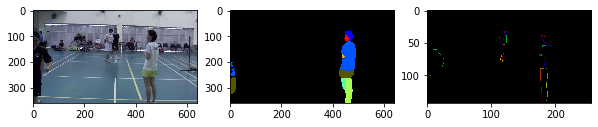

valid or not (y/n)n
490
tensor([103,  12,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


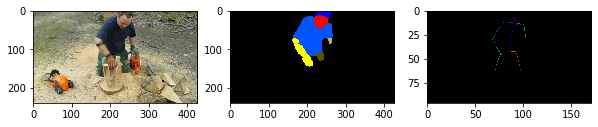

valid or not (y/n)y
491
tensor([10,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0])


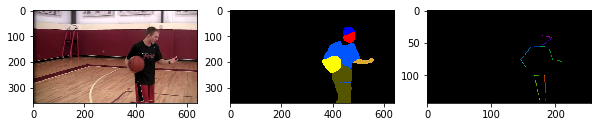

valid or not (y/n)y
492
tensor([ 21, 181, 740, 182, 213, 214, 183, 185,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


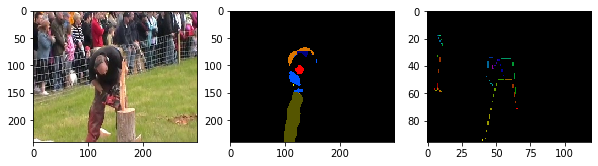

valid or not (y/n)n
493
tensor([88, 89, 90, 91, 12,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0])


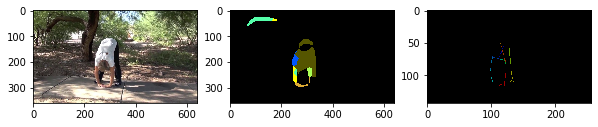

valid or not (y/n)n
494
tensor([ 48, 340, 341,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


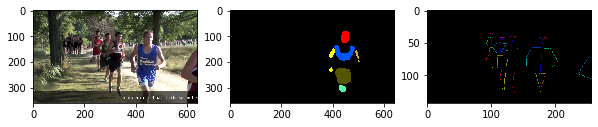

valid or not (y/n)n
495
tensor([263, 264,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


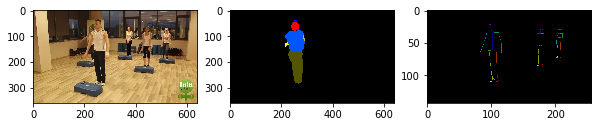

valid or not (y/n)n
496
tensor([197,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


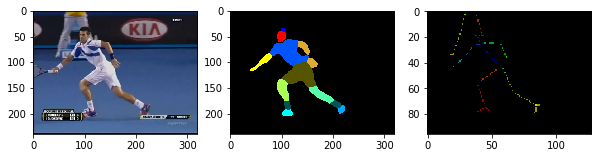

valid or not (y/n)y
497
tensor([345,  36, 740, 412,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


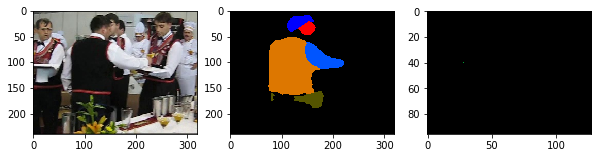

valid or not (y/n)n
498
tensor([396, 184,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


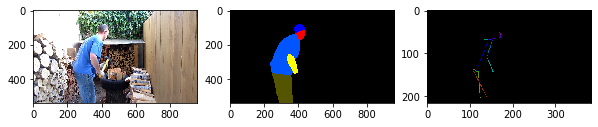

valid or not (y/n)y
499
tensor([416, 740, 214, 474,  16, 475,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


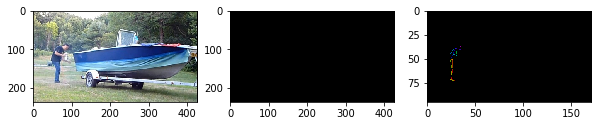

valid or not (y/n)n
500
tensor([ 11, 291,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


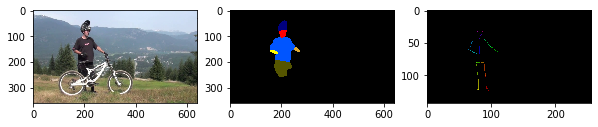

valid or not (y/n)y
501
tensor([ 11,  50, 740,  51,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


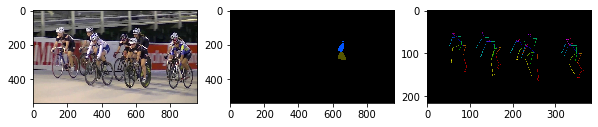

valid or not (y/n)n
502
tensor([105, 266, 267, 132, 268, 740, 740,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


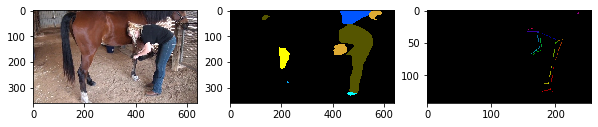

valid or not (y/n)n
503
tensor([198, 199,  65, 200, 201, 202, 203,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


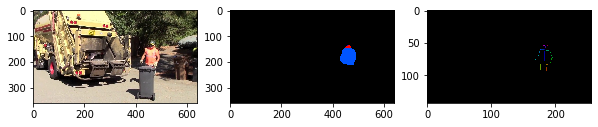

valid or not (y/n)n
504
tensor([476, 477, 478, 479,  65,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


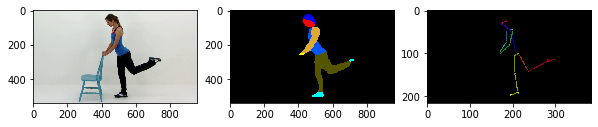

valid or not (y/n)y
505
tensor([215, 216,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


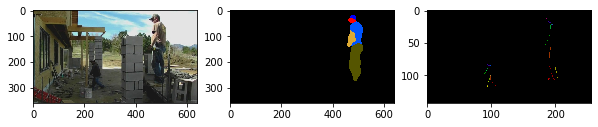

valid or not (y/n)n
506
tensor([29, 12,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0])


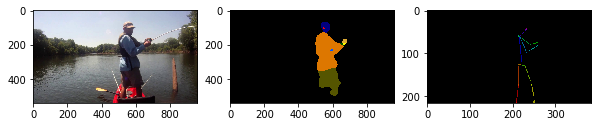

valid or not (y/n)y
507
tensor([211, 212,  21,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


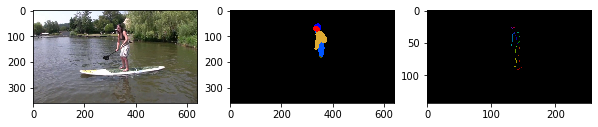

valid or not (y/n)y
508
tensor([240, 288, 325, 326,  39,  40,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


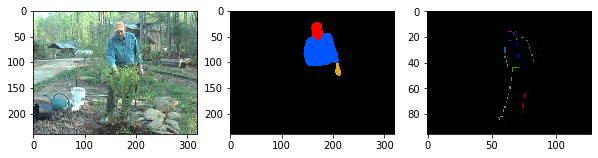

valid or not (y/n)y
509
tensor([312,  42,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


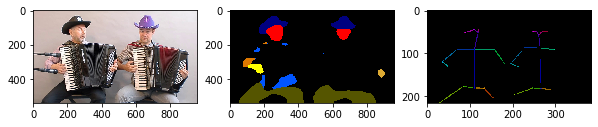

valid or not (y/n)n
510
tensor([327,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


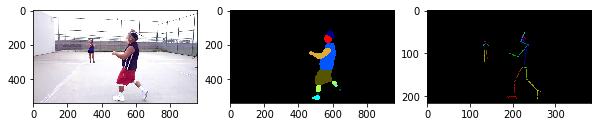

valid or not (y/n)y
511
tensor([240, 288, 325, 326,  39,  40,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


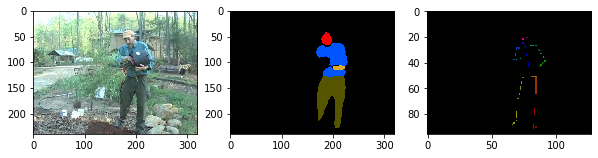

valid or not (y/n)y
512
tensor([ 55, 480,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


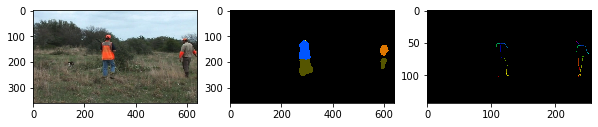

valid or not (y/n)n
513
tensor([292, 481, 240, 482, 483, 484,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


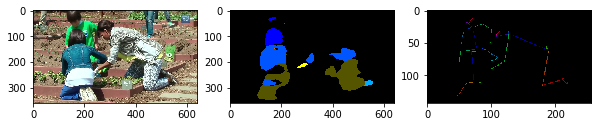

valid or not (y/n)n
514
tensor([292, 320, 485,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


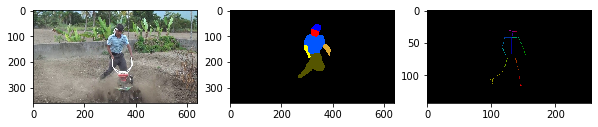

valid or not (y/n)y
515
tensor([240,  20,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


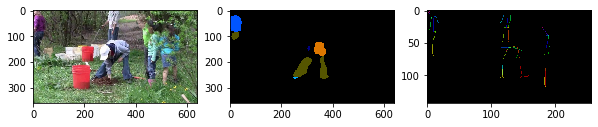

valid or not (y/n)n
516
tensor([ 48, 340, 341,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


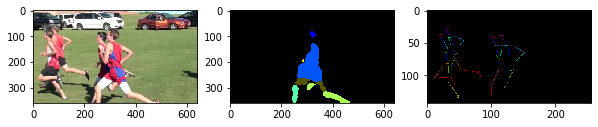

valid or not (y/n)n
517
tensor([ 62, 207,  16, 258, 184,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


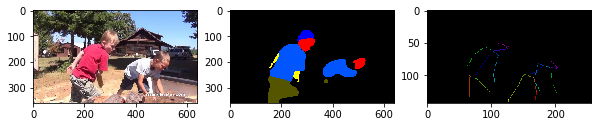

valid or not (y/n)n
518
tensor([486, 234, 487,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


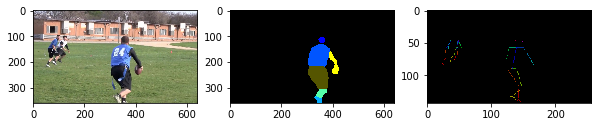

valid or not (y/n)n
519
tensor([ 11, 106,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


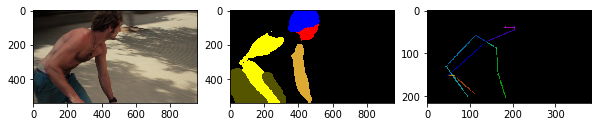

valid or not (y/n)y
520
tensor([460, 461,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


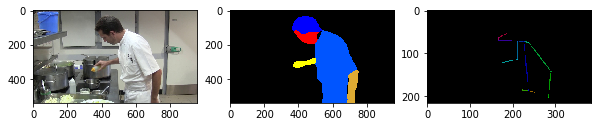

valid or not (y/n)y
521
tensor([129, 130, 400,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


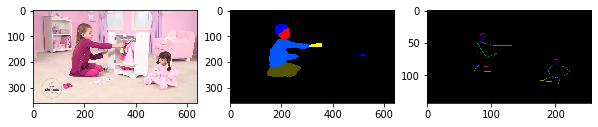

valid or not (y/n)n
522
tensor([323, 324,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


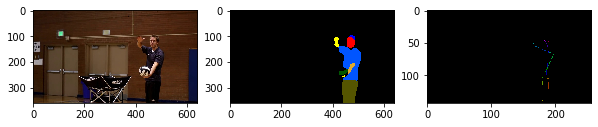

valid or not (y/n)y
523
tensor([172, 740,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


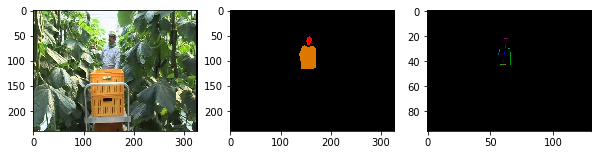

valid or not (y/n)n
524
tensor([211, 328,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


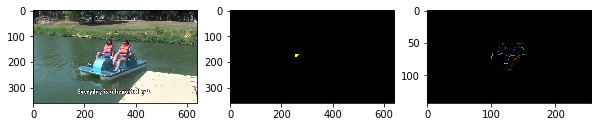

valid or not (y/n)n
525
tensor([103, 488, 489,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


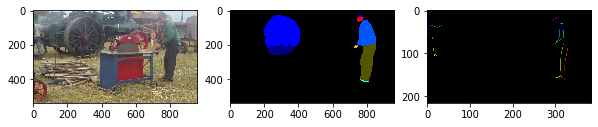

valid or not (y/n)n
526
tensor([ 42, 129, 490, 249,  98, 179,  98,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


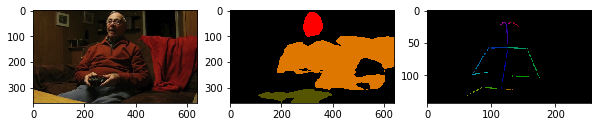

valid or not (y/n)n
527
tensor([48,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0])


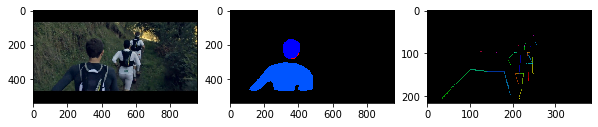

valid or not (y/n)n
528
tensor([198, 199,  65, 200, 201, 202, 203,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


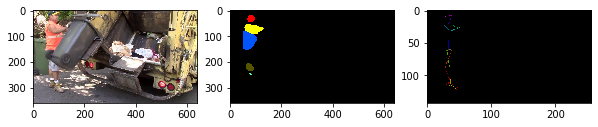

valid or not (y/n)n
529
tensor([491,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


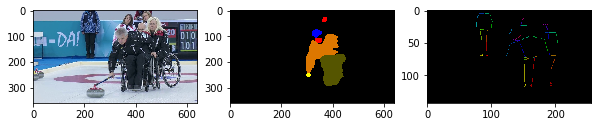

valid or not (y/n)n
530
tensor([10,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0])


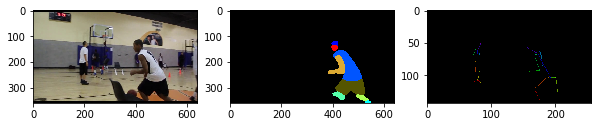

valid or not (y/n)n
531
tensor([249,  82, 250, 251, 252, 253,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


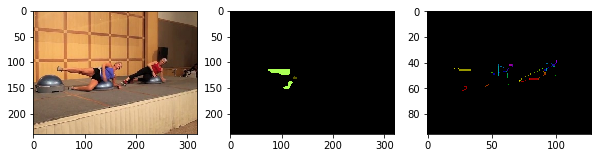

valid or not (y/n)n
532
tensor([254, 255,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


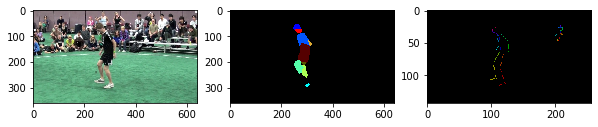

valid or not (y/n)n
533
tensor([269,  12,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


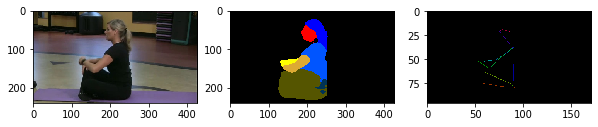

valid or not (y/n)y
534
tensor([132, 384, 385,  16, 348,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


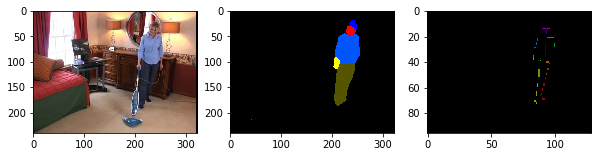

valid or not (y/n)y
535
tensor([330,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


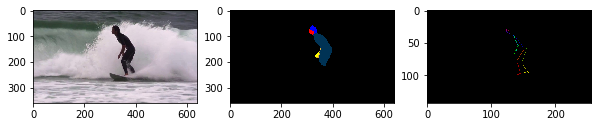

valid or not (y/n)y
536
tensor([38, 12, 39, 40,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0])


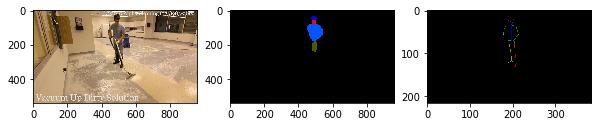

valid or not (y/n)y
537
tensor([ 11, 291,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


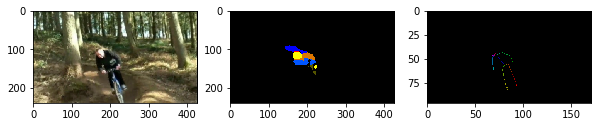

valid or not (y/n)y
538
tensor([29, 12,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0])


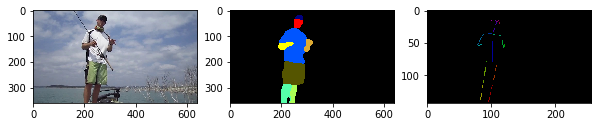

valid or not (y/n)y
539
tensor([192, 193,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


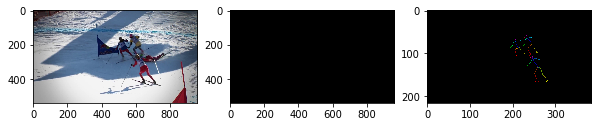

valid or not (y/n)n
540
tensor([304, 223, 283, 248, 305,   5,   6, 740,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


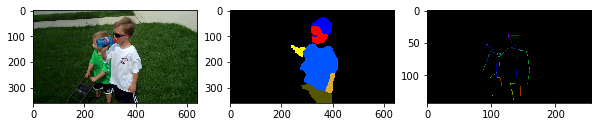

valid or not (y/n)n
541
tensor([103, 134, 465, 466,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


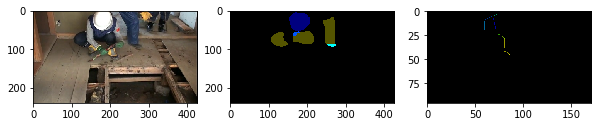

valid or not (y/n)n
542
tensor([133,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


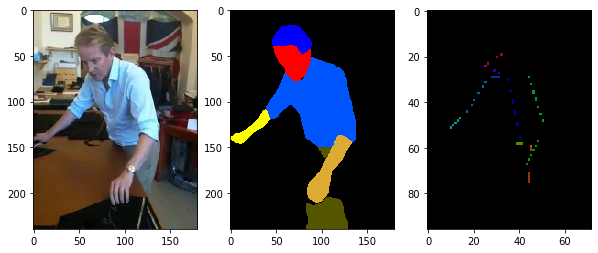

valid or not (y/n)y
543
tensor([240,  20,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


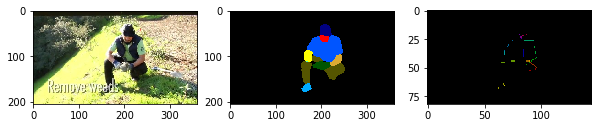

valid or not (y/n)y
544
tensor([300, 295,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


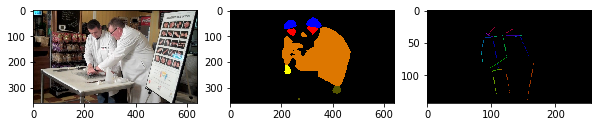

valid or not (y/n)n
545
tensor([35, 16, 36, 37,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0])


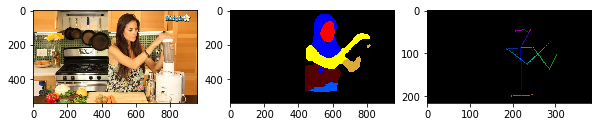

valid or not (y/n)y
546
tensor([399, 740,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


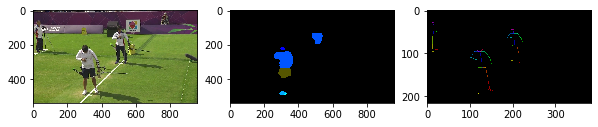

valid or not (y/n)n
547
tensor([52, 53,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0])


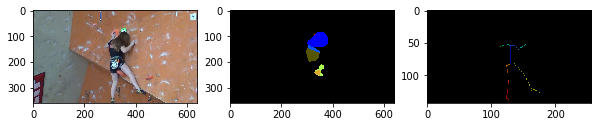

valid or not (y/n)y
548
tensor([740, 335, 130,  16, 336, 740, 154,  21,  16,  65,   0,   0,   0,   0,
          0,   0,   0])


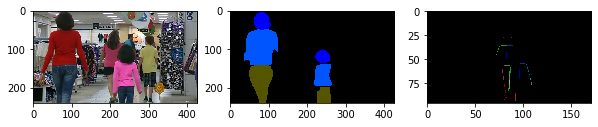

valid or not (y/n)n
549
tensor([214, 436, 134,   5,   6, 740,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


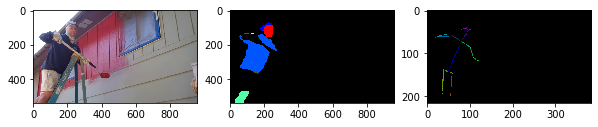

valid or not (y/n)y
550
tensor([740,  43,  13,  14, 740,  44,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


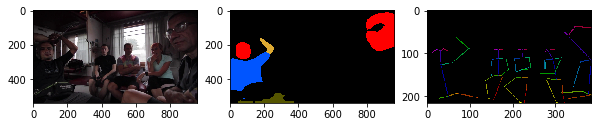

valid or not (y/n)n
551
tensor([52, 53,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0])


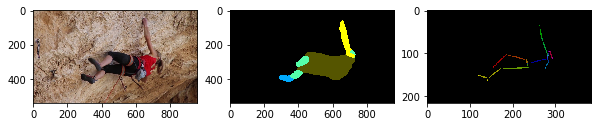

valid or not (y/n)y
552
tensor([263, 264,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


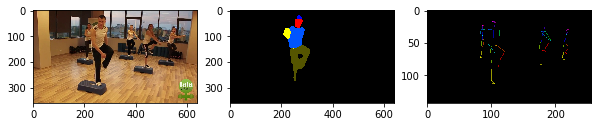

valid or not (y/n)n
553
tensor([254, 255,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


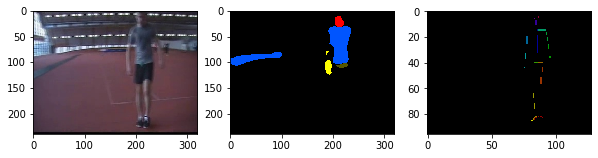

valid or not (y/n)n
554
tensor([147, 148, 149, 150, 151, 132, 152, 153, 154,   0,   0,   0,   0,   0,
          0,   0,   0])


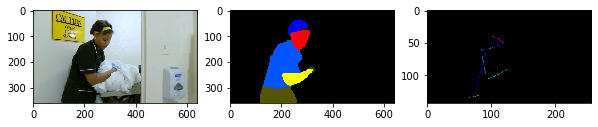

valid or not (y/n)y
555
tensor([173, 135,  12,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


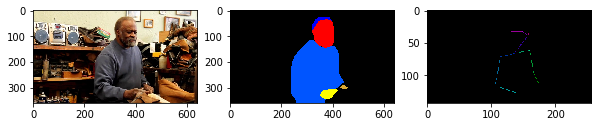

valid or not (y/n)y
556
tensor([396, 184,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


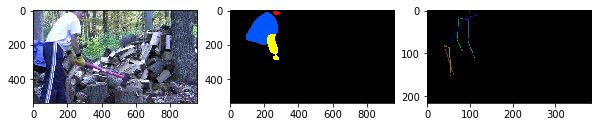

valid or not (y/n)y
557
tensor([346,  16, 347, 348,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


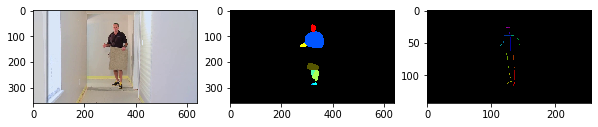

valid or not (y/n)y
558
tensor([132,  12,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


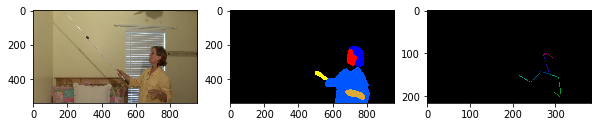

valid or not (y/n)y
559
tensor([396, 184,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


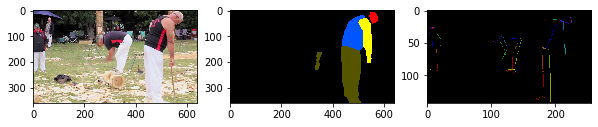

valid or not (y/n)n
560
tensor([256,  12,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


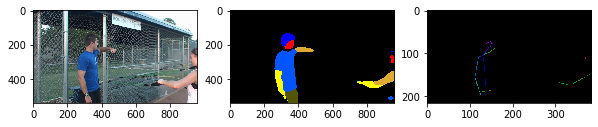

valid or not (y/n)n
561
tensor([ 42, 492, 290,  40,  12, 493, 130,  56, 494, 740,  96, 351, 740, 495,
        496,   0,   0])


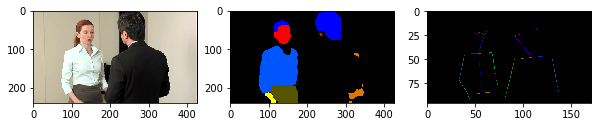

valid or not (y/n)n
562
tensor([343, 344,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


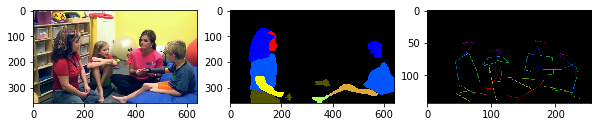

valid or not (y/n)n
563
tensor([ 11, 291,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


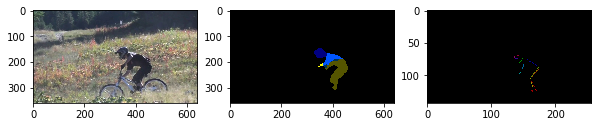

valid or not (y/n)y
564
tensor([58, 59, 60, 61, 62, 63,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0])


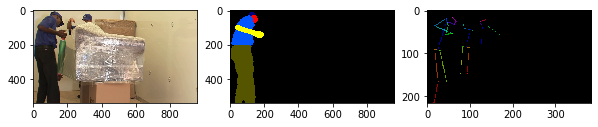

valid or not (y/n)n
565
tensor([249,  82, 250, 251, 252, 253,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


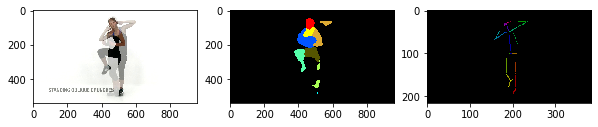

valid or not (y/n)y
566
tensor([256,  12,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


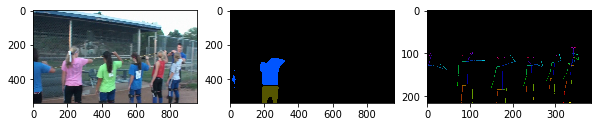

valid or not (y/n)n
567
tensor([327,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


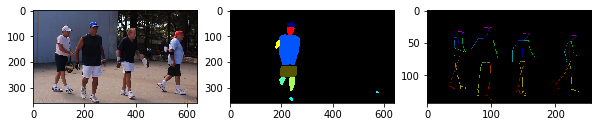

valid or not (y/n)n
568
tensor([65, 12,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0])


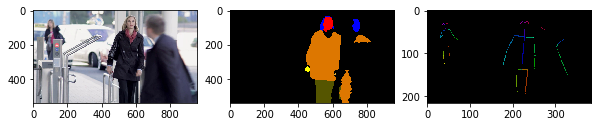

valid or not (y/n)n
569
tensor([11, 83,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0])


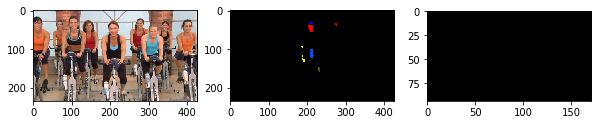

valid or not (y/n)n
570
tensor([ 11, 291,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


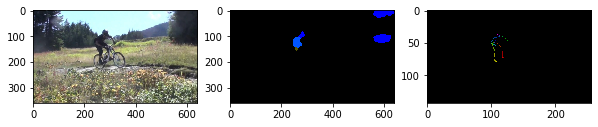

valid or not (y/n)n
571
tensor([73, 74, 12,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0])


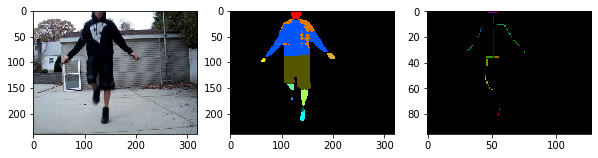

valid or not (y/n)y
572
tensor([296,  12,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


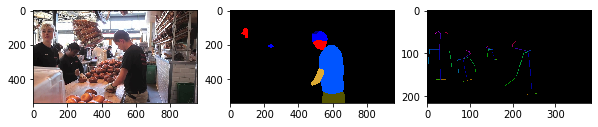

valid or not (y/n)n
573
tensor([100, 740, 101, 102,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


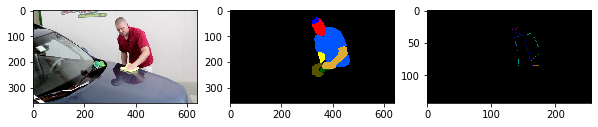

valid or not (y/n)y
574
tensor([  1,   2,   3,   4,   5,   6, 740,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


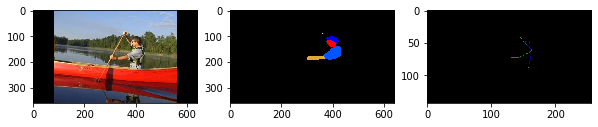

valid or not (y/n)n
575
tensor([279,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


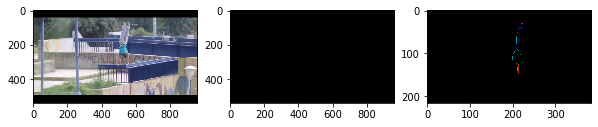

valid or not (y/n)n
576
tensor([740, 497, 130, 400,  39,  86, 476, 498,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


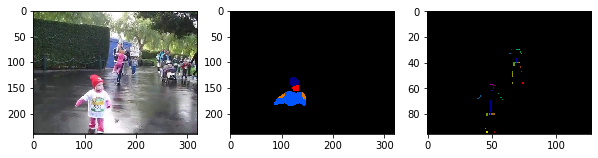

valid or not (y/n)n
577
tensor([114,  16, 115, 116, 740, 117, 118, 119, 120, 121, 122, 740, 123, 124,
        125,   0,   0])


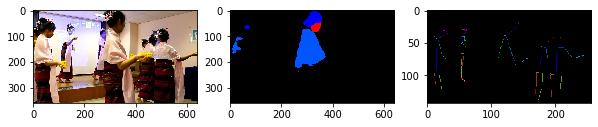

valid or not (y/n)n
578
tensor([437,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


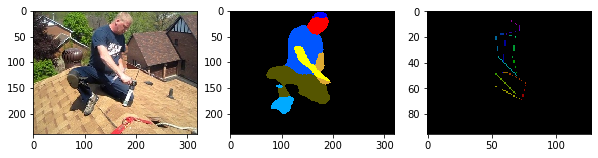

valid or not (y/n)y
579
tensor([499,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


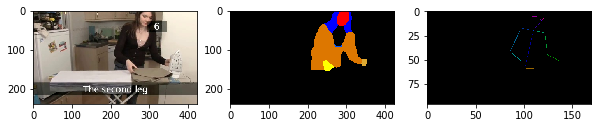

valid or not (y/n)y
580
tensor([298, 500,  16, 501,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


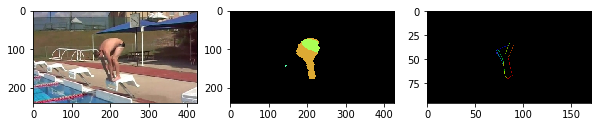

valid or not (y/n)y
581
tensor([502,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


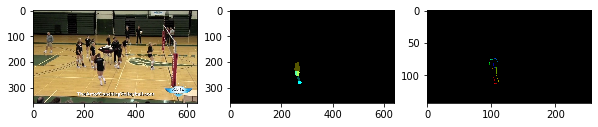

valid or not (y/n)n
582
tensor([192, 193,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


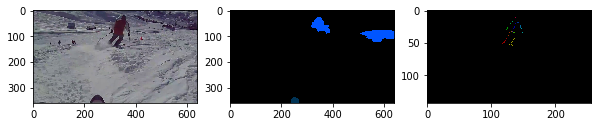

valid or not (y/n)n
583
tensor([103, 436, 245, 503, 740, 306,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


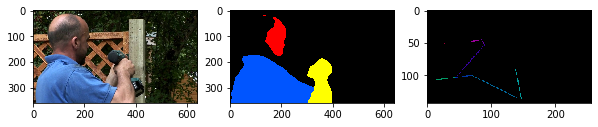

valid or not (y/n)n
584
tensor([404,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


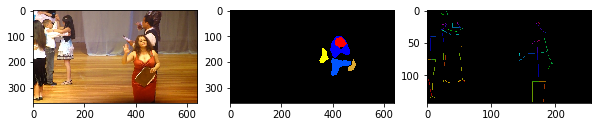

valid or not (y/n)n
585
tensor([256,  12,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


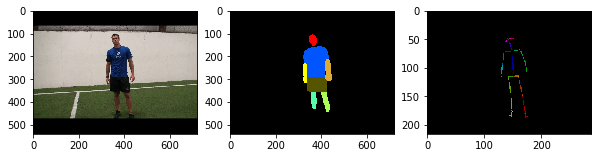

valid or not (y/n)y
586
tensor([345,  36, 740, 412,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


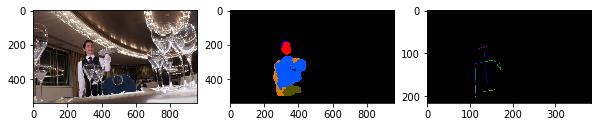

valid or not (y/n)y
587
tensor([740,  43,  13,  14, 740,  44,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


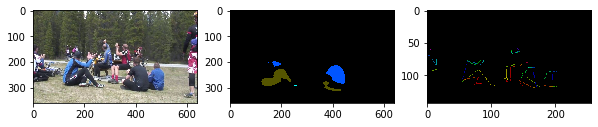

valid or not (y/n)n
588
tensor([110,  12,  39,  40,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


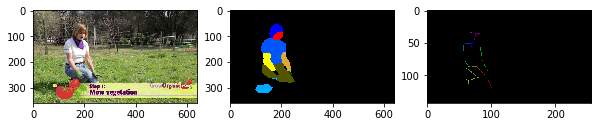

valid or not (y/n)y
589
tensor([137,  42,  16, 138,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


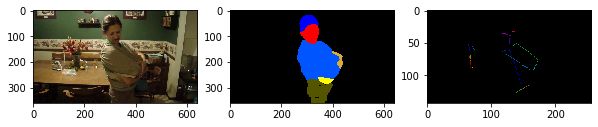

valid or not (y/n)n
590
tensor([167, 168, 169, 170, 171,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


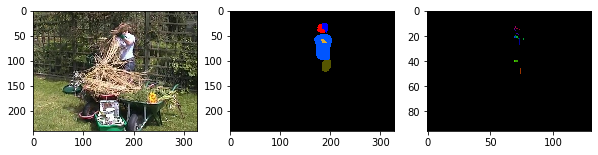

valid or not (y/n)n
591
tensor([214, 436, 134,   5,   6, 740,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


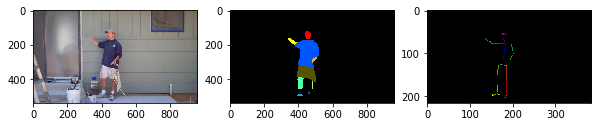

valid or not (y/n)y
592
tensor([11, 83,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0])


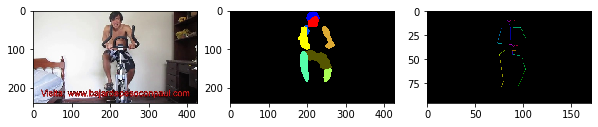

valid or not (y/n)y
593
tensor([52, 53,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0])


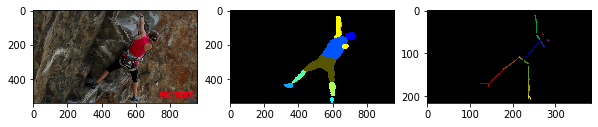

valid or not (y/n)y
594
tensor([292, 320, 485,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


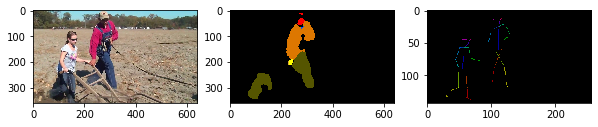

valid or not (y/n)n
595
tensor([504,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


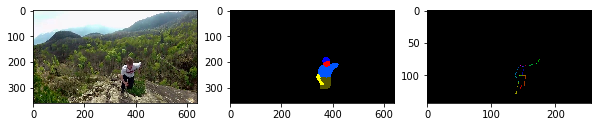

valid or not (y/n)y
596
tensor([8, 9, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0])


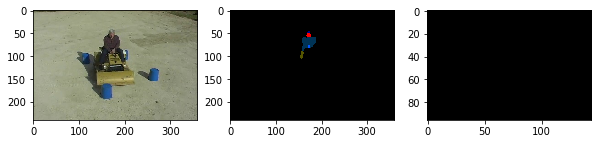

valid or not (y/n)n
597
tensor([107, 740,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


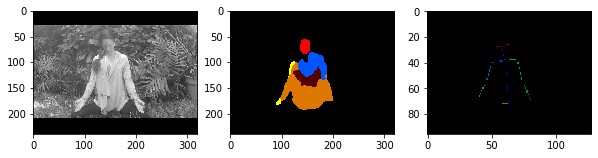

valid or not (y/n)n
598
tensor([35, 16, 36, 37,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0])


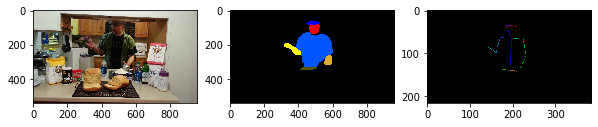

valid or not (y/n)y
599
tensor([372,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


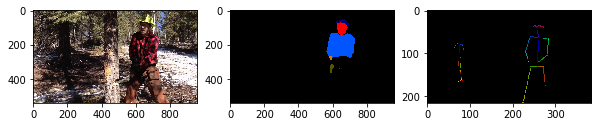

valid or not (y/n)n
600
tensor([292,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


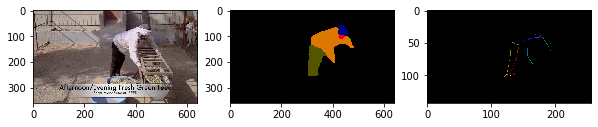

valid or not (y/n)y
601
tensor([126,  13,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


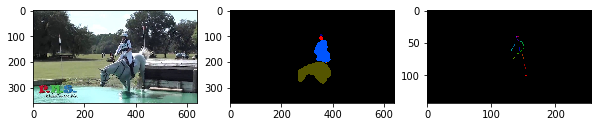

valid or not (y/n)y
602
tensor([249,  82, 250, 251, 252, 253,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


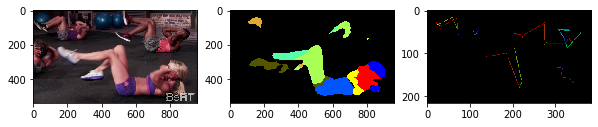

valid or not (y/n)n
603
tensor([64, 65,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0])


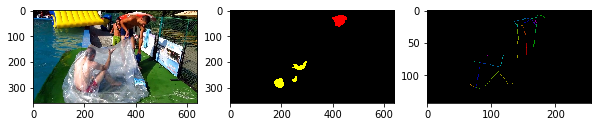

valid or not (y/n)n
604
tensor([256,  12,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


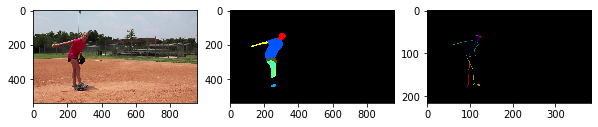

valid or not (y/n)y
605
tensor([114,  16, 115, 116, 740, 117, 118, 119, 120, 121, 122, 740, 123, 124,
        125,   0,   0])


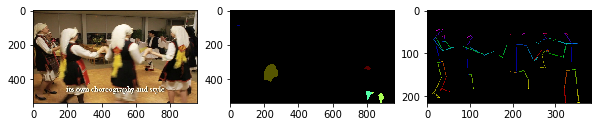

valid or not (y/n)n
606
tensor([505, 740, 485,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


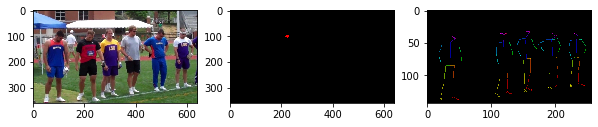

valid or not (y/n)n
607
tensor([133,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


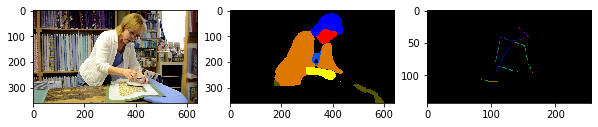

valid or not (y/n)y
608
tensor([132, 384, 385,  16, 348,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


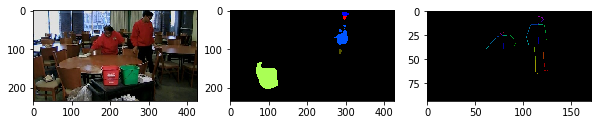

valid or not (y/n)n
609
tensor([404,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


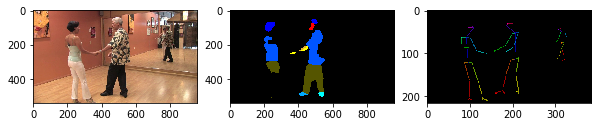

valid or not (y/n)n
610
tensor([72,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0])


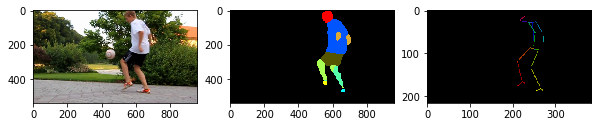

valid or not (y/n)y
611
tensor([740, 228, 165, 129, 740, 229, 740, 230, 231, 232, 740,   0,   0,   0,
          0,   0,   0])


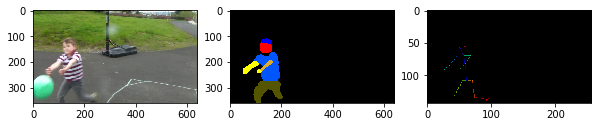

valid or not (y/n)y
612
tensor([279,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


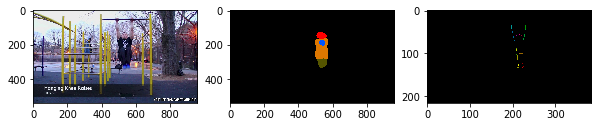

valid or not (y/n)n
613
tensor([214, 245,  59,  39,  40,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


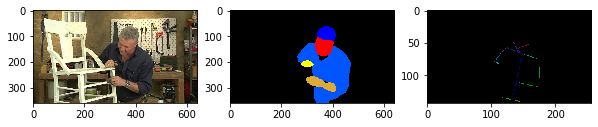

valid or not (y/n)y
614
tensor([279,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


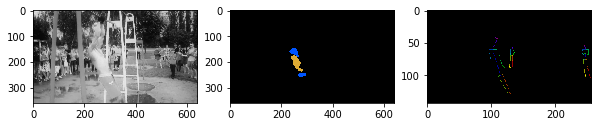

valid or not (y/n)n
615
tensor([110,  12,  39,  40,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


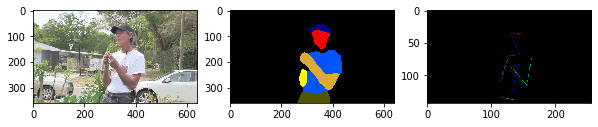

valid or not (y/n)y
616
tensor([740, 228, 165, 129, 740, 229, 740, 230, 231, 232, 740,   0,   0,   0,
          0,   0,   0])


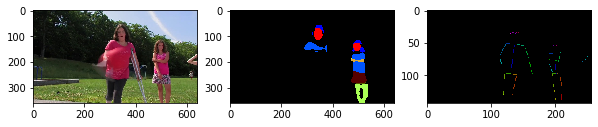

valid or not (y/n)n
617
tensor([110,  12,  39,  40,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


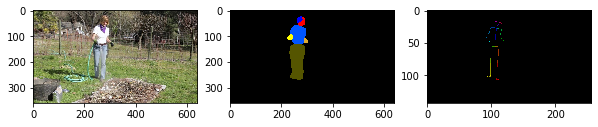

valid or not (y/n)n
618
tensor([343, 344,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


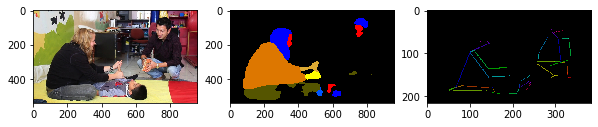

valid or not (y/n)n
619
tensor([175,  71,  12,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


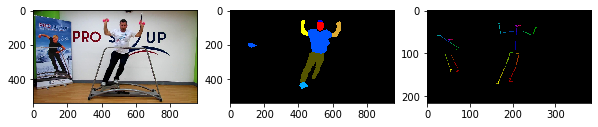

valid or not (y/n)n
620
tensor([740, 740, 374, 375, 740,  44,  12,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


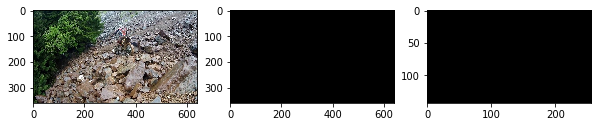

valid or not (y/n)n
621
tensor([ 42,  56,  14, 342,   2, 261, 506, 179,  16, 507, 508, 290,  40,   0,
          0,   0,   0])


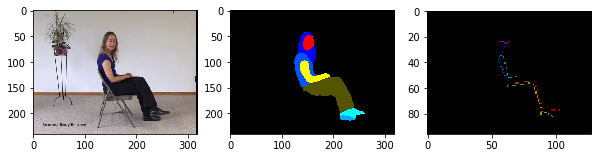

valid or not (y/n)y
622
tensor([256,  12,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


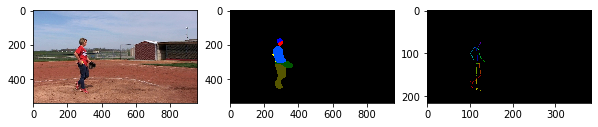

valid or not (y/n)y
623
tensor([73, 74, 12,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0])


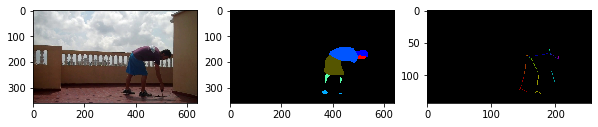

valid or not (y/n)y
624
tensor([376,  82, 377, 378,  82,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


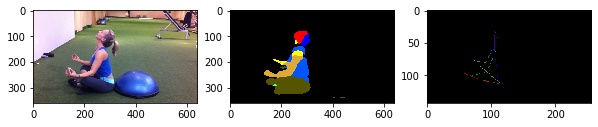

valid or not (y/n)y
625
tensor([443, 444,  21,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


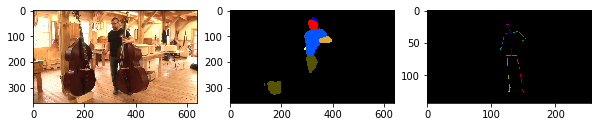

valid or not (y/n)n
626
tensor([346,  16, 347, 348,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


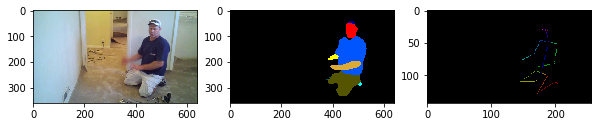

valid or not (y/n)y
627
tensor([11, 12,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0])


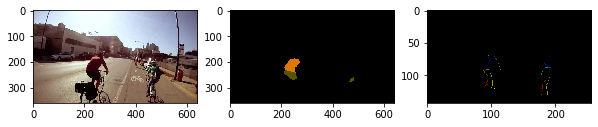

valid or not (y/n)n
628
tensor([327,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


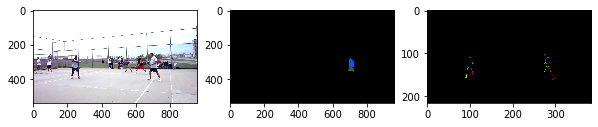

valid or not (y/n)n
629
tensor([103, 315,  16, 316, 317,  16,  59,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


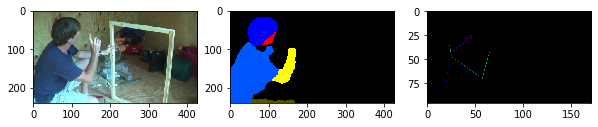

valid or not (y/n)y
630
tensor([136,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


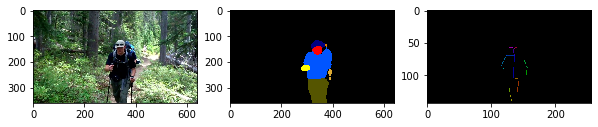

valid or not (y/n)y
631
tensor([ 24,  25,  26, 740,  27,  12,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


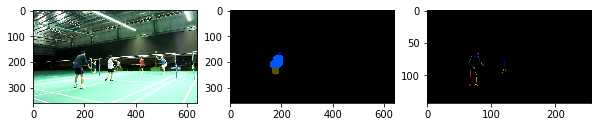

valid or not (y/n)n
632
tensor([55, 12,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0])


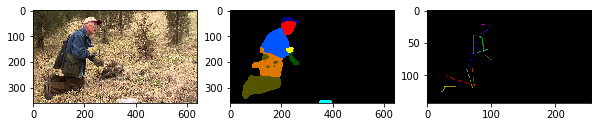

valid or not (y/n)y
633
tensor([48,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0])


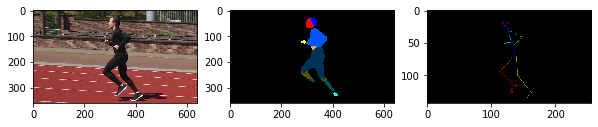

valid or not (y/n)y
634
tensor([509, 510,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


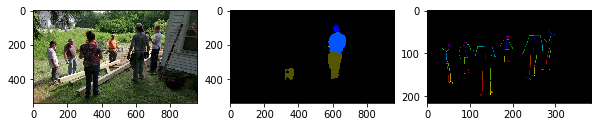

valid or not (y/n)n
635
tensor([188, 181, 189, 190,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


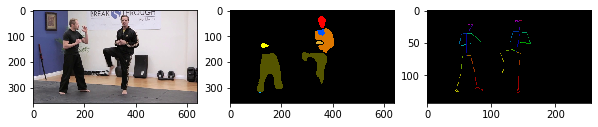

valid or not (y/n)n
636
tensor([346, 511,  52,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


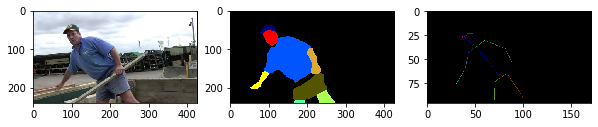

valid or not (y/n)y
637
tensor([467, 468,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


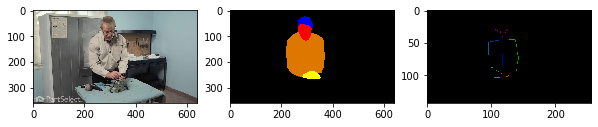

valid or not (y/n)y
638
tensor([129, 130, 131,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


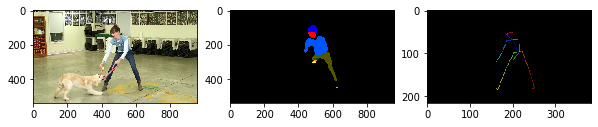

valid or not (y/n)y
639
tensor([512,  21, 290,  40,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


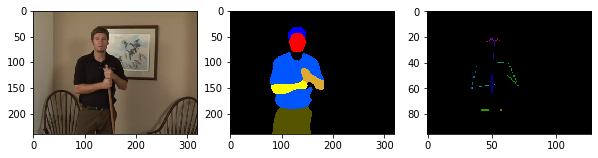

valid or not (y/n)y
640
tensor([429, 430, 130, 246, 431,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


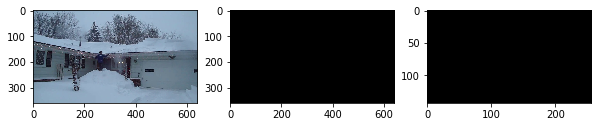

valid or not (y/n)n
641
tensor([105,  50,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


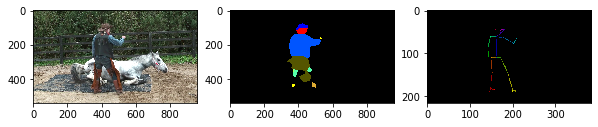

valid or not (y/n)y
642
tensor([126,  13,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


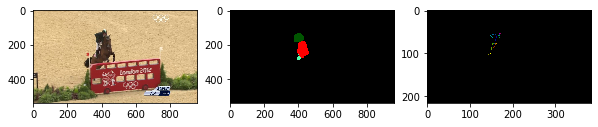

valid or not (y/n)n
643
tensor([128,  83,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


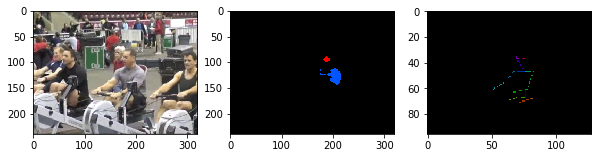

valid or not (y/n)n
644
tensor([197,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


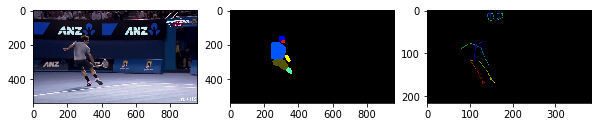

valid or not (y/n)y
645
tensor([128,  83,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


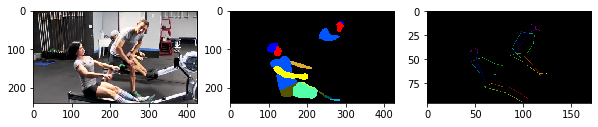

valid or not (y/n)n
646
tensor([175, 333,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


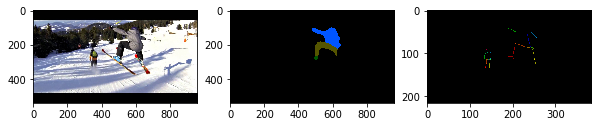

valid or not (y/n)n
647
tensor([513, 514,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


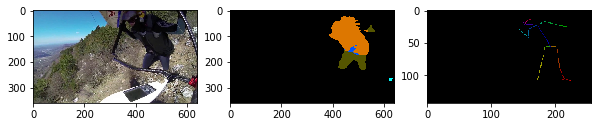

valid or not (y/n)n
648
tensor([194, 246, 247, 248,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


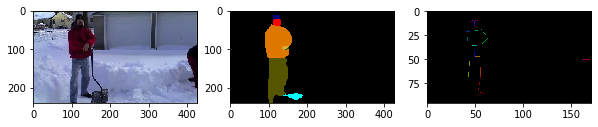

valid or not (y/n)n
649
tensor([399, 740,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


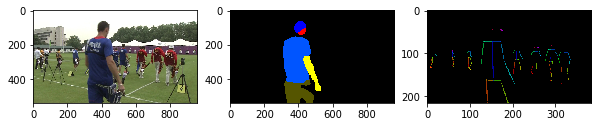

valid or not (y/n)n
650
tensor([159, 515, 516, 156,   5, 517, 740, 740,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


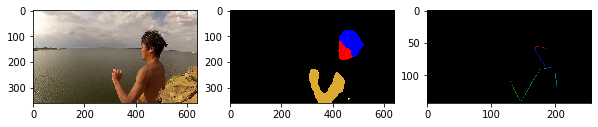

valid or not (y/n)y
651
tensor([518, 485,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


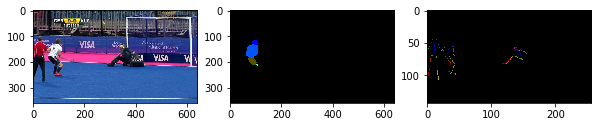

valid or not (y/n)n
652
tensor([ 65, 174, 740, 130, 175, 176,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


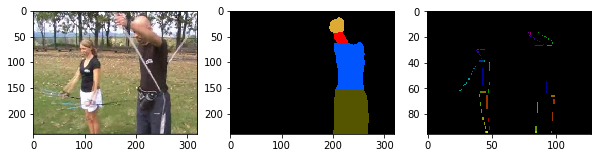

valid or not (y/n)n
653
tensor([  1, 127, 128,  49,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


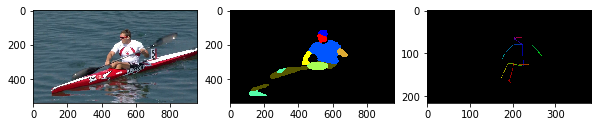

valid or not (y/n)y
654
tensor([323, 324,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


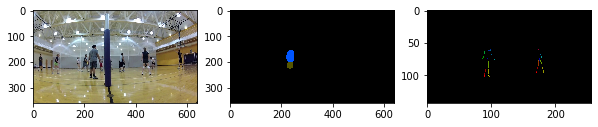

valid or not (y/n)n
655
tensor([203,   8, 207, 740, 208, 203, 405, 406, 259,  21,  65, 740,  62, 294,
        407,   0,   0])


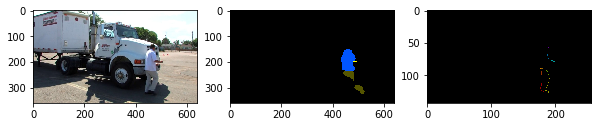

valid or not (y/n)n
656
tensor([256,  12,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


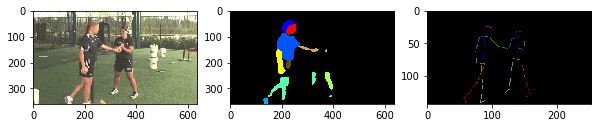

valid or not (y/n)n
657
tensor([304, 223, 283, 248, 305,   5,   6, 740,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


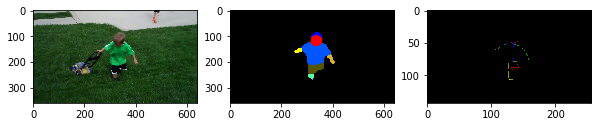

valid or not (y/n)y
658
tensor([103,  12,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


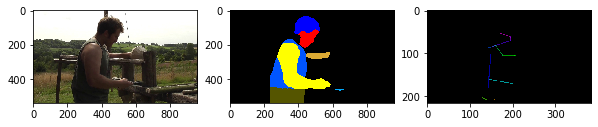

valid or not (y/n)y
659
tensor([214, 244, 245, 415, 416, 417,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


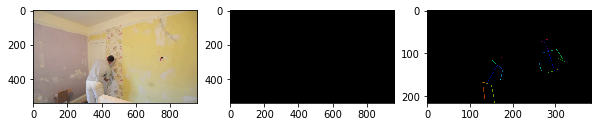

valid or not (y/n)n
660
tensor([204, 205,  16, 206,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


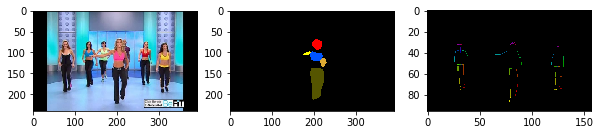

valid or not (y/n)n
661
tensor([372,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


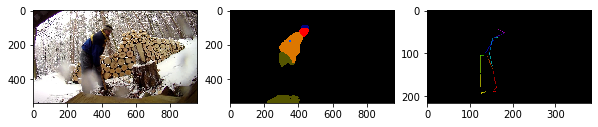

valid or not (y/n)n
662
tensor([304, 223, 283, 248, 305,   5,   6, 740,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


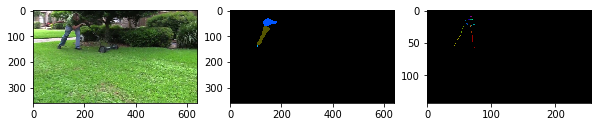

valid or not (y/n)n
663
tensor([65, 12,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0])


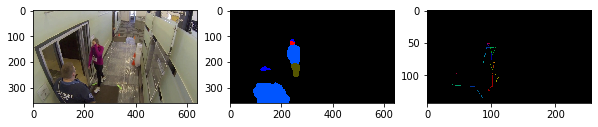

valid or not (y/n)n
664
tensor([240, 286, 287, 288,  16, 289, 290,  40,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


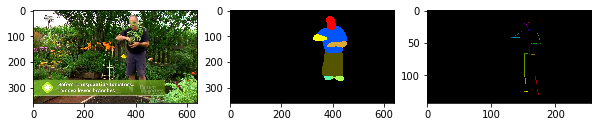

valid or not (y/n)y
665
tensor([198, 199,  65, 200, 201, 202, 203,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


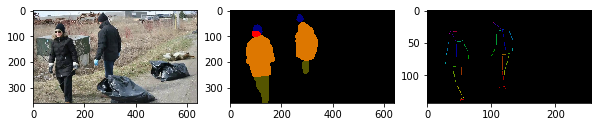

valid or not (y/n)n
666
tensor([188, 181, 189, 190,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


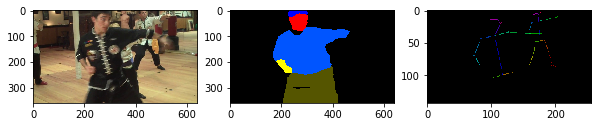

valid or not (y/n)n
667
tensor([97, 98, 42,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0])


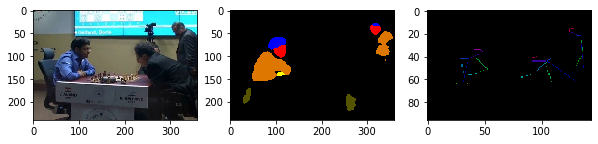

valid or not (y/n)n
668
tensor([126,  13,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


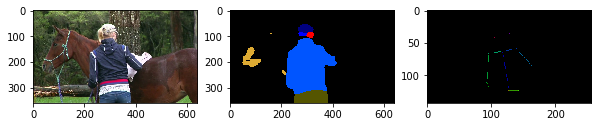

valid or not (y/n)y
669
tensor([210,  98,  12,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


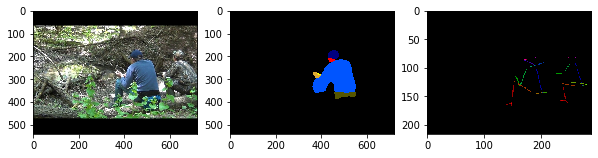

valid or not (y/n)n
670
tensor([55, 12,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0])


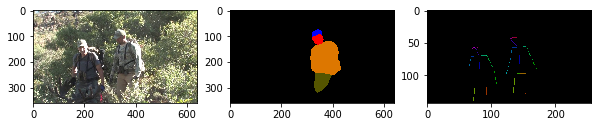

valid or not (y/n)n
671
tensor([354, 355, 214,  21,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


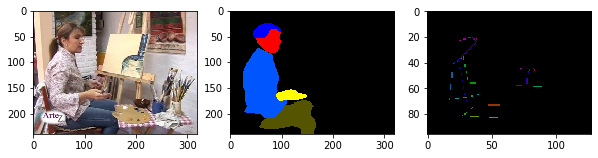

valid or not (y/n)y
672
tensor([279,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


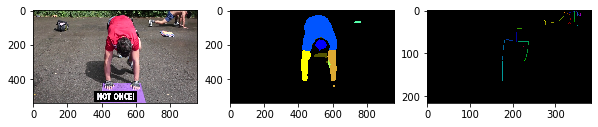

valid or not (y/n)n
673
tensor([ 11, 291,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


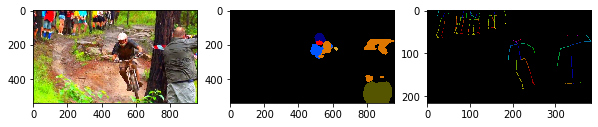

valid or not (y/n)n
674
tensor([175,  71,  12,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


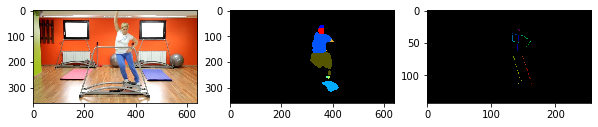

valid or not (y/n)y
675
tensor([159,  12,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


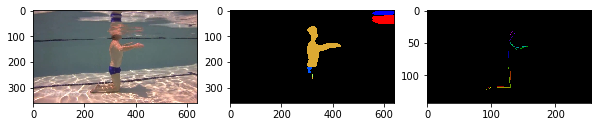

valid or not (y/n)y
676
tensor([265,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


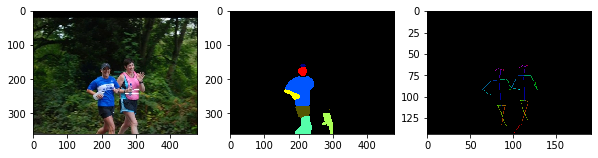

valid or not (y/n)n
677
tensor([292,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


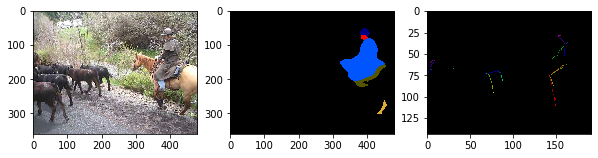

valid or not (y/n)n
678
tensor([ 21, 226,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


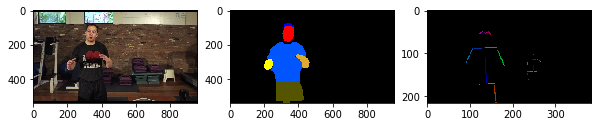

valid or not (y/n)n
679
tensor([ 29, 155, 328,  16, 329,  42,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


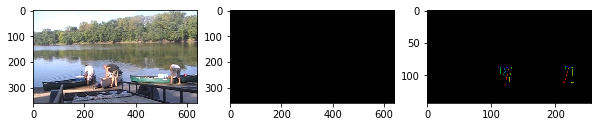

valid or not (y/n)n
680
tensor([126,  13,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


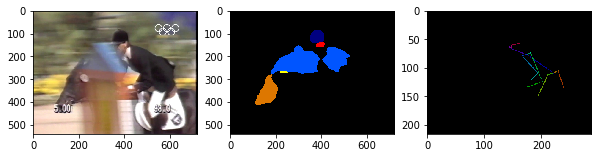

valid or not (y/n)n
681
tensor([  1,   2,   3,   4,   5,   6, 740,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


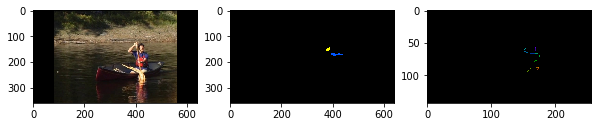

valid or not (y/n)n
682
tensor([46, 47,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0])


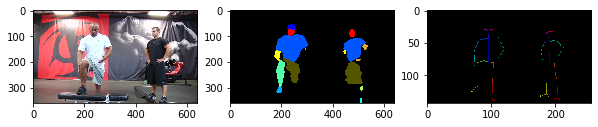

valid or not (y/n)n
683
tensor([ 21, 321, 322,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


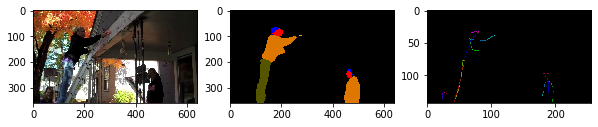

valid or not (y/n)n
684
tensor([95, 47,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0])


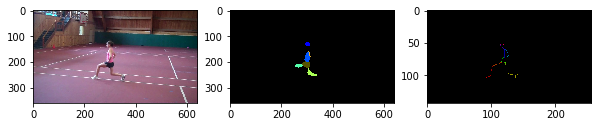

valid or not (y/n)y
685
tensor([519, 520, 740, 521, 740, 522, 740, 740, 519, 740, 740, 523, 740, 524,
          0,   0,   0])


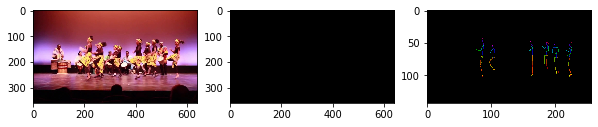

valid or not (y/n)n
686
tensor([292, 267, 373, 131,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


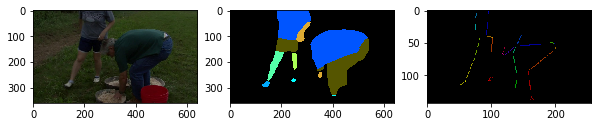

valid or not (y/n)n
687
tensor([159,  12,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


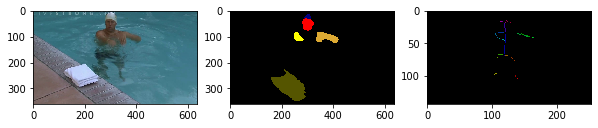

valid or not (y/n)n
688
tensor([129, 525, 526,  12,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


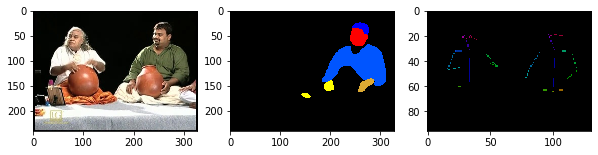

valid or not (y/n)n
689
tensor([35, 16, 36, 37,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0])


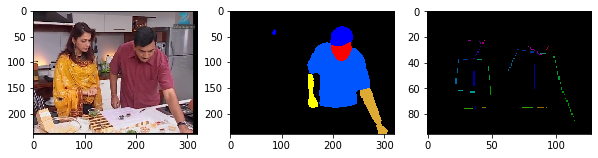

valid or not (y/n)n
690
tensor([527,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


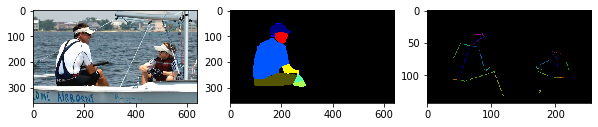

valid or not (y/n)n
691
tensor([126,  13,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


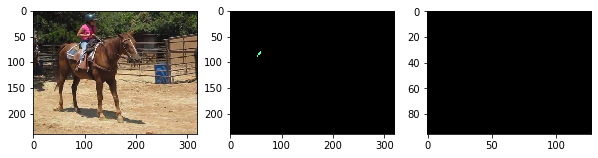

valid or not (y/n)n
692
tensor([ 11, 106,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


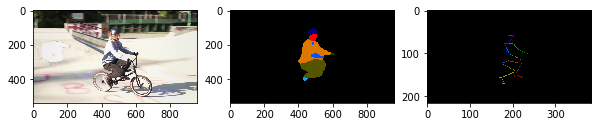

valid or not (y/n)y
693
tensor([292, 267, 528, 529,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


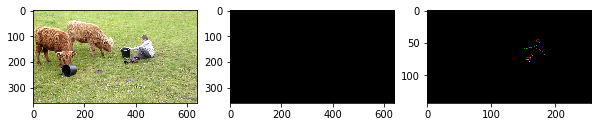

valid or not (y/n)n
694
tensor([ 24,  25,  26, 740,  27,  12,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


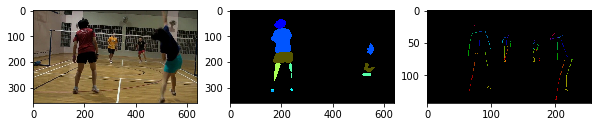

valid or not (y/n)n
695
tensor([18, 19, 16, 20,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0])


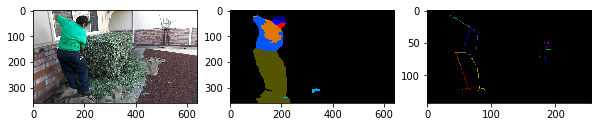

valid or not (y/n)n
696
tensor([198, 199,  65, 200, 201, 202, 203,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


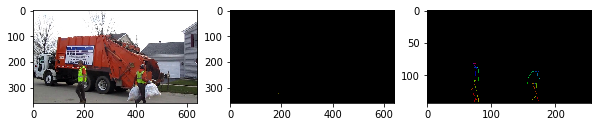

valid or not (y/n)n
697
tensor([147, 148, 149, 150, 151, 132, 152, 153, 154,   0,   0,   0,   0,   0,
          0,   0,   0])


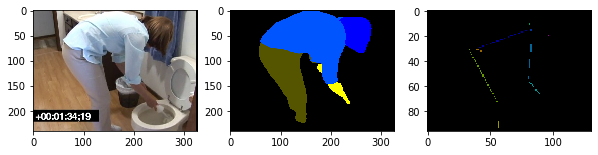

valid or not (y/n)y
698
tensor([530, 531,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


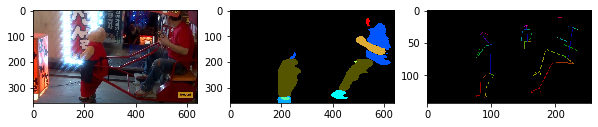

valid or not (y/n)n
699
tensor([397, 398,  21,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


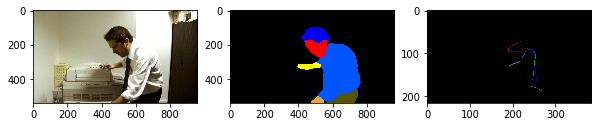

valid or not (y/n)y
700
tensor([740, 532, 116,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


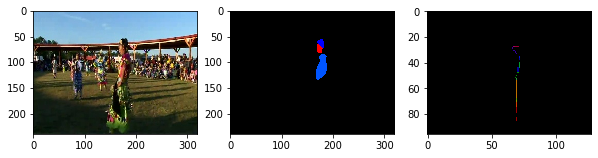

valid or not (y/n)n
701
tensor([279,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


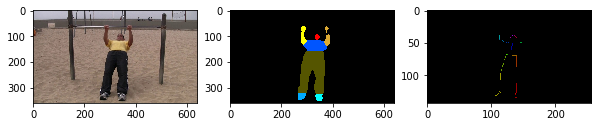

valid or not (y/n)y
702
tensor([105,  50,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


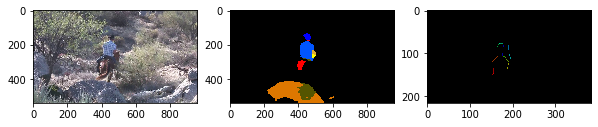

valid or not (y/n)n
703
tensor([279,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


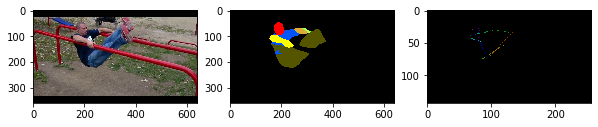

valid or not (y/n)y
704
tensor([147, 148, 149, 150, 151, 132, 152, 153, 154,   0,   0,   0,   0,   0,
          0,   0,   0])


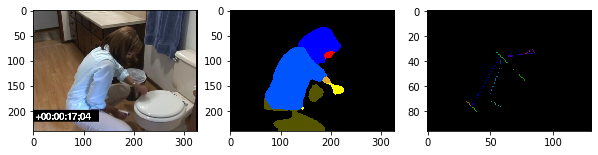

valid or not (y/n)y
705
tensor([52, 53,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0])


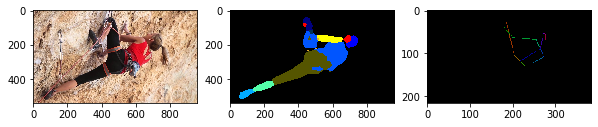

valid or not (y/n)y
706
tensor([138,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


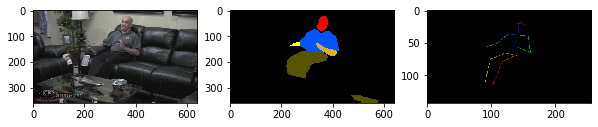

valid or not (y/n)y
707
tensor([533,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


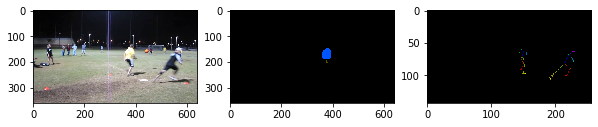

valid or not (y/n)n
708
tensor([292, 481, 240, 482, 483, 484,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


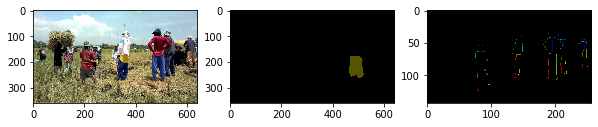

valid or not (y/n)n
709
tensor([263, 264,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


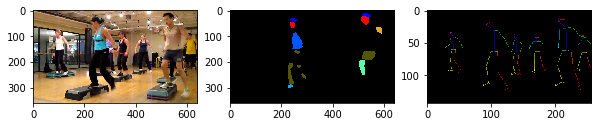

valid or not (y/n)n
710
tensor([100, 740, 101, 102,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


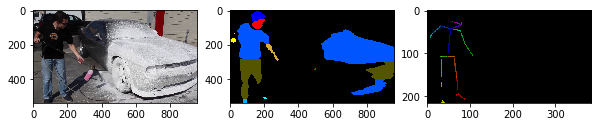

valid or not (y/n)n
711
tensor([ 24,  25,  26, 740,  27,  12,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


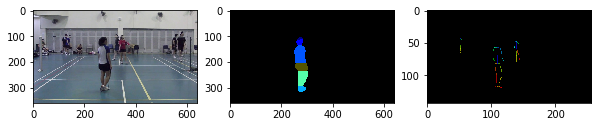

valid or not (y/n)n
712
tensor([337, 338,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


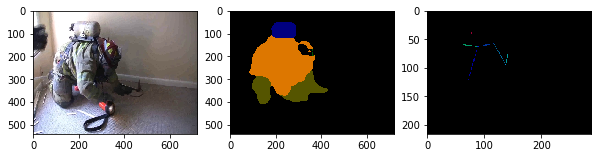

valid or not (y/n)n
713
tensor([307, 308, 309, 310,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


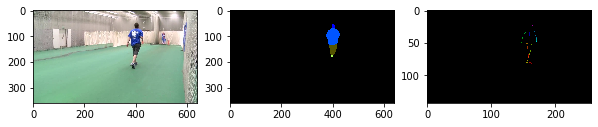

valid or not (y/n)y
714
tensor([ 65, 174, 740, 130, 175, 176,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


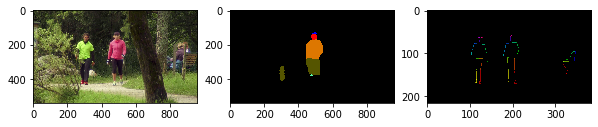

valid or not (y/n)n
715
tensor([52, 53,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0])


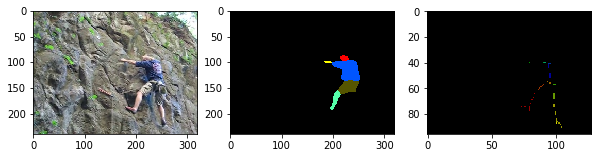

valid or not (y/n)y
716
tensor([99,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0])


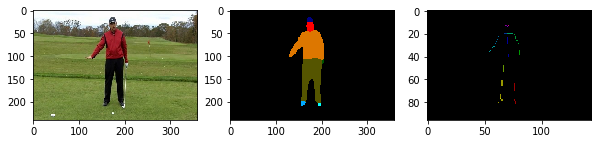

valid or not (y/n)y
717
tensor([361,  14, 362,  12,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


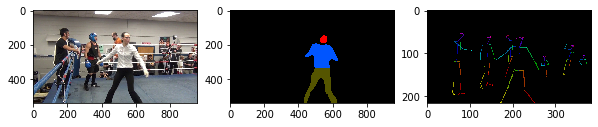

valid or not (y/n)n
718
tensor([346, 534,  16, 535, 467, 468,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


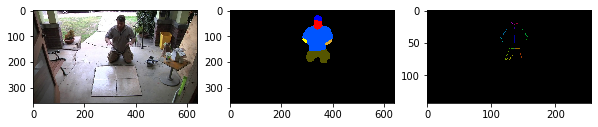

valid or not (y/n)y
719
tensor([175, 333,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


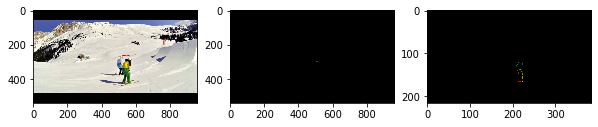

valid or not (y/n)n
720
tensor([227,  12,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


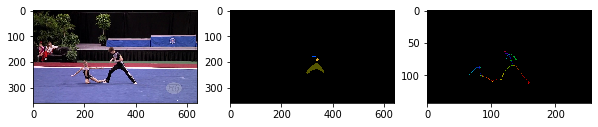

valid or not (y/n)n
721
tensor([476, 477, 478, 479,  65,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


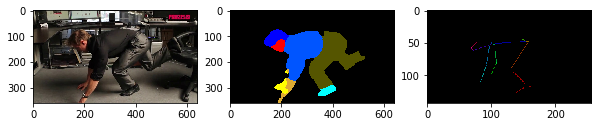

valid or not (y/n)y
722
tensor([238, 285,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


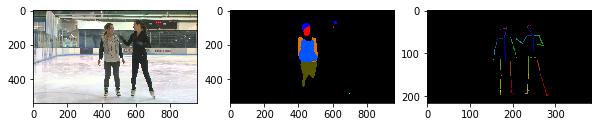

valid or not (y/n)n
723
tensor([ 42, 129, 349, 350, 351,  57,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


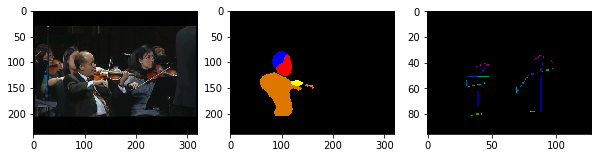

valid or not (y/n)n
724
tensor([367, 368, 369, 740, 370, 371,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


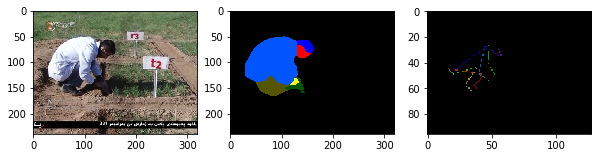

valid or not (y/n)n
725
tensor([ 29, 235,  34, 130, 236,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


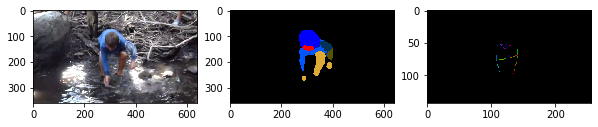

valid or not (y/n)y
726
tensor([476, 477, 478, 479,  65,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


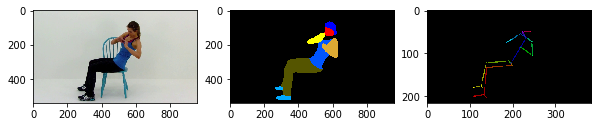

valid or not (y/n)y
727
tensor([192, 740, 237, 238, 239,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


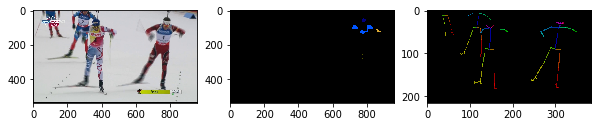

valid or not (y/n)n
728
tensor([95, 47,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0])


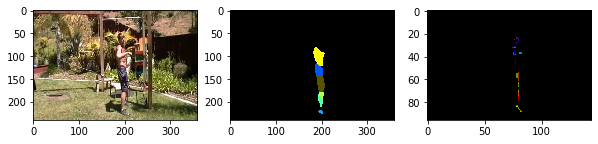

valid or not (y/n)n
729
tensor([502,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


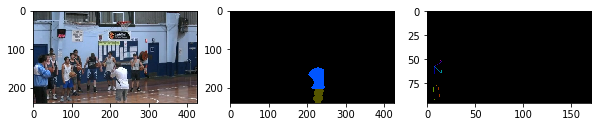

valid or not (y/n)n
730
tensor([  1, 536, 537, 481, 538, 481, 539, 261, 540,   0,   0,   0,   0,   0,
          0,   0,   0])


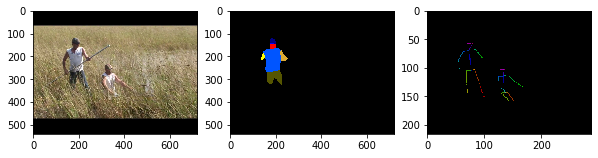

valid or not (y/n)n
731
tensor([128,  83,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


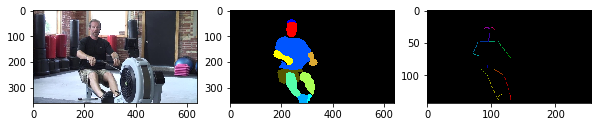

valid or not (y/n)y
732
tensor([  1,   2,   3,   4,   5,   6, 740,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


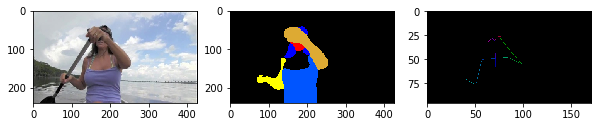

valid or not (y/n)y
733
tensor([107, 740,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


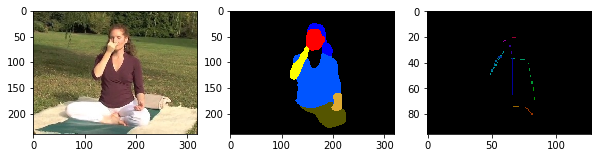

valid or not (y/n)y
734
tensor([ 58,  60,  61, 260,  62,  63,  16,  59,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


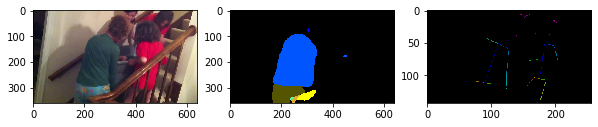

valid or not (y/n)n
735
tensor([421,  67, 130, 740, 108, 422,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


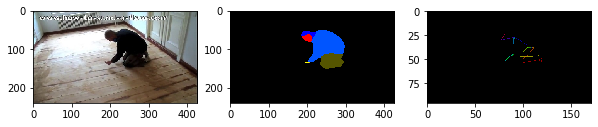

valid or not (y/n)y
736
tensor([443, 444,  21,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


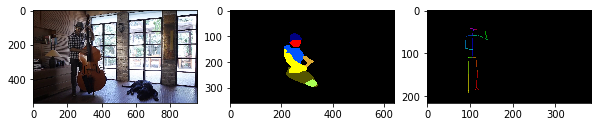

valid or not (y/n)n
737
tensor([740,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


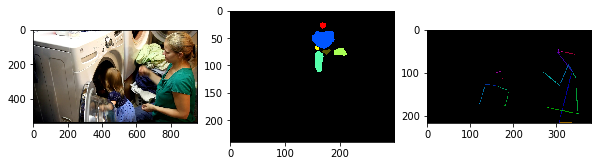

valid or not (y/n)n
738
tensor([ 21, 321, 322,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


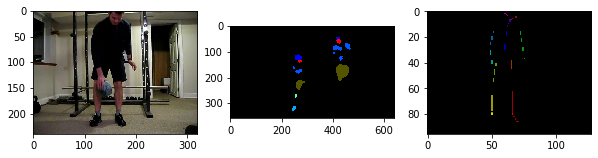

valid or not (y/n)n
739
tensor([105, 266, 267, 132, 268, 740, 740,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


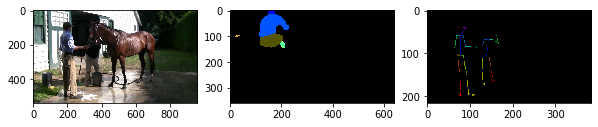

KeyboardInterrupt: 

In [29]:
with open('./data/valid.txt', 'w') as f:
    for i in range(pose_dataset.__len__()):
        print(i)
        sample = pose_dataset[i]
        print_sample(sample)
        decision = input('valid or not (y/n)')
        if decision == 'y':
            f.write('1\n')
        else:
            f.write('0\n')y

In [ ]:
### 736 开始有问题!!
### 2353!!!

tensor([126,  13,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0])


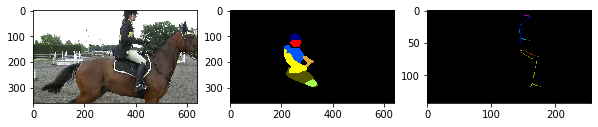

raw                       ./data/MPII_sample1/057983274.jpg
parsing       ./data/MPII_sample1_parsing/057983274_vis.png
pose        ./data/MPII_sample1_pose/057983274_rendered.png
annotate                                   horseback riding
Name: 2353, dtype: object

In [33]:
sample = pose_dataset[2353]
print_sample(sample)
path_list.iloc[2353]

In [35]:
#path_list.iloc[737]
# f = "./data/MPII_sample1/046373174.jpg"
# a = cv2.imread(f)
# import matplotlib.pyplot as plt
# plt.imshow(a)

In [56]:
###################### 修补data #########################
data_path = './data/MPII_sample1'
new_parsing_path = './data/MPII_sample1_parsing'
parsing_path = './data/MPII_sample1_parsing_Error'
#for i, file in enumerate(os.listdir(data_path))
os.listdir(data_path)
for i in tqdm(range(len(os.listdir(data_path))-2353)):
    new_id = os.listdir(data_path)[i].split('.')[0]
    id_ = os.listdir(data_path)[2353+i].split('.')[0]
    
    raw_img_path = data_path + '/'+os.listdir(data_path)[i]
    parsing_img_path = parsing_path + '/' + id_ + '_vis.png'
    
    parsing_img = cv2.imread(parsing_img_path)
    new_path = new_parsing_path + '/' + new_id + '_vis.png'
    cv2.imwrite(new_path, parsing_img)

#     print(i, raw_img_path, parsing_img_path)
#     raw_img, parsing_img = cv2.imread(raw_img_path), cv2.imread(parsing_img_path)
#     plt.imshow(raw_img)
#     plt.show()
#     plt.imshow(parsing_img)
#     plt.show()
#     print("....")
    


In [57]:
os.listdir(data_path)[(len(os.listdir(data_path))-2353):]
###################### 修补data #########################

['028131047.jpg',
 '085952771.jpg',
 '073177203.jpg',
 '046032698.jpg',
 '018081064.jpg',
 '007298271.jpg',
 '037246894.jpg',
 '027883758.jpg',
 '094569815.jpg',
 '020993183.jpg',
 '028703813.jpg',
 '045275065.jpg',
 '097822367.jpg',
 '086703150.jpg',
 '050511242.jpg',
 '060956082.jpg',
 '014727556.jpg',
 '069235431.jpg',
 '005688140.jpg',
 '071869539.jpg',
 '068723841.jpg',
 '035020193.jpg',
 '006656473.jpg',
 '062269324.jpg',
 '037728572.jpg',
 '097147707.jpg',
 '004028552.jpg',
 '012137192.jpg',
 '026021137.jpg',
 '022536243.jpg',
 '058800046.jpg',
 '052789638.jpg',
 '013369565.jpg',
 '026837837.jpg',
 '089674655.jpg',
 '031186386.jpg',
 '001770445.jpg',
 '074014939.jpg',
 '066101425.jpg',
 '028935241.jpg',
 '060645778.jpg',
 '034323017.jpg',
 '002047846.jpg',
 '049607548.jpg',
 '060962028.jpg',
 '023246904.jpg',
 '016860681.jpg',
 '072849393.jpg',
 '007971507.jpg',
 '014727381.jpg',
 '096256959.jpg',
 '019710604.jpg',
 '087066448.jpg',
 '084247213.jpg',
 '035234641.jpg',
 '00784924

In [8]:
# from shutil import copyfile

# from_ = '/home/yw3373/Desktop/coms_4995/LIP_JPPNet/output/parsing/val'
# to_ = '/home/yw3373/Desktop/coms_4995/human-pose-synthesis/data/tmp'

# for f in os.listdir(from_):
#     if f.endswith('_vis.png'):
#         copyfile(from_+'/'+f, to_+'/'+f)

In [38]:
ys = []
with open('./data/valid.txt', 'r') as f:
    for line in f:
        ys.append(int(line.strip()))
ys = np.array(ys)

In [54]:
raw, parsing, pose, annotate = [],[],[],[]
for i in range(len(ys)):
    if ys[i]:
        raw.append(path_list.iloc[i]['raw'])
        parsing.append(path_list.iloc[i]['parsing'])
        pose.append(path_list.iloc[i]['pose'])
        annotate.append(path_list.iloc[i]['annotate'])
data_list = pd.DataFrame.from_dict({''})

canoeing, on camping trip (Taylor Code 270)


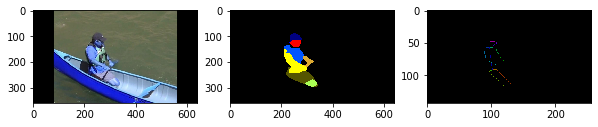

bicycling, general


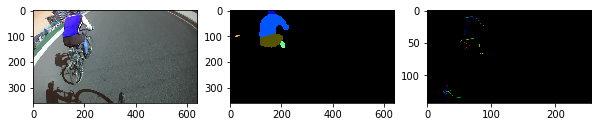

basketball


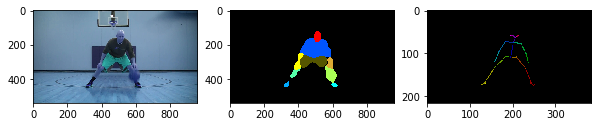

riding in a bus or train


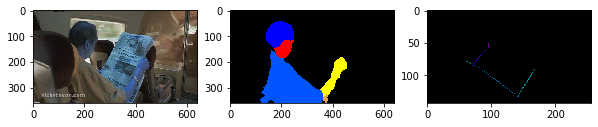

trimming shrubs or trees


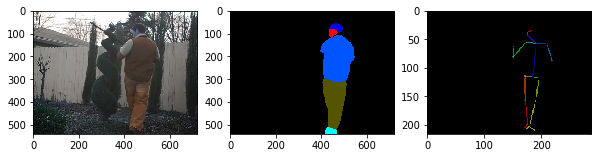

windsurfing


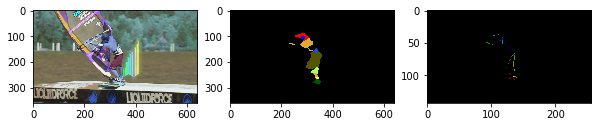

fishing, dip net, setting net and retrieving fish, general


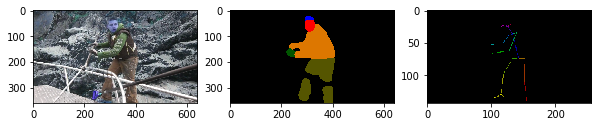

cooking or food preparation


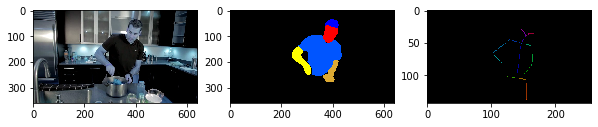

vacuuming, general, moderate effort


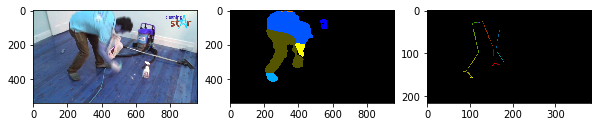

touringtravelingvacation involving riding in a vehicle


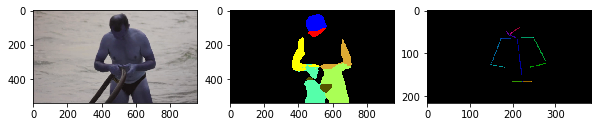

flute, sitting


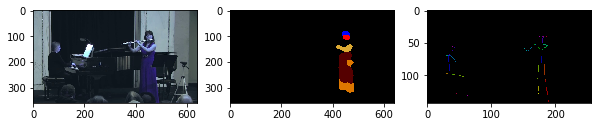

circuit training


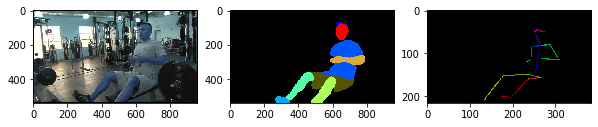

badminton, competitive (Taylor Code 450)


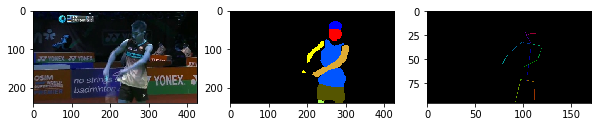

bicycling, racing and road


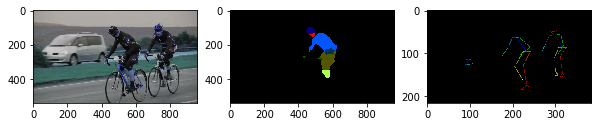

slimnastics, jazzercise


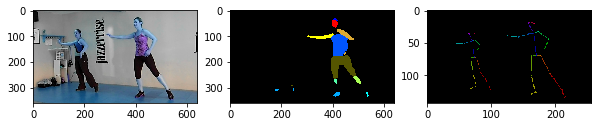

hunting, general


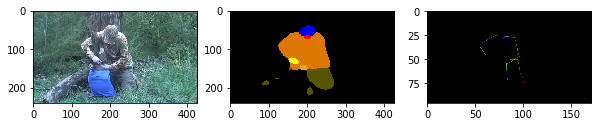

standing, talking in church


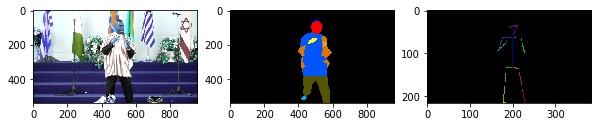

polishing floors, standing, walking slowly, using electric polishing machine


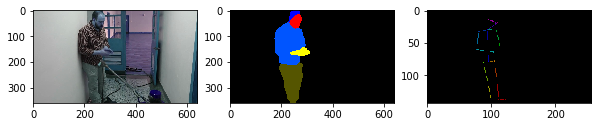

soccer


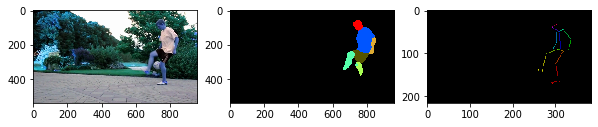

rope skipping, general


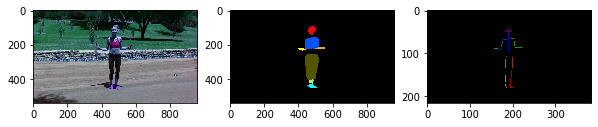

upper body exercise, stationary bicycle - Airdyne (arms only) 40 rpm, moderate


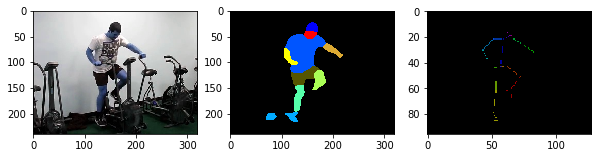

tai chi, qi gong, general


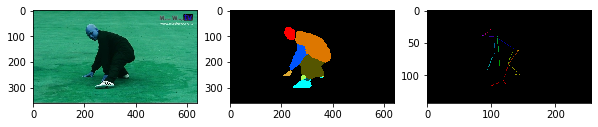

resistance training


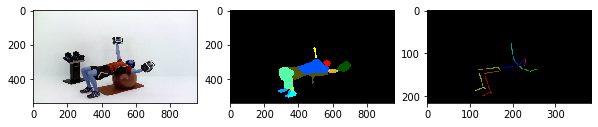

eating, sitting


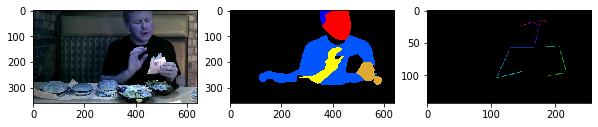

golf


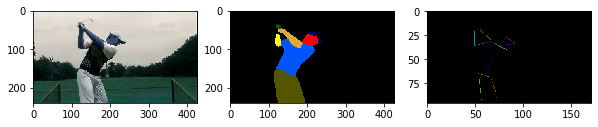

washing and waxing car


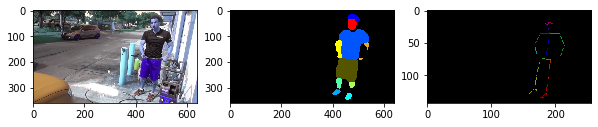

horse racing


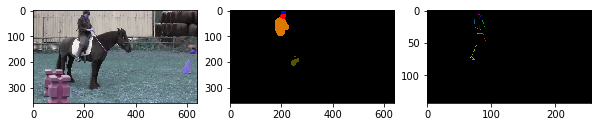

yoga, Power


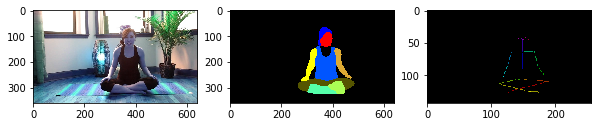

stair climbing, using or climbing up ladder (Taylor Code 030)


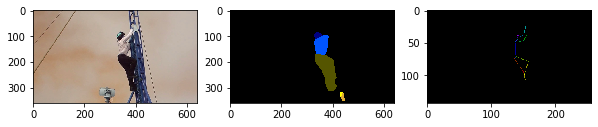

ethnic or cultural dancing (e.g., Greek, Middle Eastern, hula, salsa, merengue, bamba y plena, flame


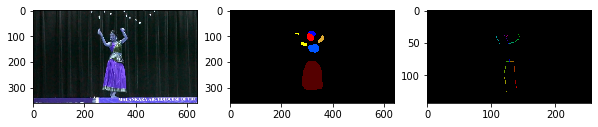

playing with animals


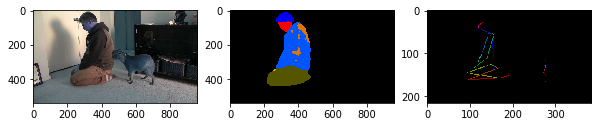

canoeing, on camping trip (Taylor Code 270)


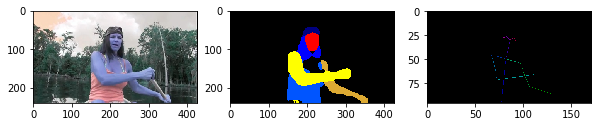

cleaning, general


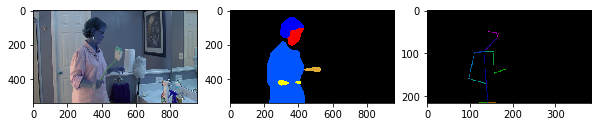

tailoring


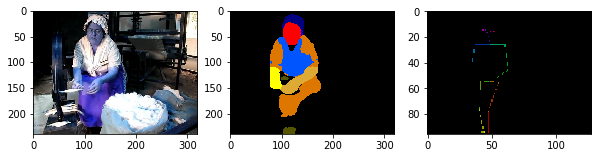

home repair, general


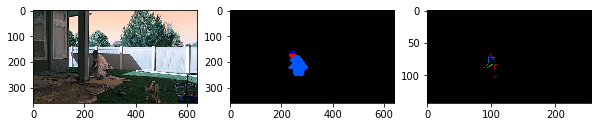

backpacking


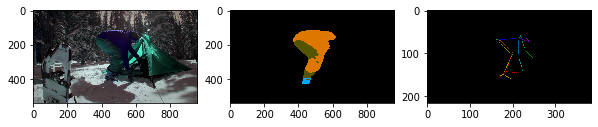

fishing in stream, in waders (Taylor Code 670)


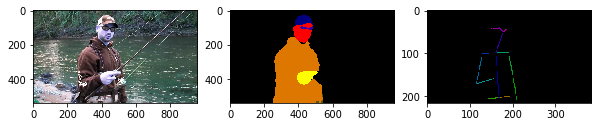

resistance training


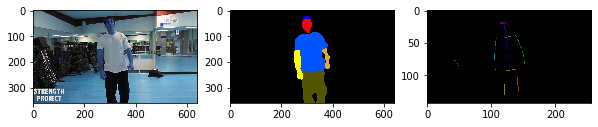

polishing floors, standing, walking slowly, using electric polishing machine


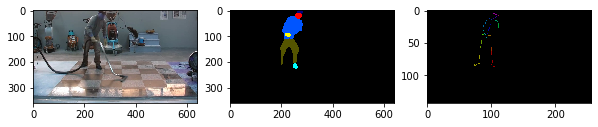

bicycling, racing and road


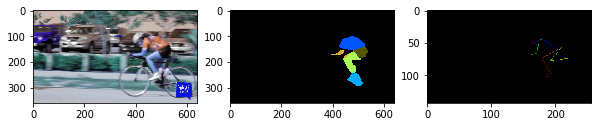

massage therapist, standing


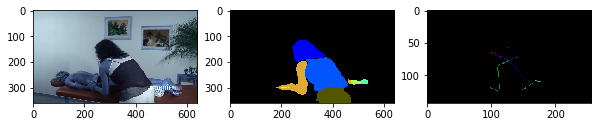

rowing, stationary


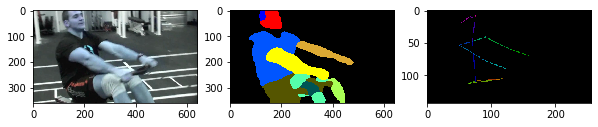

chambermaid, hotel housekeeper, making bed, cleaning bathroom, pushing cart


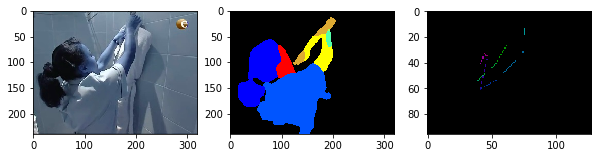

fishing from river bank


KeyboardInterrupt: 

In [66]:
## Check current data_list.csv是否有错
df = pd.read_csv('./data/data_list.csv')
for i in range(df.shape[0]):
    instance = df.iloc[i]
    sample = {'raw': cv2.imread(instance['raw']), 'parsing': cv2.imread(instance['parsing']), 'pose': cv2.imread(instance['pose']), 'annotate': instance['annotate']}
    print_sample(sample)

In [365]:
crop_size = 256
train_transform = transforms.Compose([
        transforms.ToPILImage(),
        transforms.CenterCrop(crop_size),
        transforms.ToTensor()]
)

cnn = models.resnet34(pretrained=True)

### Pick Images

In [366]:
xs_pose = []
xs_parsing = []
for i in tqdm(range(len(ys))):
    sample = pose_dataset[i]
    pose_transformed = train_transform(sample['pose'])
    pose_transformed = pose_transformed.reshape(1, 3, crop_size, crop_size)
    parsing_transformed = train_transform(sample['parsing'])
    parsing_transformed = parsing_transformed.reshape(1, 3, crop_size, crop_size)
    
    v_pose, v_parsing = cnn(pose_transformed)[0], cnn(parsing_transformed)[0]
    x_pose, x_parsing = v_pose.detach().numpy(), v_parsing.detach().numpy()
    xs_pose.append(x_pose)
    xs_parsing.append(x_parsing)

In [367]:
# split_idx = int(0.8 * len(ys))
# x_train_pose, y_train_pose = np.array(xs_pose[:split_idx]), np.array(ys[:split_idx])
# x_test_pose, y_test_pose = np.array(xs_pose[split_idx:]), np.array(ys[split_idx:])
# x_train.shape, x_test.shape

# x_train, y_train = np.array(xs_parsing[:split_idx]), np.array(ys[:split_idx])
# x_test, y_test = np.array(xs_parsing[split_idx:]), np.array(ys[split_idx:])
# x_train.shape, x_test.shape

x_pose, x_parsing, y = np.array(xs_pose), np.array(xs_parsing), np.array(ys)

In [368]:
from sklearn.neural_network import MLPClassifier
# Pose Classifier
clf_pose = MLPClassifier(max_iter=1000)
clf_pose.fit(x_pose, y) 
pred = clf_pose.predict(x_pose)
print(np.mean(pred==y))

# Parsing Classifier
clf_parsing = MLPClassifier(max_iter=1000)
clf_parsing.fit(x_parsing, y)
pred = clf_parsing.predict(x_parsing)
print(np.mean(pred==y))

1.0
0.9801980198019802


In [356]:
len(ys)

101

In [373]:
with open('./data/valid.txt', 'w') as f:
    for i in tqdm(range(pose_dataset.__len__())):
#         if i > 10:
#             break
        sample = pose_dataset[i]
        pose_transformed = train_transform(sample['pose'])
        pose_transformed = pose_transformed.reshape(1, 3, crop_size, crop_size)
        parsing_transformed = train_transform(sample['parsing'])
        parsing_transformed = parsing_transformed.reshape(1, 3, crop_size, crop_size)
        v_pose, v_parsing = cnn(pose_transformed)[0], cnn(parsing_transformed)[0]
        x_pose, x_parsing = v_pose.detach().numpy(), v_parsing.detach().numpy()

        pred_pose = clf_pose.predict([x_pose])
        pred_parsing = clf_parsing.predict([x_parsing])
        #print_sample(sample)
        if pred_pose[0] and pred_parsing[0]:
            f.write('1\n')
        else:
            f.write('0\n')

In [ ]:
for i in tqdm(range(pose_dataset.__len__())):
    

In [139]:
class Rescale(object):
    def __init__(self, output_size):
        assert isinstance(output_size, (int, tuple))
        self.output_size = output_size

    def __call__(self, sample):
        image = sample['raw']#, sample['landmarks']

        h, w = image.shape[:2]
        if isinstance(self.output_size, int):
            if h > w:
                new_h, new_w = self.output_size * h / w, self.output_size
            else:
                new_h, new_w = self.output_size, self.output_size * w / h
        else:
            new_h, new_w = self.output_size

        new_h, new_w = int(new_h), int(new_w)

        img = transform.resize(image, (new_h, new_w))

        # h and w are swapped for landmarks because for images,
        # x and y axes are axis 1 and 0 respectively
        #landmarks = landmarks * [new_w / w, new_h / h]
        plt.imshow(img)
        plt.show()
        return img

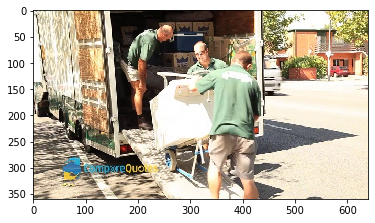

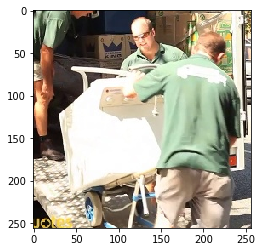

In [364]:
train_transform = transforms.Compose([
        transforms.ToPILImage(),
        transforms.CenterCrop(256)]
)
a = train_transform(sample['raw'])
plt.imshow(sample['raw'])
plt.show()
plt.imshow(a)
plt.show()